<img style="float: center;" src='https://github.com/STScI-MIRI/MRS-ExampleNB/raw/main/assets/banner1.png' alt="stsci_logo" width="1000px"/> 

# WASP-189b Transit Spectroscopy
-----

**Author**: Néstor Espinoza | AURA Assistant Astronomer | Mission Scientist for Exoplanet Science
<br>
**Last Updated**: March 21, 2024
<br>
**Pipeline Version**: 1.13.4

## Table of contents
1. [Introduction](#intro)<br>
   1.1 [Purpose of this Notebook](#purpose)<br>
   1.2 [Data & Context of the Observations](#data)<br>
2. [Downloading & Quick Looks at JWST TSO data](#download)<br>
   2.1 [Downloading TSO data from MAST](#mast)<br>
   2.2 [Quicklook, pt. I: Target Acquisition](#ta)<br>
   2.3 [Quicklook, pt. II: `datamodels` & TSO Science Data Products](#science)<br>
4. [A TSO tour through the `Detector1` stage](#detector1)<br>
   3.1 [Checking data quality flags](#dqflags)<br>
   3.2 [Identifying saturated pixels](#saturation)<br>
   3.3 [Removing detector-level effects: the `superbias` and `refpix` steps](#refpix)<br>
   3.4 [Linearity corrections](#linearity)<br>
   3.5 [Removing the dark current](#darkcurrent)<br>
   3.6 [Handling 1/f noise at the group-level](#1overf)<br>
   3.7 [Detecting "jumps" on up-the-ramp sampling](#jump)<br>
   3.8 [Fitting ramps with the `ramp_fit` step](#rampfit)<br>
6. [Final words](#final-words)<br>

---

1.<font color='white'>-</font>Introduction <a class="anchor" id="intro"></a>
------------------

### 1.1<font color='white'>-</font>Purpose of this Notebook<a class="anchor" id="purpose"></a> ###

In this Notebook, we aim to perform an exploration of Time Series Observations (TSO) products, focusing in particular on products obtained by [GTO program 1177: "MIRI observations of transiting exoplanets" (PI: Greene)](https://www.stsci.edu/jwst/science-execution/program-information?id=1177). The dataset used in this particular notebook will be the one that aimed at obtaining an eclipse of the exoplanet TRAPPIST-1b to detect the emission from the planet as is lost when it passes behind the star. We will start from the "raw" forms of data products that can be downloaded from MAST. Then, we will learn how to download those products, as well as how to load them and make them interact with the JWST Calibration Pipeline to calibrate them. 

### 1.2<font color='white'>-</font>Data & Context of the Observations<a class="anchor" id="data"></a> ###

The input data for this Notebook are observations from GTO program 1177 of TRAPPIST-1b taken with MIRI in the F1500W filter, i.e., at 15 microns. Results from those observations were presented in [Greene et al. (2023)](https://ui.adsabs.harvard.edu/abs/2023Natur.618...39G/abstract), and consist of a series of images taken to track the flux of TRAPPIST-1~b as the eclipse happen. This is a 377-integration, 14-groups dataset.

To get started, let's load some libraries that we will use in the following notebook:

In [1]:
# Need to set these enviromental variables for this notebook to work properly:
%set_env CRDS_PATH $HOME/crds_cache
%set_env CRDS_SERVER_URL https://jwst-crds.stsci.edu

# Import standard python libraries:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('ticks')

from matplotlib import cbook, cm
from matplotlib.colors import LightSource

# Some signal processing libraries. First, useful for cross-correlation:
from scipy import signal

# Import a median filter:
from scipy.ndimage import median_filter, gaussian_filter

# Interpolation tool:
from scipy.interpolate import interp1d, splev, splrep, SmoothBivariateSpline, RectBivariateSpline

# Import lomb-scargle:
from astropy.timeseries import LombScargle

# Import copy
from copy import copy, deepcopy

# Import Observations from astroquery.mast to perform data downloads:
from astroquery.mast import Observations
from astropy.convolution import convolve_fft

# Import some JWST Calibration pipieline libraries we will use to load and calibrate our data:
import jwst
from jwst import datamodels
from jwst.pipeline import calwebb_detector1

# Import JWST data reduction software
import pastasoss
import transitspectroscopy as ts
import juliet

# Useful libraries:
import ray
import spelunker

env: CRDS_PATH=$HOME/crds_cache
env: CRDS_SERVER_URL=https://jwst-crds.stsci.edu


Check pipeline version we will be using:

In [2]:
jwst.__version__

'1.13.4'

<div class="alert alert-block alert-info"> <b>Notes on the validity of this notebook</b>: It is important to realize that this notebook, as it is, is likely to be quickly outdated as new algorithms and fixes are implemented into the JWST Calibration pipeline, as well as new methodologies and studies update our knowledge of optimally calibrating JWST data products. An up-to-date list of known JWST pipeline issues (some of which we touch on this notebook) can be found on the <a href="https://jwst-docs.stsci.edu/jwst-calibration-pipeline-caveats/known-issues-with-jwst-data-products">Known Issues with the JWST Data Products</a> JDox page. In doubt, or for any questions, please contact <a href="https://jwst-docs.stsci.edu/jwst-help-desk">the JWST Helpdesk</a>!

2.<font color='white'>-</font>Downloading & Quick Looks at JWST TSO data <a class="anchor" id="download"></a>
------------------

The very first step when it comes to analyzing a JWST dataset is to download that data and perform some quick looks so we know the data quality is acceptable to begin with. Here, we will download the `uncal` products, which are one of the "raw"-est forms of dataproducts users can download from MAST. We will perform our data download from MAST using `astroquery.mast` and then use the JWST Calibration pipeline to read and have quicklooks at this data. Let's begin!

### 2.1<font color='white'>-</font>Downloading TSO data from MAST<a class="anchor" id="mast"></a> ###

To download JWST data from MAST, we will use the `Observations` function from the `astroquery.mast` library. To do this, we need to indicate the properties of the dataset of interest. For this we need to figure out what instrument, filter, program ID _and_ target was obseved. Options for JWST TSO instruments are `NIRISS/SOSS`, `NIRSPEC/SLIT`, `NIRCAM/GRISM`, `MIRI/SLITLESS`, `MIRI/IMAGE`, `NIRSPEC/SLIT`, etc. Here, we search for `MIRI/IMAGE`, and the `F1500W` filter, which corresponds to the dataset we want. We define the proposal ID (`1177`) and the name of the target, `TRAPPIST-1B`:

In [3]:
download = False
visit = '001'

token = 'c3c40f2430df4565a6aff2867822a7cd'
Observations.login(token=token)
observation = Observations.query_criteria(instrument_name = 'NIRISS/SOSS', 
                                          proposal_id = '3279')#, 
                                          #obs_id = 'jw02113'+visit+'*')

2024-03-21 23:17:51,612 - stpipe - INFO - MAST API token accepted, welcome Nestor Espinoza


INFO: MAST API token accepted, welcome Nestor Espinoza [astroquery.mast.auth]


Let's see:

In [4]:
observation

intentType,obs_collection,provenance_name,instrument_name,project,filters,wavelength_region,target_name,target_classification,obs_id,s_ra,s_dec,dataproduct_type,proposal_pi,calib_level,t_min,t_max,t_exptime,em_min,em_max,obs_title,t_obs_release,proposal_id,proposal_type,sequence_number,s_region,jpegURL,dataURL,dataRights,mtFlag,srcDen,obsid,objID
str7,str4,str7,str11,str4,str13,str8,str9,str25,str36,float64,float64,str5,str17,int64,float64,float64,float64,float64,float64,str77,float64,str4,str2,int64,str115,str63,str68,str6,bool,float64,str9,str9
science,JWST,CALJWST,NIRISS/SOSS,JWST,CLEAR;GR700XD,Infrared,HD-133112,Star; A stars; Exoplanets,jw03279001001_04101_00001-seg001_nis,225.68661024259688,-3.031543374924059,image,"Hoeijmakers, Jens",2,60374.98051877315,60375.41647784722,32958.506,600.0,2800.0,Calibrating NIRISS order 3 for very bright time-series observations with JWST,60375.49806716,3279,GO,--,POLYGON 225.696729712 -2.996766139 225.690941526 -3.034386268 225.68232361 -3.033023418 225.688102873 -2.995400874,mast:JWST/product/jw03279001001_04101_00001-seg001_nis_ramp.jpg,mast:JWST/product/jw03279001001_04101_00001-seg001_nis_rateints.fits,PUBLIC,False,nan,212637101,394545950
science,JWST,CALJWST,NIRISS/SOSS,JWST,CLEAR;GR700XD,Infrared,HD-133112,Star; A stars; Exoplanets,jw03279001001_04101_00001-seg002_nis,225.68661024259688,-3.031543374924059,image,"Hoeijmakers, Jens",2,60374.98051877315,60375.41647784722,32958.506,600.0,2800.0,Calibrating NIRISS order 3 for very bright time-series observations with JWST,60375.49249998,3279,GO,--,POLYGON 225.696729712 -2.996766139 225.690941526 -3.034386268 225.68232361 -3.033023418 225.688102873 -2.995400874,mast:JWST/product/jw03279001001_04101_00001-seg002_nis_ramp.jpg,mast:JWST/product/jw03279001001_04101_00001-seg002_nis_rateints.fits,PUBLIC,False,nan,212637110,394545955
science,JWST,CALJWST,NIRISS/SOSS,JWST,CLEAR;GR700XD,Infrared,HD-133112,Star; A stars; Exoplanets,jw03279001001_02101_00003-seg001_nis,225.68661025123365,-3.031543370864875,image,"Hoeijmakers, Jens",2,60374.97380998843,60374.97381420139,0.319,600.0,2800.0,Calibrating NIRISS order 3 for very bright time-series observations with JWST,60375.47434032,3279,GO,--,POLYGON 225.687052845 -3.032203264 225.68589627 -3.032020185 225.686074332 -3.030873721 225.687231 -3.031056805,mast:JWST/product/jw03279001001_02101_00003-seg001_nis_cal.jpg,mast:JWST/product/jw03279001001_02101_00003-seg001_nis_cal.fits,PUBLIC,False,nan,212637105,394545958
science,JWST,CALJWST,NIRISS/SOSS,JWST,CLEAR;GR700XD,Infrared,HD-133112,Star; A stars; Exoplanets,jw03279001001_04101_00001-seg005_nis,225.68661024259688,-3.031543374924059,image,"Hoeijmakers, Jens",2,60374.98051877315,60375.41647784722,32958.506,600.0,2800.0,Calibrating NIRISS order 3 for very bright time-series observations with JWST,60375.49313661,3279,GO,--,POLYGON 225.696729712 -2.996766139 225.690941526 -3.034386268 225.68232361 -3.033023418 225.688102873 -2.995400874,mast:JWST/product/jw03279001001_04101_00001-seg005_nis_ramp.jpg,mast:JWST/product/jw03279001001_04101_00001-seg005_nis_rateints.fits,PUBLIC,False,nan,212637107,394545964
science,JWST,CALJWST,NIRISS/SOSS,JWST,CLEAR;GR700XD,Infrared,HD-133112,Star; A stars; Exoplanets,jw03279001001_02101_00004-seg001_nis,225.68661025104137,-3.0315433709552453,image,"Hoeijmakers, Jens",2,60374.97881221065,60374.97881642361,0.319,600.0,2800.0,Calibrating NIRISS order 3 for very bright time-series observations with JWST,60375.47437504,3279,GO,--,POLYGON 225.687147937 -3.032220594 225.685991362 -3.032037516 225.686169424 -3.030891052 225.687326092 -3.031074135,mast:JWST/product/jw03279001001_02101_00004-seg001_nis_cal.jpg,mast:JWST/product/jw03279001001_02101_00004-seg001_nis_cal.fits,PUBLIC,False,nan,212637078,394545967
science,JWST,CALJWST,NIRISS/SOSS,JWST,CLEAR;GR700XD,Infrared,HD-133112,Star; A stars; Exoplanets,jw03279001001_02101_00001-seg001_nis,225.68661025129975,-3.031543370833815,image,"Hoeijmakers, Jens",2,60374.97209072917,60374.9720

Next-up, we actually define what data products we want. We want the science, `uncal` products:

In [5]:
# Get data products:
data_products = Observations.get_product_list(observation)

# Filter them to get ramps; only for the first observation defined by t_min:
uncals = Observations.filter_products(data_products, 
                                      productType = 'SCIENCE', 
                                      productSubGroupDescription = 'UNCAL')

Let's check these observations out:

In [6]:
uncals

obsID,obs_collection,dataproduct_type,obs_id,description,type,dataURI,productType,productGroupDescription,productSubGroupDescription,productDocumentationURL,project,prvversion,proposal_id,productFilename,size,parent_obsid,dataRights,calib_level
str9,str4,str5,str36,str64,str1,str70,str9,str28,str8,str1,str7,str6,str4,str52,int64,str9,str6,int64
212637078,JWST,image,jw03279001001_02101_00004-seg001_nis,exposure (L1b): Uncalibrated 4D exposure data,S,mast:JWST/product/jw03279001001_02101_00004-seg001_nis_uncal.fits,SCIENCE,Minimum Recommended Products,UNCAL,--,CALJWST,--,3279,jw03279001001_02101_00004-seg001_nis_uncal.fits,109440,212637078,PUBLIC,1
212637079,JWST,image,jw03279001001_02101_00002-seg001_nis,exposure (L1b): Uncalibrated 4D exposure data,S,mast:JWST/product/jw03279001001_02101_00002-seg001_nis_uncal.fits,SCIENCE,Minimum Recommended Products,UNCAL,--,CALJWST,--,3279,jw03279001001_02101_00002-seg001_nis_uncal.fits,120960,212637079,PUBLIC,1
212637101,JWST,image,jw03279001001_04101_00001-seg001_nis,exposure (L1b): Uncalibrated 4D exposure data,S,mast:JWST/product/jw03279001001_04101_00001-seg001_nis_uncal.fits,SCIENCE,Minimum Recommended Products,UNCAL,--,CALJWST,--,3279,jw03279001001_04101_00001-seg001_nis_uncal.fits,1394683200,212637101,PUBLIC,1
212637105,JWST,image,jw03279001001_02101_00003-seg001_nis,exposure (L1b): Uncalibrated 4D exposure data,S,mast:JWST/product/jw03279001001_02101_00003-seg001_nis_uncal.fits,SCIENCE,Minimum Recommended Products,UNCAL,--,CALJWST,--,3279,jw03279001001_02101_00003-seg001_nis_uncal.fits,120960,212637105,PUBLIC,1
212637107,JWST,image,jw03279001001_04101_00001-seg005_nis,exposure (L1b): Uncalibrated 4D exposure data,S,mast:JWST/product/jw03279001001_04101_00001-seg005_nis_uncal.fits,SCIENCE,Minimum Recommended Products,UNCAL,--,CALJWST,--,3279,jw03279001001_04101_00001-seg005_nis_uncal.fits,712045440,212637107,PUBLIC,1
212637110,JWST,image,jw03279001001_04101_00001-seg002_nis,exposure (L1b): Uncalibrated 4D exposure data,S,mast:JWST/product/jw03279001001_04101_00001-seg002_nis_uncal.fits,SCIENCE,Minimum Recommended Products,UNCAL,--,CALJWST,--,3279,jw03279001001_04101_00001-seg002_nis_uncal.fits,1394683200,212637110,PUBLIC,1
212637113,JWST,image,jw03279001001_02101_00001-seg001_nis,exposure (L1b): Uncalibrated 4D exposure data,S,mast:JWST/product/jw03279001001_02101_00001-seg001_nis_uncal.fits,SCIENCE,Minimum Recommended Products,UNCAL,--,CALJWST,--,3279,jw03279001001_02101_00001-seg001_nis_uncal.fits,120960,212637113,PUBLIC,1
212637116,JWST,image,jw03279001001_04101_00001-seg004_nis,exposure (L1b): Uncalibrated 4D exposure data,S,mast:JWST/product/jw03279001001_04101_00001-seg004_nis_uncal.fits,SCIENCE,Minimum Recommended Products,UNCAL,--,CALJWST,--,3279,jw03279001001_04101_00001-seg004_nis_uncal.fits,1394683200,212637116,PUBLIC,1
212637118,JWST,image,jw03279001001_04101_00001-seg003_nis,exposure (L1b): Uncalibrated 4D exposure data,S,mast:JWST/product/jw03279001001_04101_00001-seg003_nis_uncal.fits,SCIENCE,Minimum Recommended Products,UNCAL,--,CALJWST,--,3279,jw03279001001_04101_00001-seg003_nis_uncal.fits,1394683200,212637118,PUBLIC,1


Note how there are 9 data products, and they are "segmented" --- i.e., the filenames read "seg001", "seg002", etc. This is done in the ground to facilitate the processing of the data. 

Let's download all the data:

In [7]:
if download:
    
    Observations.download_products(uncals)

Great, all downloads are complete! Let's perform some quick looks at those datasets, which we can do right away without the need to actually calibrate our data products.

### 2.2<font color='white'>-</font>Quicklook: `datamodels` & TSO Science Data Products<a class="anchor" id="science"></a> ###

Three sets of data:

- `jw03279001001_02101_00001*`,
- `jw03279001001_02101_00002*`,
- `jw03279001001_02101_00003*`,
- `jw03279001001_02101_00004*`, are the TA images.
- `jw03279001001_04101_00001*` are actual science TSO data.

First, load the TSO data:

In [8]:
uncal = []
nsegments = 5
for i in range(1,nsegments+1):

    folder_name = 'jw03279001001_04101_00001-seg00'+str(i)+'_nis'
    filename = folder_name+'_uncal.fits'
    uncal.append( datamodels.RampModel('mastDownload/JWST/'+folder_name+'/'+filename) )

Now TAs:

In [9]:
tas = []
for i in range(1,4+1):
    
    folder_name = 'jw03279001001_02101_0000'+str(i)+'-seg001_nis'
    filename = folder_name+'_uncal.fits'
    tas.append( datamodels.RampModel('mastDownload/JWST/'+folder_name+'/'+filename) )

Let's get pupil wheel position frame:

In [10]:
uncal[0].meta.instrument.pupil_position

245.68821700005125

In [11]:
uncal[0].search('date')

root (AsdfObject)
└─meta (dict)
  ├─date (str): 2024-03-06T10:47:09.958
  └─observation (dict)
    ├─date (str): 2024-03-05
    ├─date_beg (str): 2024-03-05T23:31:56.822
    └─date_end (str): 2024-03-06T09:59:43.686

Note how we just added a word similar to what we were looking for, and then this function will take a look to find where similar words are located in the `datamodels` attribute tree. From the above, it seems this information is in `meta.observation.date`. Let's check:

In [12]:
uncal[0].meta.observation.date_beg

'2024-03-05T23:31:56.822'

It works! Note `date_beg` is the one we would be typically interested in checking (which was when the observartions happened, including the hour). Let's try another one. Suppose we wanted to know the name of the PI of this program. Again, the key word here is `pi` so let's insert that one in the `search` function:

In [13]:
uncal[0].search('pi')

root (AsdfObject)
├─meta (dict)
│ ├─instrument (dict)
│ │ ├─pupil (str): GR700XD
│ │ └─pupil_position (float): 245.68821700005125
│ └─program (dict)
│   └─pi_name (str): Hoeijmakers, Jens
└─pixeldq (ndarray): shape=(256, 2048), dtype=uint32

So this exists under `meta.program.pi_name`:

In [14]:
uncal[0].meta.program.pi_name

'Hoeijmakers, Jens'

Very handy! Let's now take a quick look at the science data. This data lives in the `data` attribute of our `datamodels`. Let's see how this looks like for the first segment of the data by exploring the dimensions of the array:

In [15]:
uncal[0].data.shape

(190, 7, 256, 2048)

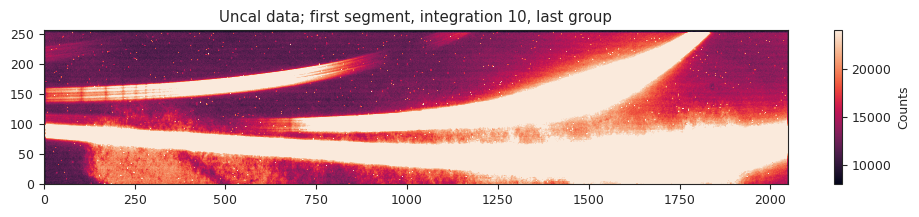

In [16]:
plt.figure(figsize=(12, 2))

plt.title('Uncal data; first segment, integration 10, last group')
im = plt.imshow(uncal[0].data[10, -1, :, :], aspect = 'auto', origin = 'lower')
im.set_clim(8000,24000)

plt.colorbar(label = 'Counts')

Nice. How do the TA frames look:

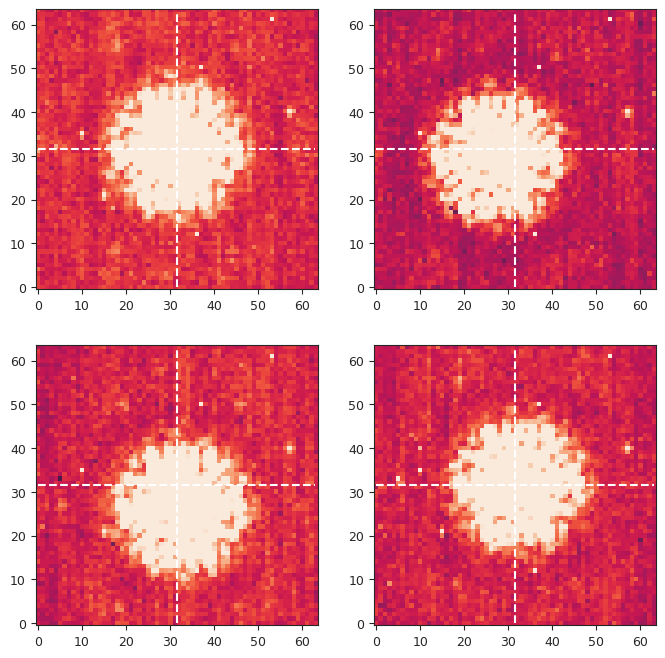

In [17]:
plt.figure(figsize=(8,8))

plt.subplot(221)
lmf = tas[0].data[0, -1, :, :] - tas[0].data[0, 0, :, :]
nr_ta, nc_ta = lmf.shape

im = plt.imshow(lmf , aspect = 'auto', origin = 'lower', interpolation = None)

plt.plot([0,(nr_ta-1)], [(nr_ta-1)/2., (nr_ta-1)/2.], '--', color = 'white')
plt.plot([(nr_ta-1)/2., (nr_ta-1)/2.], [0,(nr_ta-1)], '--', color = 'white')

im.set_clim(-100, 100)

plt.subplot(222)
lmf = tas[1].data[0, -1, :, :] - tas[1].data[0, 0, :, :]
nr_ta, nc_ta = lmf.shape

im = plt.imshow(lmf , aspect = 'auto', origin = 'lower', interpolation = None)

plt.plot([0,(nr_ta-1)], [(nr_ta-1)/2., (nr_ta-1)/2.], '--', color = 'white')
plt.plot([(nr_ta-1)/2., (nr_ta-1)/2.], [0,(nr_ta-1)], '--', color = 'white')

im.set_clim(-100, 100)

plt.subplot(223)
lmf = tas[2].data[0, -1, :, :] - tas[2].data[0, 0, :, :]
nr_ta, nc_ta = lmf.shape

im = plt.imshow(lmf , aspect = 'auto', origin = 'lower', interpolation = None)

plt.plot([0,(nr_ta-1)], [(nr_ta-1)/2., (nr_ta-1)/2.], '--', color = 'white')
plt.plot([(nr_ta-1)/2., (nr_ta-1)/2.], [0,(nr_ta-1)], '--', color = 'white')

im.set_clim(-100, 100)

plt.subplot(224)
lmf = tas[3].data[0, -1, :, :] - tas[3].data[0, 0, :, :]
nr_ta, nc_ta = lmf.shape

im = plt.imshow(lmf , aspect = 'auto', origin = 'lower', interpolation = None)

plt.plot([0,(nr_ta-1)], [(nr_ta-1)/2., (nr_ta-1)/2.], '--', color = 'white')
plt.plot([(nr_ta-1)/2., (nr_ta-1)/2.], [0,(nr_ta-1)], '--', color = 'white')

im.set_clim(-100, 100)

In [18]:
tas[0].data.shape

(1, 7, 64, 64)

(-100.0, 100.0)

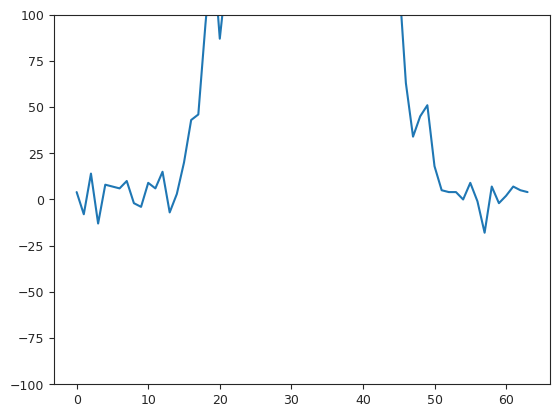

In [19]:
plt.plot(lmf[:,30])
plt.ylim(-100,100)

Let's write some useful overall functions: 

In [20]:
def count_dnu(dm):

    rows, columns = dm.data.shape[2], dm.data.shape[3]
    # Iterate through every row and column:
    counter = 0
    for row in range(rows):
        
        for column in range(columns):
    
            # Extract the bad pixel flag(s) for the current pixel at (row, column):
            bps = datamodels.dqflags.dqflags_to_mnemonics(dm.pixeldq[row, column], 
                                                          mnemonic_map = datamodels.dqflags.pixel)

            if 'DO_NOT_USE' in bps:

                counter += 1

    return counter

def calibrate(uncal_list):

    for i in range(len(uncal_list)):

        uncal_list[i] = calwebb_detector1.dq_init_step.DQInitStep.call(uncal_list[i])
        uncal_list[i] = calwebb_detector1.saturation_step.SaturationStep.call(uncal_list[i])
        uncal_list[i] = calwebb_detector1.superbias_step.SuperBiasStep.call(uncal_list[i])
        uncal_list[i] = calwebb_detector1.refpix_step.RefPixStep.call(uncal_list[i])
        uncal_list[i] = calwebb_detector1.linearity_step.LinearityStep.call(uncal_list[i])   
        uncal_list[i] = calwebb_detector1.dark_current_step.DarkCurrentStep.call(uncal_list[i])


Good. Now write tso jump detection:

In [21]:
def get_mad_sigma(x, median):
    """
    This function gets back the median absolute deviation (MAD)-based standard deviation:
    """
    
    mad = np.nanmedian( np.abs( x - median ) )
    return mad * 1.4826


def outlier_detector(x, nsigma = 10, window = 200, return_filter = False, use_median = False):
    """
    Given a uniformly sampled time-series `x`, this function substracts a median filter to it with a window `window`, 
    estimates the standard deviation of the residuals via an outlier-robust metric (the median-absolute-deviation-based 
    standard deviation) and identifies outliers in it, returning the indexes at which they are located


    Parameters
    ----------

    x : numpy.array
        Numpy array of a uniformly-spaced time-series.

    nsigma : float
        Number of sigmas used to identify outliers.

    window : int
        Window for the median filter

    return_filter : bool
        (Optional) If True, function returns the median filtered data

    Returns
    -------

    outlier_indexes : numpy.array
        Indexes in `x` at which outliers are located.

    """

    # First, get a median filter to get rid of the transit (or any astrophysical) event:
    if use_median:

        mf = np.nanmedian(x)

    else:

        mf = median_filter(x, window)
    
    residuals = (x - mf)
    
    # Now, with those zero-median residuals, estimate the median absolute deviation:
    sigma = get_mad_sigma( residuals, np.nanmedian(residuals) )
    
    # Now, find any datapoint 10-sigma away:
    idx = np.where( np.abs(residuals) > nsigma * sigma )[0]
    
    # Return location of the outliers:
    if not return_filter:

        return idx

    else:

        return idx, mf

def tso_jumpstep(tso_list, window, nsigma = 10, use_median = False):
    """ 
    This function performs the same functionality as the jump step on a *set* of JWST datamodels (from, e.g., segmented data), repurposed to 
    take advantage of the uniqueeness of TSOs; it however works with any multi-integration exposure. The assumptions are:

    1. You are locked on the same target in all the sets of exposures given to this function.
    2. Adding all exposures together, the number of integrations is > 1.
    2. The number of groups per integration is > 1.
    
    For every pixel, a group difference is calculated for every integration in the TSO between groups i+1 and i; this defines the time-series of this group-difference. 
    Then, a median filter with an input `window` is substracted from this time-series. This is expected to leave only noise on the time-series. 
    Outliers are detected on this group difference time-series, and those are identified as jumps. Those are then marked for group i+1 in the `groupdq` extension 
    with a value of 4 --- indicating a jump has been detected. This is repeated from group 1 to the second-to-last group (Ngroups - 1).

    Parameters
    ----------

    tso_list : list
        List of JWST datamodels for a given exposure (e.g., `tso_list = [datamodels.open(file1), datamodels.open(file2)]`). 
        Typically, these would be the segments of a TSO. The algorithm expects those to be ordered chronologically.

    window : int
        Window for the median filter. It is expected that the number of integrations >> window (a factor of window/nints ~ 1/20 or 1/50 works well for transits/eclipses/phase curves).

    nsigma (optional) : float
        Number of sigmas used to identify outliers.

    Returns
    -------

    output_tso_list : numpy.array
        Same as the `tso_list`, but with the `groupdq` updated to reflect the jump detection. Note this is a shallow copy of `tso_list`, so changing attributes of `tso_list` will also 
        change those of the output and viceversa.

    """

    # List that will save the shallow copies of the input TSO with the updated groupdq's:
    output_tso_list = []
    # Create list to save the number of integrations per segment:
    ips = []
    # Various bookeeping variables:
    input_nints = 0
    input_ngroups = tso_list[0].data.shape[1]
    nrows = tso_list[0].data.shape[2]
    ncolumns = tso_list[0].data.shape[3]

    for i in range( len(tso_list) ):

        # Shallow copy of input list:
        output_tso_list.append( copy(tso_list[i]) )
        # Modify groupdq attribute of the output_tso_list elements so its a deepcopy of the original --- so we can 
        # change it later if needed by our algorithm:
        output_tso_list[-1].groupdq = deepcopy(output_tso_list[-1].groupdq)

        input_nints += tso_list[i].data.shape[0]
        ips.append(tso_list[i].data.shape[0])

    # All right. Now, generate the difference image array:
    di = np.zeros([input_nints,
                   input_ngroups - 1,
                   nrows,
                   ncolumns
                  ])

    # We generate it by performing difference imaging on each element of the input list. For free we get the cummulative number 
    # of integrations to a given segment (will be useful in the next for loop):
    cis = []  # Cummulative number of integrations up to a given segment
    ci = 0    # Current integration counter
    for i in range( len(tso_list) ):

        for j in range(input_ngroups - 1):

            di[ci:ci+ips[i], j, :, :] = tso_list[i].data[:, j+1, :, :] - tso_list[i].data[:, j, :, :]

        ci += ips[i]
        cis.append(ci)
    
    # All right, now that we have the difference image, we perform outlier detection. This could be easily parallelized BTW:
    for i in range(nrows):
        
        for j in range(ncolumns):
            
            for k in range(input_ngroups - 1): 
               
                # Find outliers for pixel (i,j): 
                idx = outlier_detector(di[:, k, i, j], nsigma = nsigma, window = window, use_median = use_median)
                
                # If outliers are detected, iterate through them and add them to the corresponding groupdq in the output list:
                if len(idx) > 0:
                    
                    for outlier_index in idx:
                        
                        # For each detected outlier in the difference image, we need to map its location to a segment (and index 
                        # in that segment). We do that by searching segment by segment until the outlier_index surpasses the number 
                        # of cummulative integrations --- when it surpasses it, it means we found the segment:
                        for ii in range( len(output_tso_list) ):

                            index_difference = outlier_index - cis[ii]
                            #print('outlier_index:',outlier_index)
                            #print('cis:',cis)
                            #print('ii:',ii)


                            # If difference is less than zero, ii is the index of the segment for the outlier:
                            if index_difference < 0:

                                if ii == 0:

                                    output_tso_list[ii].groupdq[outlier_index, k+1, i, j] = 4
                                    break

                                else:

                                    output_tso_list[ii].groupdq[outlier_index - cis[ii-1], k+1, i, j] = 4
                                    break

    return output_tso_list

### 1<font color='white'>-</font>TSO analysis<a class="anchor" id="dqflags"></a>

Let's calibrate the TSOs: 

In [22]:
calibrate(uncal)

2024-03-21 23:21:35,509 - stpipe.DQInitStep - INFO - DQInitStep instance created.
2024-03-21 23:21:35,693 - stpipe.DQInitStep - INFO - Step DQInitStep running with args (<RampModel(190, 7, 256, 2048) from jw03279001001_04101_00001-seg001_nis_uncal.fits>,).
2024-03-21 23:21:35,695 - stpipe.DQInitStep - INFO - Step DQInitStep parameters are: {'pre_hooks': [], 'post_hooks': [], 'output_file': None, 'output_dir': None, 'output_ext': '.fits', 'output_use_model': False, 'output_use_index': True, 'save_results': False, 'skip': False, 'suffix': None, 'search_output_file': True, 'input_dir': ''}
2024-03-21 23:21:36,478 - stpipe.DQInitStep - INFO - Using MASK reference file $HOME/crds_cache/references/jwst/niriss/jwst_niriss_mask_0017.fits
2024-03-21 23:21:41,184 - stpipe.DQInitStep - INFO - Extracting mask subarray to match science data
2024-03-21 23:21:44,129 - stpipe.DQInitStep - INFO - Results used CRDS context: jwst_1215.pmap
2024-03-21 23:21:44,130 - stpipe.DQInitStep - INFO - Step DQInitS

Do all the uncals for the TSO jump because this is, indeed, a TSO:

In [23]:
tso_uncal = tso_jumpstep(uncal, 10, nsigma = 10)

Save:

In [24]:
nsegments = len(uncal)

if not os.path.exists('SOSS_tsojumpstep_seg00'+str(nsegments)+'.fits'):

    for i in range(nsegments):

        if i+1 > 9:
            thestring = '0'+str(i+1)
        else:
            thestring = '00'+str(i+1)
            
        # Save jump step MIRI products:
        tso_uncal[i].save('SOSS_tsojumpstep_seg'+thestring+'.fits')

else:

    tso_uncal = []

    for i in range(nsegments):

        if i+1 > 9:
            thestring = '0'+str(i+1)
        else:
            thestring = '00'+str(i+1)
            
        # Save jump step MIRI products:
        tso_uncal.append(datamodels.RampModel('SOSS_tsojumpstep_seg'+thestring+'.fits'))

Next, ramp fitting:

In [25]:
nsegments = len(tso_uncal)
ramps_soss = []

# Create output folder:
output_folder = 'tso_ramps'

if not os.path.exists(output_folder):

    os.mkdir(output_folder)

for i in range(nsegments):

    print('Working with segment ',i+1, 'out of', nsegments)
    
    if i+1 > 9:
        
        thestring = '0'+str(i+1)
        
    else:
        
        thestring = '00'+str(i+1)

    if not os.path.exists(output_folder+'/SOSS_tsojumpstep_seg'+thestring+'_1_rampfitstep.fits'):
        
        # Apply the rampfit step to NRS1:
        ramps_soss.append( calwebb_detector1.ramp_fit_step.RampFitStep.call(tso_uncal[i], 
                                                                            maximum_cores = 'quarter', 
                                                                            save_results=True,
                                                                            output_dir = output_folder)
                         )

    else:

        ramps_soss.append( [ datamodels.open(output_folder+'/SOSS_tsojumpstep_seg'+thestring+'_0_rampfitstep.fits'), 
                             datamodels.open(output_folder+'/SOSS_tsojumpstep_seg'+thestring+'_1_rampfitstep.fits')
                           ] 
                         )

2024-03-22 00:01:49,639 - stpipe.RampFitStep - INFO - RampFitStep instance created.
2024-03-22 00:01:49,896 - stpipe.RampFitStep - INFO - Step RampFitStep running with args (<RampModel(190, 7, 256, 2048) from SOSS_tsojumpstep_seg001.fits>,).


Working with segment  1 out of 5


2024-03-22 00:01:49,898 - stpipe.RampFitStep - INFO - Step RampFitStep parameters are: {'pre_hooks': [], 'post_hooks': [], 'output_file': None, 'output_dir': 'tso_ramps', 'output_ext': '.fits', 'output_use_model': False, 'output_use_index': True, 'save_results': True, 'skip': False, 'suffix': None, 'search_output_file': True, 'input_dir': '', 'int_name': '', 'save_opt': False, 'opt_name': '', 'suppress_one_group': True, 'maximum_cores': 'quarter'}
2024-03-22 00:01:49,953 - CRDS - INFO -  Fetching  $HOME/crds_cache/references/jwst/niriss/jwst_niriss_readnoise_0005.fits   16.8 M bytes  (1 / 1 files) (0 / 16.8 M bytes)
2024-03-22 00:01:50,902 - CRDS - INFO -  Fetching  $HOME/crds_cache/references/jwst/niriss/jwst_niriss_gain_0006.fits   16.8 M bytes  (1 / 1 files) (0 / 16.8 M bytes)
2024-03-22 00:01:51,644 - stpipe.RampFitStep - INFO - Using READNOISE reference file: $HOME/crds_cache/references/jwst/niriss/jwst_niriss_readnoise_0005.fits
2024-03-22 00:01:51,645 - stpipe.RampFitStep - INFO

Working with segment  2 out of 5


2024-03-22 00:06:47,248 - stpipe.RampFitStep - INFO - Step RampFitStep parameters are: {'pre_hooks': [], 'post_hooks': [], 'output_file': None, 'output_dir': 'tso_ramps', 'output_ext': '.fits', 'output_use_model': False, 'output_use_index': True, 'save_results': True, 'skip': False, 'suffix': None, 'search_output_file': True, 'input_dir': '', 'int_name': '', 'save_opt': False, 'opt_name': '', 'suppress_one_group': True, 'maximum_cores': 'quarter'}
2024-03-22 00:06:47,285 - stpipe.RampFitStep - INFO - Using READNOISE reference file: $HOME/crds_cache/references/jwst/niriss/jwst_niriss_readnoise_0005.fits
2024-03-22 00:06:47,286 - stpipe.RampFitStep - INFO - Using GAIN reference file: $HOME/crds_cache/references/jwst/niriss/jwst_niriss_gain_0006.fits
2024-03-22 00:06:47,354 - stpipe.RampFitStep - INFO - Extracting gain subarray to match science data
2024-03-22 00:06:47,356 - stpipe.RampFitStep - INFO - Extracting readnoise subarray to match science data
2024-03-22 00:06:47,357 - stpipe.Ra

Working with segment  3 out of 5


2024-03-22 00:12:09,260 - stpipe.RampFitStep - INFO - Step RampFitStep parameters are: {'pre_hooks': [], 'post_hooks': [], 'output_file': None, 'output_dir': 'tso_ramps', 'output_ext': '.fits', 'output_use_model': False, 'output_use_index': True, 'save_results': True, 'skip': False, 'suffix': None, 'search_output_file': True, 'input_dir': '', 'int_name': '', 'save_opt': False, 'opt_name': '', 'suppress_one_group': True, 'maximum_cores': 'quarter'}
2024-03-22 00:12:09,300 - stpipe.RampFitStep - INFO - Using READNOISE reference file: $HOME/crds_cache/references/jwst/niriss/jwst_niriss_readnoise_0005.fits
2024-03-22 00:12:09,301 - stpipe.RampFitStep - INFO - Using GAIN reference file: $HOME/crds_cache/references/jwst/niriss/jwst_niriss_gain_0006.fits
2024-03-22 00:12:09,370 - stpipe.RampFitStep - INFO - Extracting gain subarray to match science data
2024-03-22 00:12:09,371 - stpipe.RampFitStep - INFO - Extracting readnoise subarray to match science data
2024-03-22 00:12:09,372 - stpipe.Ra

Working with segment  4 out of 5


2024-03-22 00:16:58,754 - stpipe.RampFitStep - INFO - Step RampFitStep parameters are: {'pre_hooks': [], 'post_hooks': [], 'output_file': None, 'output_dir': 'tso_ramps', 'output_ext': '.fits', 'output_use_model': False, 'output_use_index': True, 'save_results': True, 'skip': False, 'suffix': None, 'search_output_file': True, 'input_dir': '', 'int_name': '', 'save_opt': False, 'opt_name': '', 'suppress_one_group': True, 'maximum_cores': 'quarter'}
2024-03-22 00:16:58,790 - stpipe.RampFitStep - INFO - Using READNOISE reference file: $HOME/crds_cache/references/jwst/niriss/jwst_niriss_readnoise_0005.fits
2024-03-22 00:16:58,791 - stpipe.RampFitStep - INFO - Using GAIN reference file: $HOME/crds_cache/references/jwst/niriss/jwst_niriss_gain_0006.fits
2024-03-22 00:16:58,857 - stpipe.RampFitStep - INFO - Extracting gain subarray to match science data
2024-03-22 00:16:58,858 - stpipe.RampFitStep - INFO - Extracting readnoise subarray to match science data
2024-03-22 00:16:58,859 - stpipe.Ra

Working with segment  5 out of 5


2024-03-22 00:23:00,718 - stpipe.RampFitStep - INFO - Step RampFitStep parameters are: {'pre_hooks': [], 'post_hooks': [], 'output_file': None, 'output_dir': 'tso_ramps', 'output_ext': '.fits', 'output_use_model': False, 'output_use_index': True, 'save_results': True, 'skip': False, 'suffix': None, 'search_output_file': True, 'input_dir': '', 'int_name': '', 'save_opt': False, 'opt_name': '', 'suppress_one_group': True, 'maximum_cores': 'quarter'}
2024-03-22 00:23:00,753 - stpipe.RampFitStep - INFO - Using READNOISE reference file: $HOME/crds_cache/references/jwst/niriss/jwst_niriss_readnoise_0005.fits
2024-03-22 00:23:00,754 - stpipe.RampFitStep - INFO - Using GAIN reference file: $HOME/crds_cache/references/jwst/niriss/jwst_niriss_gain_0006.fits
2024-03-22 00:23:00,819 - stpipe.RampFitStep - INFO - Extracting gain subarray to match science data
2024-03-22 00:23:00,820 - stpipe.RampFitStep - INFO - Extracting readnoise subarray to match science data
2024-03-22 00:23:00,821 - stpipe.Ra

Let's see how this looks like:

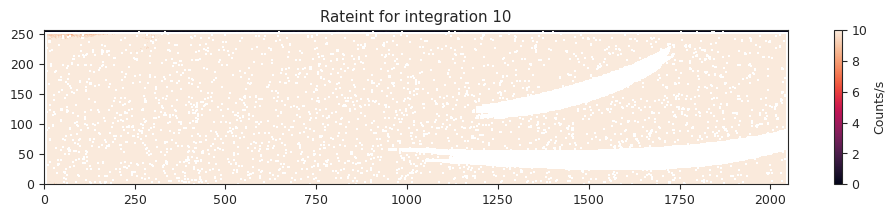

In [26]:
plt.figure(figsize=(12, 2))

plt.title('Rateint for integration 10')
im = plt.imshow(ramps_soss[0][1].data[9, : , :], aspect = 'auto', origin = 'lower')
im.set_clim(0,10)

plt.colorbar(label = 'Counts/s')

How many `DO_NOT_USE`?

In [27]:
count_dnu(tso_uncal[i])

6285

Not perfect, but OK. How do the backgrounds look like?

Okay, next, we'll use PASTASOSS to get traces, and use those traces to mask traces in our actual images. This will help us mask pixel values so they don't included below when we combine them to find the background. First, get the SOSS traces for our given PWCPOS:

In [28]:
pwcpos = ramps_soss[0][1].meta.instrument.pupil_position

# get the order 1 traces for the desired PWCPOS 
traces_order1 = pastasoss.get_soss_traces(pwcpos=pwcpos, order='1', interp=True) 

# now for order 2
traces_order2 = pastasoss.get_soss_traces(pwcpos=pwcpos, order='2', interp=True)

x1, y1 = traces_order1.x, traces_order1.y
x2, y2 = traces_order2.x, traces_order2.y

All right, let's first work on median image 1:

### <font color='white'>-</font>TSO transit analysis<a class="anchor" id="dqflags"></a>

Let's first get the TSO data in a single array:

In [29]:
tso = np.zeros([ramps_soss[0][1].meta.exposure.nints, 
                ramps_soss[0][1].data.shape[1],
                ramps_soss[0][1].data.shape[2]])

tso_err = np.zeros(tso.shape)

times = np.zeros(ramps_soss[0][1].meta.exposure.nints)

counter = 0
for i in range(len(ramps_soss)):

    nints_segment = ramps_soss[i][1].data.shape[0]
    tso[counter:counter+nints_segment] = ramps_soss[i][1].data
    tso_err[counter:counter+nints_segment] = ramps_soss[i][1].err
    times[counter:counter+nints_segment] = ramps_soss[i][1].int_times['int_mid_BJD_TDB']
    counter += nints_segment

print(tso.shape, counter)

(857, 256, 2048) 857


In [30]:
# Generate the median frame:
median_tso = np.median(tso, axis = 0) 

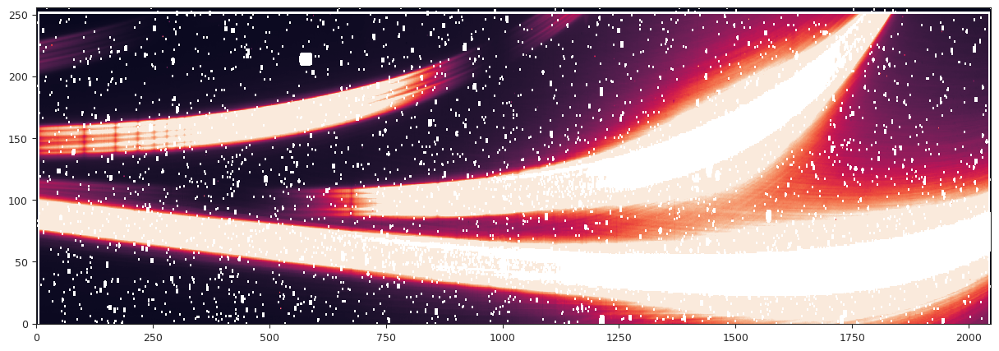

In [43]:
# Get plot:

plt.figure(figsize=(15,5))
im = plt.imshow(median_tso, origin = 'lower', aspect = 'auto')
im.set_clim(2,300)

Is the transit there?

Text(0.5, 0, 'Integration number')

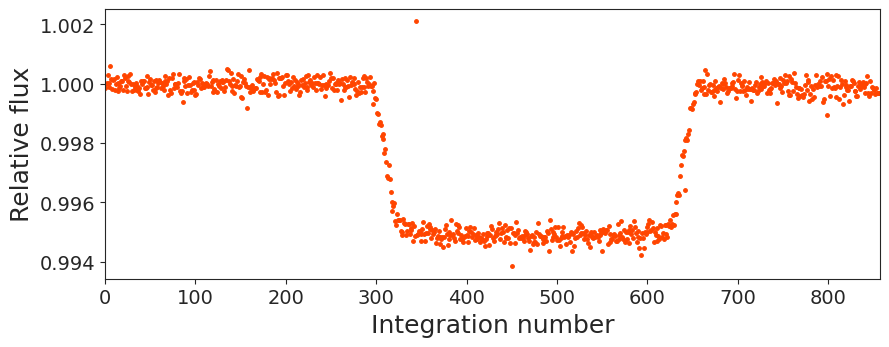

In [57]:
postage = tso[:, 50:100, 250:500]

timeseries = np.nansum(postage, axis = (1,2))
plt.figure(figsize=(10,3.5))

plt.plot(timeseries / np.nanmedian(timeseries[0:80]), '.', color = 'orangered')

plt.xlim(0, len(timeseries))
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
    
plt.ylabel('Relative flux', fontsize = 18)
plt.xlabel('Integration number', fontsize = 18)

Yep! There it is.

In [67]:
smoothed_petit_transit = gaussian_filter(median_filter(timeseries / np.nanmedian(timeseries[0:80]), 15),3)

Text(0.5, 0, 'Integration number')

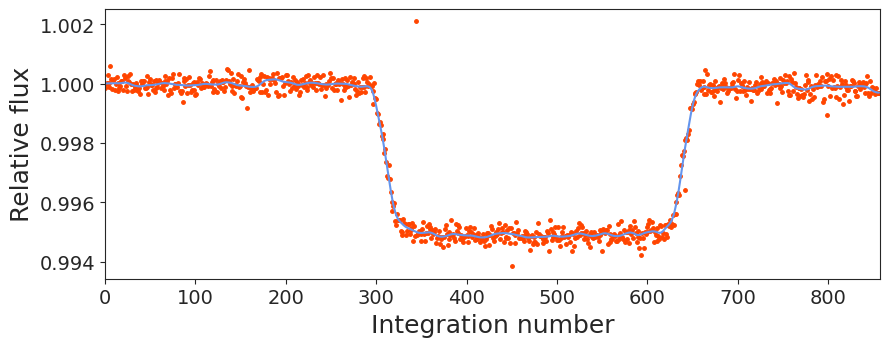

In [68]:
plt.figure(figsize=(10,3.5))

plt.plot(timeseries / np.nanmedian(timeseries[0:80]), '.', color = 'orangered')
plt.plot(smoothed_petit_transit, 'cornflowerblue')

plt.xlim(0, len(timeseries))
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
    
plt.ylabel('Relative flux', fontsize = 18)
plt.xlabel('Integration number', fontsize = 18)

Let's try to get that background out:

In [69]:
model_bkg = np.load('model_background256.npy')

What portion to use to re-scale? Let's see again image:

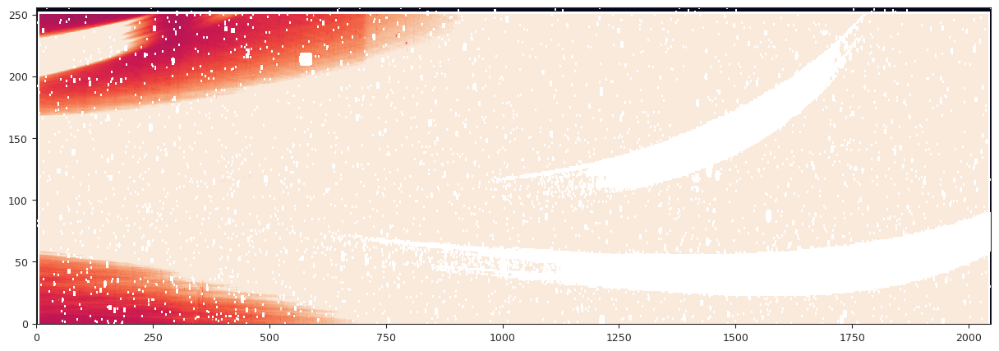

In [75]:
# Get plot:

plt.figure(figsize=(15,5))
im = plt.imshow(median_tso, origin = 'lower', aspect = 'auto')
im.set_clim(2,20)

Barely get the background at the very top:

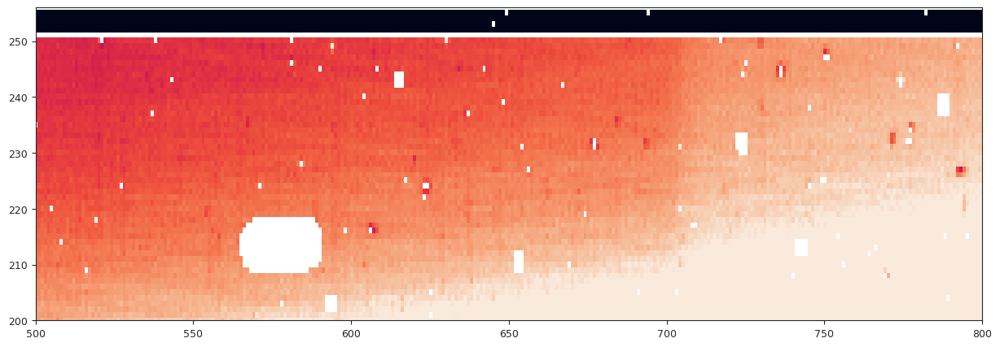

In [76]:
# Get plot:

plt.figure(figsize=(15,5))
im = plt.imshow(median_tso, origin = 'lower', aspect = 'auto')
plt.xlim(500,800)
plt.ylim(200,256)
im.set_clim(2,20)

In [93]:
bkg_postage = median_tso[240:250,650:730]
model_bkg_postage = model_bkg[240:250,650:730]

ratio = bkg_postage / model_bkg_postage
ratio = ratio.flatten()

idx_sorted = np.argsort(ratio)
npixels = len(ratio)

In [96]:
lower_percentile, upper_percentile = 0.1,0.2

Text(0.5, 0, 'Pixel index')

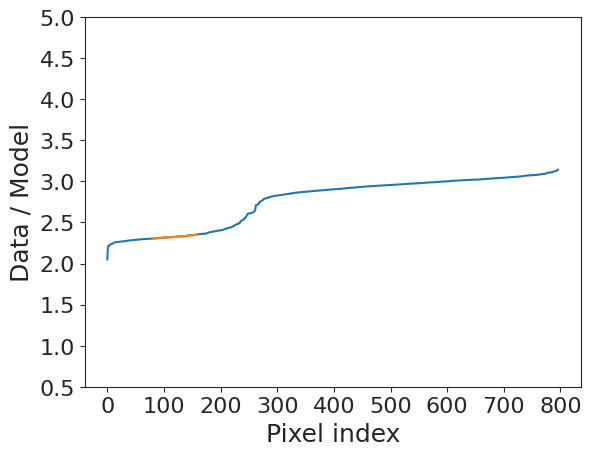

In [97]:
pixel_index = np.arange(len(ratio))
plt.plot(pixel_index, ratio[idx_sorted])
idx_lower = int(npixels*lower_percentile)
idx_upper = int(npixels*upper_percentile)
plt.plot(pixel_index[idx_lower:idx_upper], ratio[idx_sorted][idx_lower:idx_upper])
plt.ylim(0.5,5.0)
plt.xticks(fontsize = 16)
plt.yticks(fontsize = 16)
plt.ylabel('Data / Model', fontsize = 18)
plt.xlabel('Pixel index', fontsize = 18)

Text(0.5, 0, 'Pixel index')

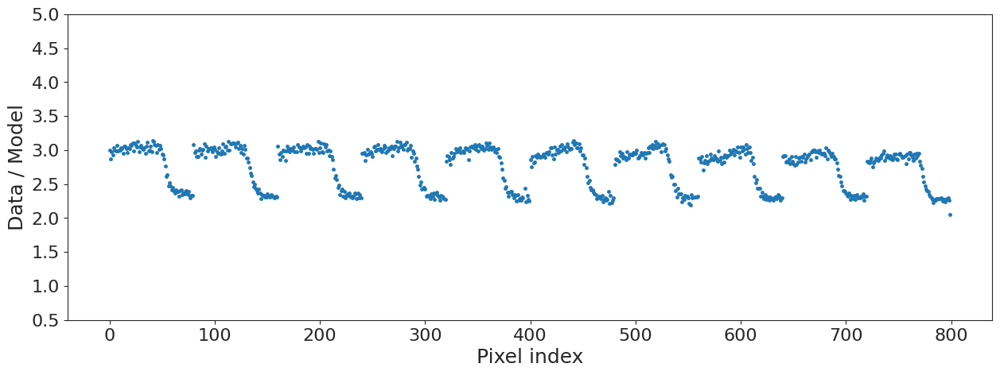

In [98]:
plt.figure(figsize=(15,5))
plt.plot(ratio, '.')
plt.ylim(0.5,5.0)

plt.xticks(fontsize = 16)
plt.yticks(fontsize = 16)
plt.ylabel('Data / Model', fontsize = 18)
plt.xlabel('Pixel index', fontsize = 18)

2.324501684376976


Text(0.5, 0, 'Pixel index')

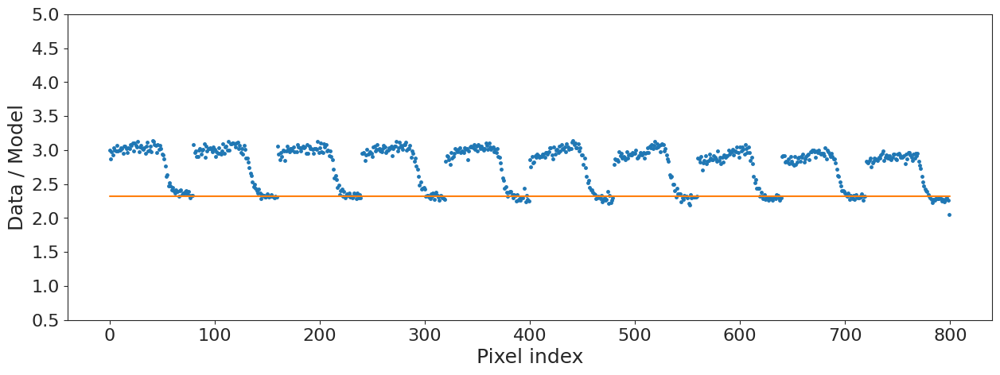

In [99]:
median_ratio = np.nanmedian(ratio[idx_sorted][idx_lower:idx_upper])
print(median_ratio)

plt.figure(figsize=(15,5))
plt.plot(ratio, '.')
plt.plot([0, len(ratio)], [median_ratio, median_ratio])
plt.ylim(0.5,5.0)

plt.xticks(fontsize = 16)
plt.yticks(fontsize = 16)
plt.ylabel('Data / Model', fontsize = 18)
plt.xlabel('Pixel index', fontsize = 18)

In [100]:
original_pixels = bkg_postage.flatten()
bkg_substracted_pixels = bkg_postage.flatten() - model_bkg_postage.flatten() * median_ratio

Let's see how this model does:

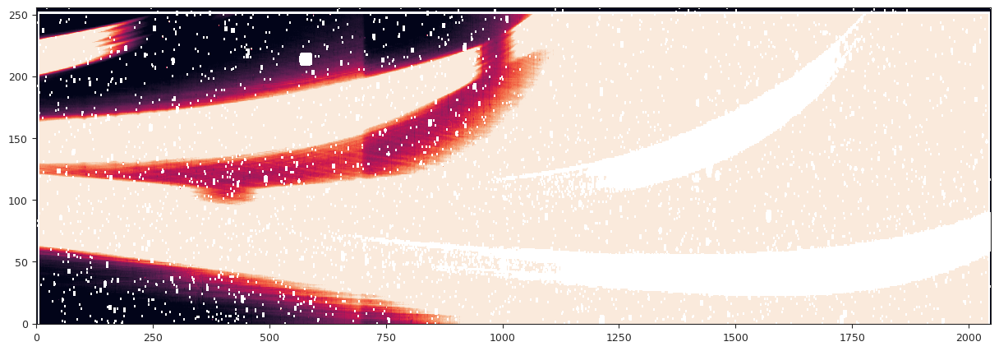

In [101]:
# Get plot:
plt.figure(figsize=(15,5))
im = plt.imshow(median_tso - model_bkg * median_ratio, origin = 'lower', aspect = 'auto')
im.set_clim(2,20)

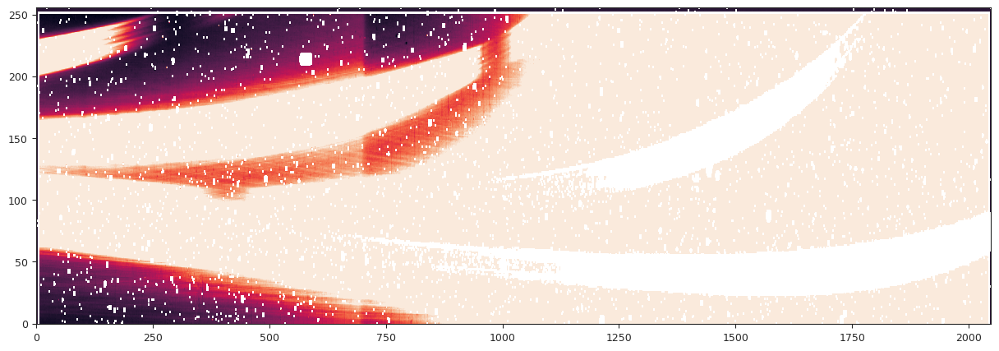

In [102]:
# Get plot:
plt.figure(figsize=(15,5))
im = plt.imshow(median_tso - model_bkg * median_ratio, origin = 'lower', aspect = 'auto')
im.set_clim(-2,16)

It appears is hard to do for this target. Background is perhaps even a different shape!

(0.0, 30.0)

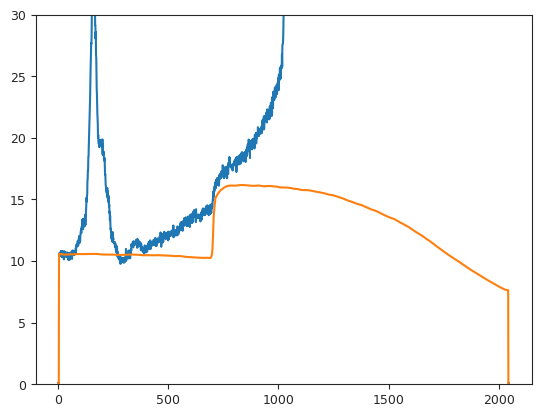

In [118]:
plt.plot(median_tso[240,:])
plt.plot(model_bkg[240,:] * median_ratio*0.95)
plt.ylim(0,30)

(-30.0, 30.0)

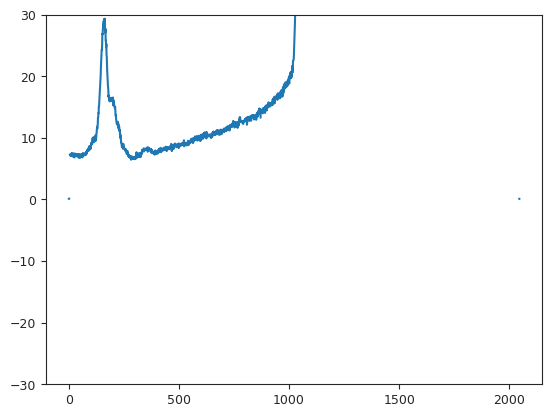

In [127]:
plt.plot(median_tso[240,:] - model_bkg[240,:] * median_ratio*0.3)
plt.ylim(-30,30)

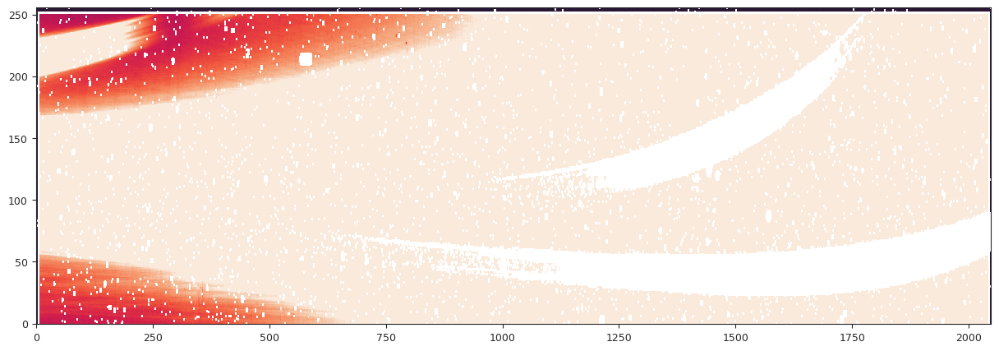

In [128]:
# Get plot:
plt.figure(figsize=(15,5))
im = plt.imshow(median_tso - model_bkg * median_ratio*0.3, origin = 'lower', aspect = 'auto')
im.set_clim(-2,16)

Ah. Maybe the way to go instead is to find the ratio that best "smooths" the transition in this case. I think I found it above:

In [129]:
print(median_ratio)

2.324501684376976


In [130]:
median_ratio = median_ratio*0.3

In [131]:
print(median_ratio)

0.6973505053130928


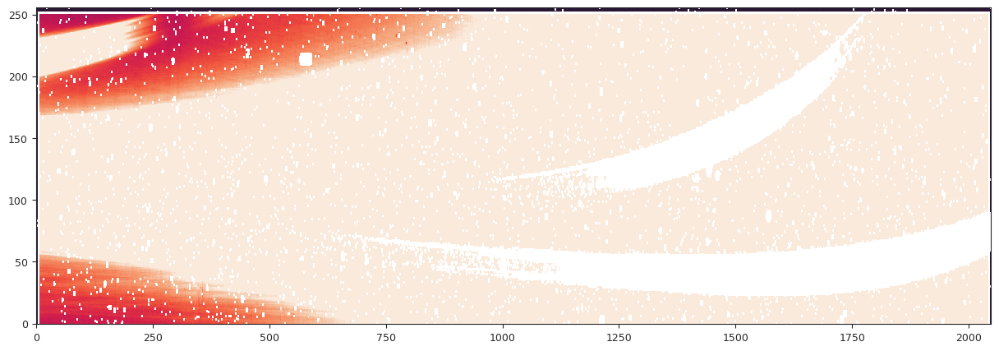

In [132]:
# Get plot:
plt.figure(figsize=(15,5))
im = plt.imshow(median_tso - model_bkg * median_ratio, origin = 'lower', aspect = 'auto')
im.set_clim(-2,16)

## Reducing background-substracted TSO data

All right, let's just move forward with twhat we have. Let's first extract Order 1 and 2 traces to see how they look like via `pastasoss`:

In [105]:
pwcpos

245.68821700005125

In [106]:
pwcpos = ramps_soss[0][1].meta.instrument.pupil_position

# get the order 1 traces for the desired PWCPOS 
traces_order1 = pastasoss.get_soss_traces(pwcpos=pwcpos, order='1', interp=True) 

# now for order 2
traces_order2 = pastasoss.get_soss_traces(pwcpos=pwcpos, order='2', interp=True)


x1, y1, wave1 = traces_order1.x, traces_order1.y, traces_order1.wavelength
x2, y2, wave2 = traces_order2.x, traces_order2.y, traces_order2.wavelength

Let's see how this looks like:

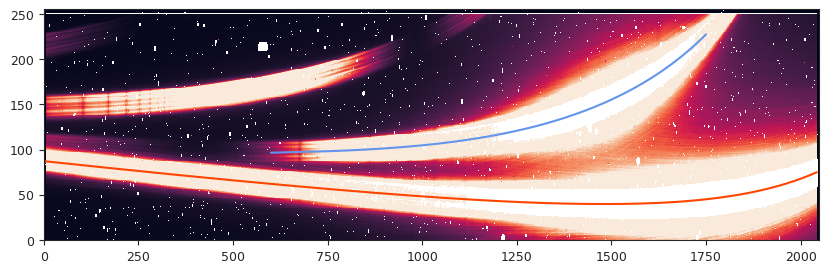

In [134]:
median_tso_bkg_corrected = median_tso - model_bkg * median_ratio

# Get plot:
plt.figure(figsize=(10,3))
im = plt.imshow(median_tso_bkg_corrected, origin = 'lower', interpolation='None', aspect = 'auto')

plt.plot(x1, y1, color = 'orangered')
plt.plot(x2, y2, color = 'cornflowerblue')

im.set_clim(2,300)

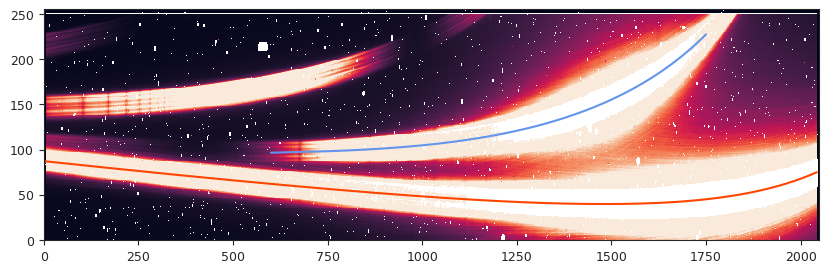

In [136]:
# Get plot:
plt.figure(figsize=(10,3))
im = plt.imshow(median_tso_bkg_corrected, origin = 'lower', interpolation='None', aspect = 'auto')

plt.plot(x1, y1, color = 'orangered')
plt.plot(x2, y2, color = 'cornflowerblue')

im.set_clim(2,300)

That looks pretty good! Let's be bold and try to also extract Order 3 _and_ Order 4. To this end, first replace `nan` with interp1d across columns:

In [137]:
original_tso_med = np.copy(median_tso_bkg_corrected)

In [138]:
rows = np.arange(median_tso_bkg_corrected.shape[0])

# To avoid edge issues, do nans on all rows top and down to be equal to the median:
idx_nan = np.where(np.isnan(median_tso_bkg_corrected[0, :]))
median_tso_bkg_corrected[0, idx_nan] = np.nanmedian(median_tso_bkg_corrected[0, :])
idx_nan = np.where(np.isnan(median_tso_bkg_corrected[-1, :]))
median_tso_bkg_corrected[-1, idx_nan] = np.nanmedian(median_tso_bkg_corrected[-1, :])

# Now loop:
for i in range(median_tso_bkg_corrected.shape[1]):

    nans = np.isnan(median_tso_bkg_corrected[:, i])
    idx_nan = np.where(nans)[0]
    idx_good = np.where(~nans)[0]

    sf = np.copy(median_tso_bkg_corrected[:, i])
    func = interp1d(rows[idx_good], sf[idx_good])
    median_tso_bkg_corrected[idx_nan, i] = func(rows[idx_nan])

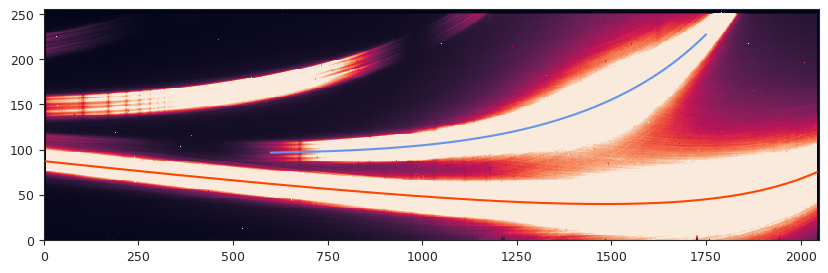

In [140]:
# Get plot:
plt.figure(figsize=(10,3))
im = plt.imshow(median_tso_bkg_corrected, origin = 'lower', interpolation='None', aspect = 'auto')

plt.plot(x1, y1, color = 'orangered')
plt.plot(x2, y2, color = 'cornflowerblue')

im.set_clim(2,300)

In [141]:
ccf_parameters = [-7.5, 3.0, 7.5, 3.0]

lags3, ccf3 = ts.get_ccf(np.arange(median_tso_bkg_corrected.shape[0]), median_tso_bkg_corrected[:, 5], 
                         function = 'double gaussian', parameters = ccf_parameters)

(0.0, 400.0)

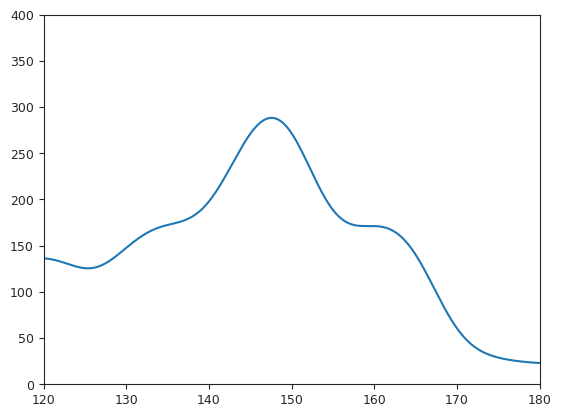

In [145]:
plt.plot(lags3, ccf3)
plt.xlim(120,180)
plt.ylim(0,400)

All right, trace:

In [146]:
x3_start, x3_end = 5, 900
y3_start = 148

x3, y3 = ts.trace_spectrum(median_tso_bkg_corrected, np.zeros(median_tso_bkg_corrected.shape), 
                           xstart = x3_start, ystart = y3_start, xend = x3_end, 
                           ccf_function = 'double gaussian', 
                           ccf_parameters = ccf_parameters, 
                           y_tolerance = 4)

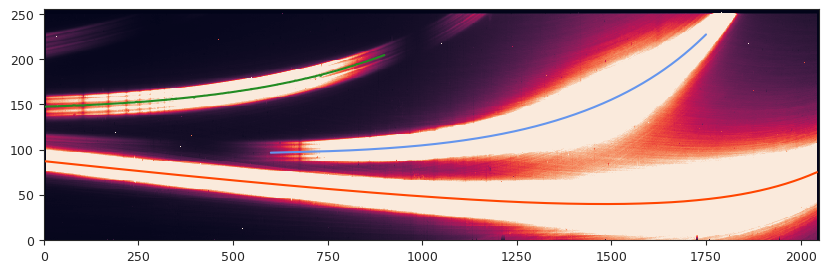

In [148]:
# Get plot:
plt.figure(figsize=(10,3))
im = plt.imshow(median_tso_bkg_corrected, origin = 'lower', interpolation='None', aspect = 'auto')

plt.plot(x1, y1, color = 'orangered')
plt.plot(x2, y2, color = 'cornflowerblue')
plt.plot(x3, y3, color = 'forestgreen')

im.set_clim(2,300)

Fit trace with a polynomial, use that to extend all the way to the edge:

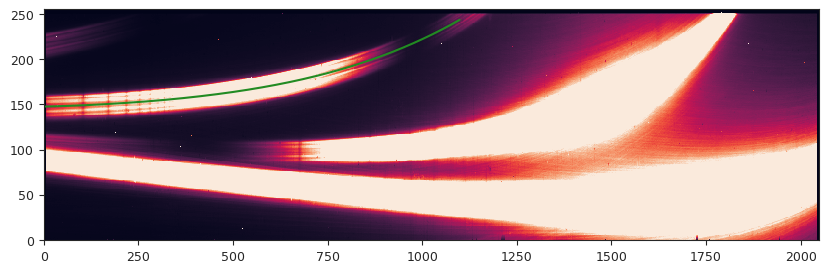

In [160]:
coeffs = np.polyfit(x3, y3, 5)

plt.figure(figsize=(10,3))
im = plt.imshow(median_tso_bkg_corrected, origin = 'lower', interpolation='None', aspect = 'auto')

x3_extended = np.arange(5,1100,1)

plt.plot(x3_extended, np.polyval(coeffs, x3_extended), color = 'forestgreen')
im.set_clim(2,300)

In [161]:
x3, y3 = x3_extended, np.polyval(coeffs, x3_extended)

Smooth with a spline:

In [162]:
_, sfit3 = ts.utils.fit_spline(x3, y3, nknots = 10)

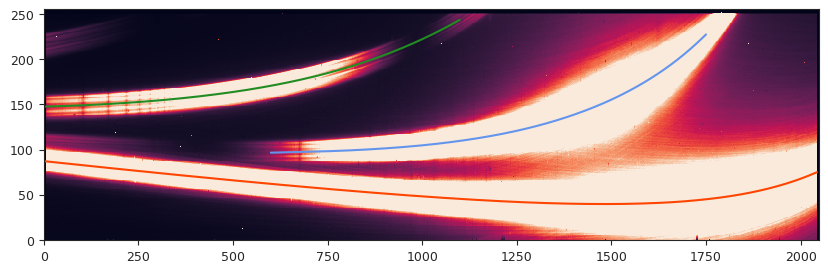

In [163]:
# Get plot:
plt.figure(figsize=(10,3))
im = plt.imshow(median_tso_bkg_corrected, origin = 'lower', interpolation='None', aspect = 'auto')

plt.plot(x1, y1, color = 'orangered')
plt.plot(x2, y2, color = 'cornflowerblue')
plt.plot(x3, sfit3, color = 'forestgreen')

im.set_clim(2,300)

That works. Let's set the spline fit as the value:

In [164]:
y3 = sfit3

Now Order 4:

(0.0, 200.0)

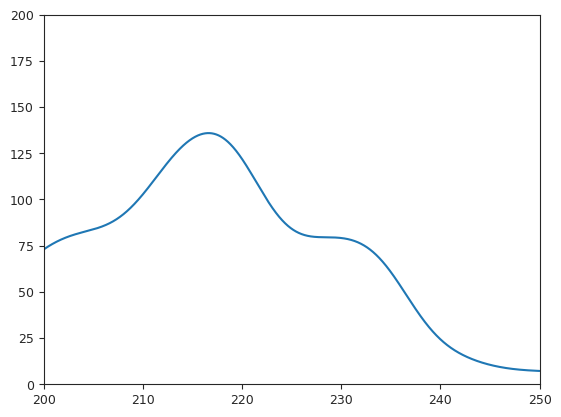

In [166]:
plt.plot(lags3, ccf3)
plt.xlim(200,250)
plt.ylim(0,200)

In [175]:
x4_start, x4_end = 5, 200
y4_start = 218

x4, y4 = ts.trace_spectrum(median_tso_bkg_corrected, np.zeros(median_tso_bkg_corrected.shape), 
                           xstart = x4_start, ystart = y4_start, xend = x4_end, 
                           ccf_function = 'double gaussian', 
                           ccf_parameters = ccf_parameters, 
                           y_tolerance = 4)

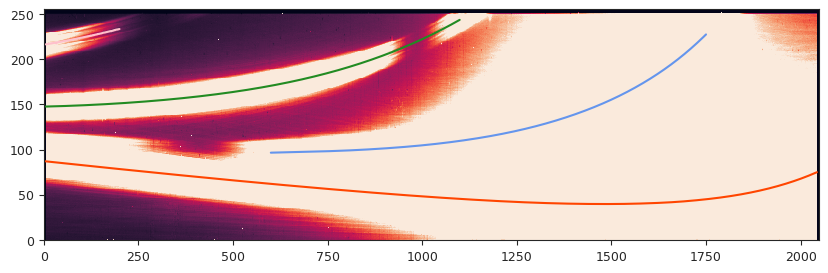

In [177]:
# Get plot:
plt.figure(figsize=(10,3))
im = plt.imshow(median_tso_bkg_corrected, origin = 'lower', interpolation='None', aspect = 'auto')

plt.plot(x1, y1, color = 'orangered')
plt.plot(x2, y2, color = 'cornflowerblue')
plt.plot(x3, y3, color = 'forestgreen')
plt.plot(x4, y4, color = 'pink')

im.set_clim(2,50)

Extend via polynomial as well:

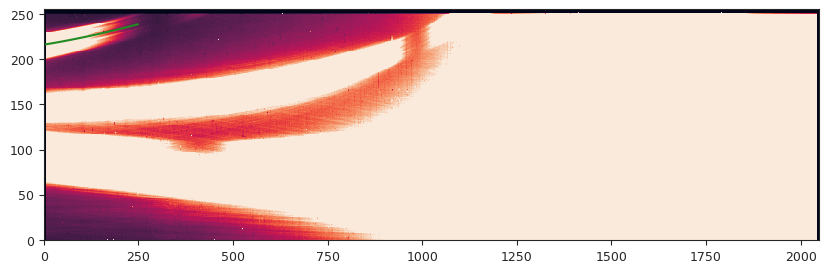

In [181]:
coeffs = np.polyfit(x4, y4, 3)

plt.figure(figsize=(10,3))
im = plt.imshow(median_tso_bkg_corrected, origin = 'lower', interpolation='None', aspect = 'auto')

x4_extended = np.arange(5,250,1)

plt.plot(x4_extended, np.polyval(coeffs, x4_extended), color = 'forestgreen')
im.set_clim(2,30)

In [182]:
x4, y4 = x4_extended, np.polyval(coeffs, x4_extended)

All right; with this, let's get the out-of-transit median (background substracted) frame:

In [183]:
# Replace here integrations before and after transit:
int_before_transit = 250
int_after_transit = 650

bkg_corrected_oot_integrations1 = np.vstack((tso[:int_before_transit, :, :] - model_bkg * median_ratio, \
                              tso[int_after_transit:, :, :] - model_bkg * median_ratio))

bkg_corrected_median_oot1 = np.nanmedian(bkg_corrected_oot_integrations1, axis = 0 )

Check how this looks like:

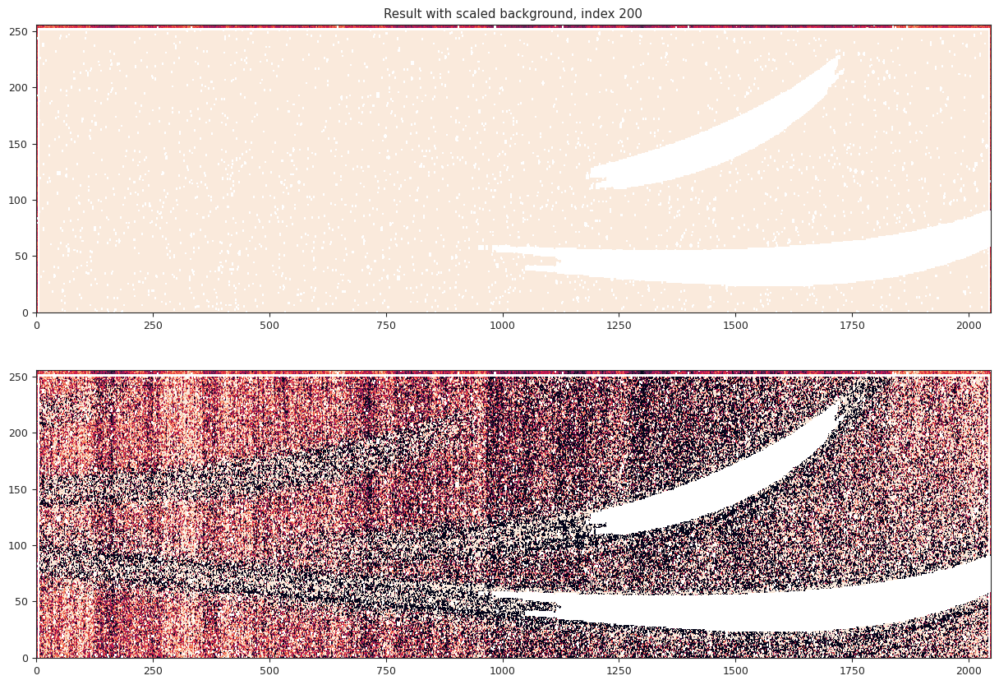

In [184]:
bkg_corrected_frame1 = tso[200, :, :] - model_bkg * median_ratio

plt.figure(figsize=(15,10))

plt.subplot(211)
plt.title('Result with scaled background, index 200')
im = plt.imshow(bkg_corrected_frame1, origin = 'lower', aspect = 'auto')
im.set_clim(-1,1)

plt.subplot(212)
im = plt.imshow(bkg_corrected_frame1 - bkg_corrected_median_oot1, origin = 'lower', aspect = 'auto')
im.set_clim(-0.5,0.5)

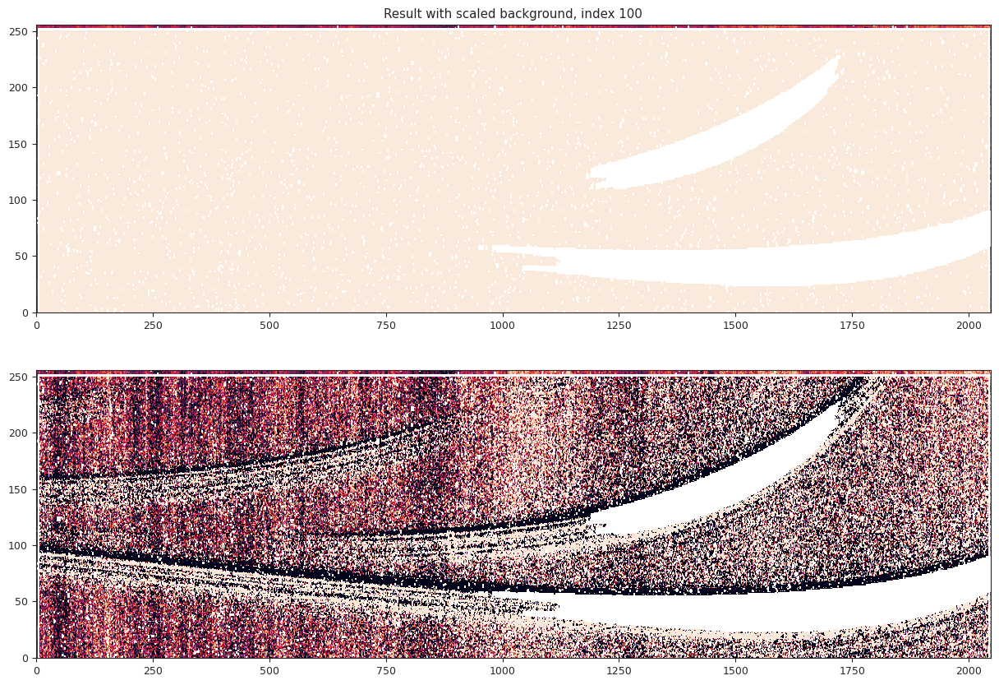

In [185]:
bkg_corrected_frame1 = tso[100, :, :] - model_bkg * median_ratio

plt.figure(figsize=(15,10))

plt.subplot(211)
plt.title('Result with scaled background, index 100')
im = plt.imshow(bkg_corrected_frame1, origin = 'lower', aspect = 'auto')
im.set_clim(-1,1)

plt.subplot(212)
im = plt.imshow(bkg_corrected_frame1 - bkg_corrected_median_oot1, origin = 'lower', aspect = 'auto')
im.set_clim(-0.5,0.5)

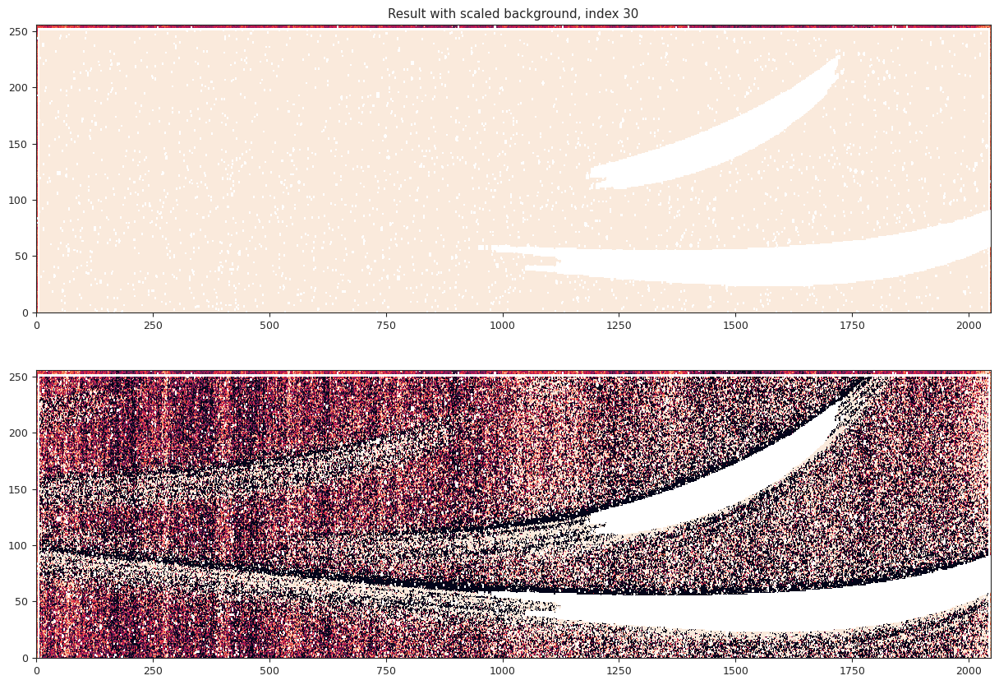

In [186]:
bkg_corrected_frame1 = tso[30, :, :] - model_bkg * median_ratio

plt.figure(figsize=(15,10))

plt.subplot(211)
plt.title('Result with scaled background, index 30')
im = plt.imshow(bkg_corrected_frame1, origin = 'lower', aspect = 'auto')
im.set_clim(-1,1)

plt.subplot(212)
im = plt.imshow(bkg_corrected_frame1 - bkg_corrected_median_oot1, origin = 'lower', aspect = 'auto')
im.set_clim(-0.5,0.5)

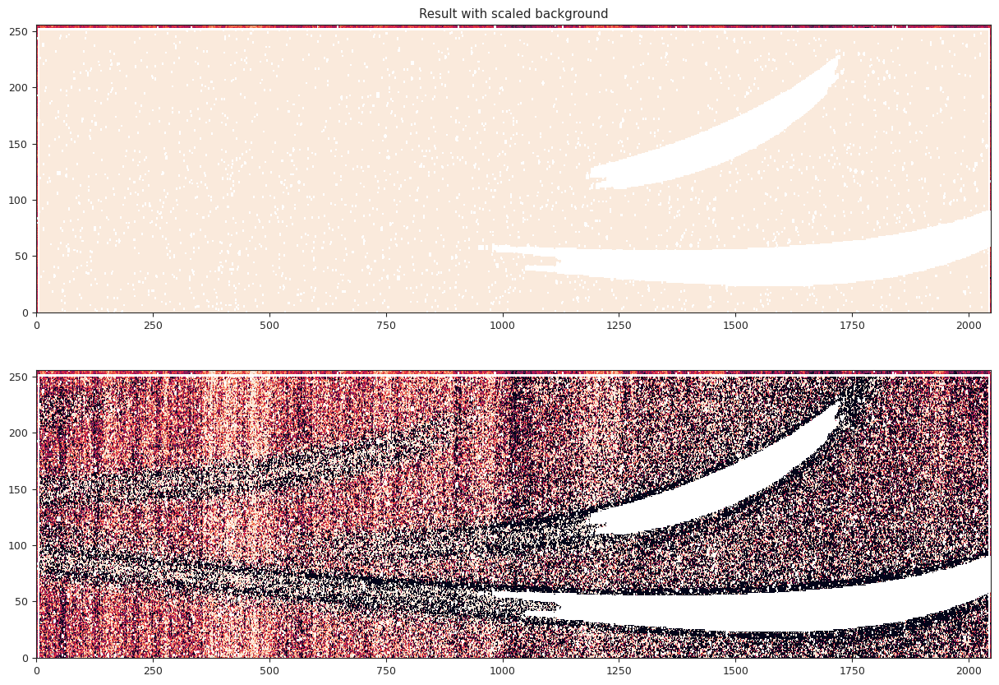

In [187]:
bkg_corrected_frame1 = tso[0, :, :] - model_bkg * median_ratio

plt.figure(figsize=(15,10))

plt.subplot(211)
plt.title('Result with scaled background')
im = plt.imshow(bkg_corrected_frame1, origin = 'lower', aspect = 'auto')
im.set_clim(-1,1)

plt.subplot(212)
im = plt.imshow(bkg_corrected_frame1 - bkg_corrected_median_oot1, origin = 'lower', aspect = 'auto')
im.set_clim(-0.5,0.5)

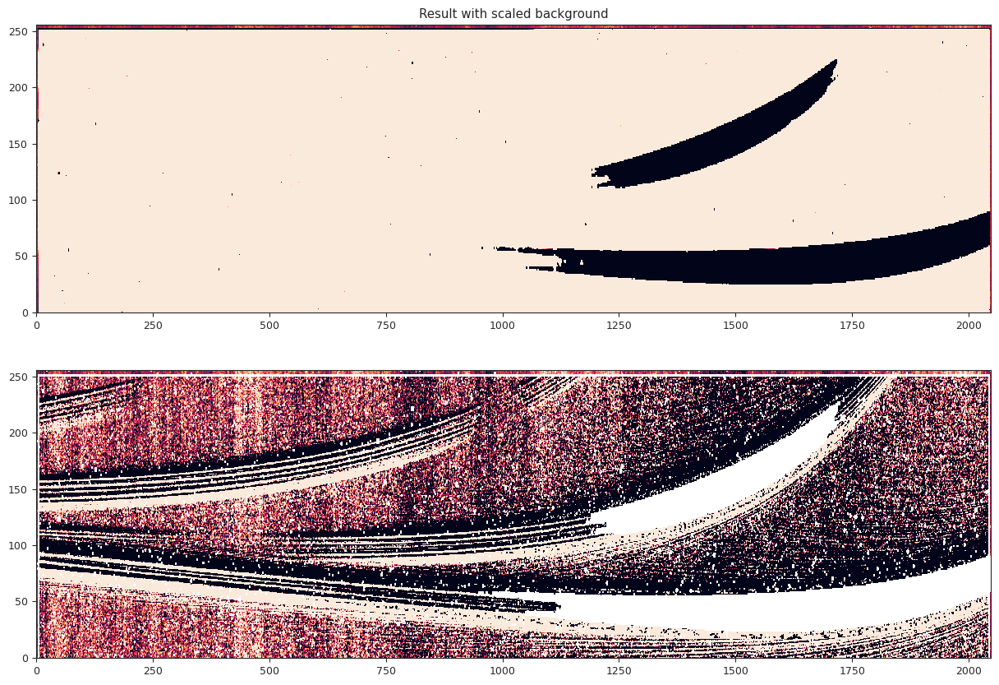

In [252]:
bkg_corrected_frame1 = tso[590, :, :] - model_bkg * median_ratio

plt.figure(figsize=(15,10))

plt.subplot(211)
plt.title('Result with scaled background')
im = plt.imshow(bkg_corrected_frame1, origin = 'lower', aspect = 'auto')
im.set_clim(-1,1)

plt.subplot(212)
im = plt.imshow(bkg_corrected_frame1 - bkg_corrected_median_oot1, origin = 'lower', aspect = 'auto')
im.set_clim(-0.5,0.5)

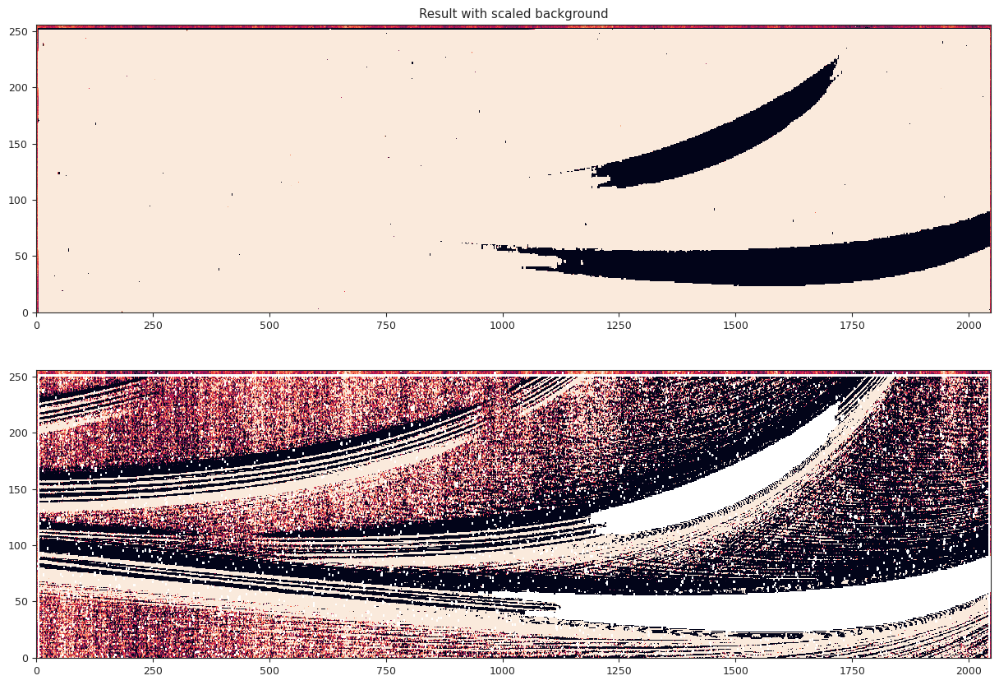

In [254]:
bkg_corrected_frame1 = tso[595, :, :] - model_bkg * median_ratio

plt.figure(figsize=(15,10))

plt.subplot(211)
plt.title('Result with scaled background')
im = plt.imshow(bkg_corrected_frame1, origin = 'lower', aspect = 'auto')
im.set_clim(-1,1)

plt.subplot(212)
im = plt.imshow(bkg_corrected_frame1 - bkg_corrected_median_oot1, origin = 'lower', aspect = 'auto')
im.set_clim(-0.5,0.5)

In [188]:
def correct_1f(median_frame, frame, x, y, min_bkg = 20, max_bkg = 35, mask = None, scale_factor = 1., return_1f = False):
    """
    This. Needs. A. zodii-bkg-corrected. Frame as input :).
    """
    
    new_frame = np.copy(frame)
    
    ms = frame - median_frame * scale_factor
    
    if return_1f:
        
        one_over_f = np.zeros(len(x))
    
    # Go column-by-column substracting values around the trace:
    for i in range(len(x)):
        
        column = int(x[i])
        row = int(y[i])
        
        min_row = np.max([0, row - 35])
        max_row = np.min([256, row + 35])
        
        bkg = np.append(ms[min_row:row-20, column], ms[row+20:max_row, column])
        new_frame[:, column] = new_frame[:, column] - np.nanmedian(bkg)
        
        if return_1f:
            
            one_over_f[i] = np.nanmedian(bkg)
        
    if return_1f:
        
        return one_over_f, new_frame
        
    else:
        
        return new_frame

All right; iterate, correct, get spectra. First, turn all `nan` tso values and errors to 0:

In [189]:
idx_tso_nan = np.where(np.isnan(tso))
tso[idx_tso_nan] = 0.

idx_tso_nan_err = np.where(np.isnan(tso_err))
tso_err[idx_tso_nan_err] = 1e-6

Now iterate to extract spectra:

In [190]:
spectra1_15_scaled = np.zeros([tso.data.shape[0], len(x1)])
spectra1_15_scaled_err = np.zeros([tso.data.shape[0], len(x1)])

spectra2_15_scaled = np.zeros([tso.data.shape[0], len(x2)])
spectra2_15_scaled_err = np.zeros([tso.data.shape[0], len(x2)])

spectra3_15_scaled = np.zeros([tso.data.shape[0], len(x3)])
spectra3_15_scaled_err = np.zeros([tso.data.shape[0], len(x3)])

spectra4_15_scaled = np.zeros([tso.data.shape[0], len(x4)])
spectra4_15_scaled_err = np.zeros([tso.data.shape[0], len(x4)])

for i in range(tso.shape[0]):

    # Extract scaled background spectra first. First Order 1:
    bkg_subs_frame_scaled = correct_1f(bkg_corrected_median_oot1, \
                                tso[i, :, :]  - model_bkg * median_ratio, \
                                x1, y1, \
                                scale_factor = smoothed_petit_transit[i])

    spectra1_15_scaled[i, :], spectra1_15_scaled_err[i, :] = ts.getSimpleSpectrum(bkg_subs_frame_scaled, 
                                                                                 x1,
                                                                                 y1, 
                                                                                 15, 
                                                                                 error_data=tso_err[i, :, :], 
                                                                                 correct_bkg=False)  

    # Order 2:
    bkg_subs_frame_scaled = correct_1f(bkg_corrected_median_oot1, \
                                tso[i, :, :]  - model_bkg * median_ratio, \
                                x2, y2, \
                                scale_factor = smoothed_petit_transit[i])
    
    spectra2_15_scaled[i, :], spectra2_15_scaled_err[i, :] = ts.getSimpleSpectrum(bkg_subs_frame_scaled, 
                                                                                 x2,
                                                                                 y2, 
                                                                                 15, 
                                                                                 error_data=tso_err[i, :, :], 
                                                                                 correct_bkg=False) 

    # Order 3:
    bkg_subs_frame_scaled = correct_1f(bkg_corrected_median_oot1, \
                                tso[i, :, :]  - model_bkg * median_ratio, \
                                x3, y3, \
                                scale_factor = smoothed_petit_transit[i])
    
    spectra3_15_scaled[i, :], spectra3_15_scaled_err[i, :] = ts.getSimpleSpectrum(bkg_subs_frame_scaled, 
                                                                                 x3,
                                                                                 y3, 
                                                                                 15, 
                                                                                 error_data=tso_err[i, :, :], 
                                                                                 correct_bkg=False) 


    # Order 4:
    bkg_subs_frame_scaled = correct_1f(bkg_corrected_median_oot1, \
                                tso[i, :, :]  - model_bkg * median_ratio, \
                                x4, y4, \
                                scale_factor = smoothed_petit_transit[i])
    
    spectra4_15_scaled[i, :], spectra4_15_scaled_err[i, :] = ts.getSimpleSpectrum(bkg_subs_frame_scaled, 
                                                                                  x4,
                                                                                  y4, 
                                                                                  15, 
                                                                                  error_data=tso_err[i, :, :], 
                                                                                  correct_bkg=False) 

Plot extracted spectra:

(0.0, 2048.0)

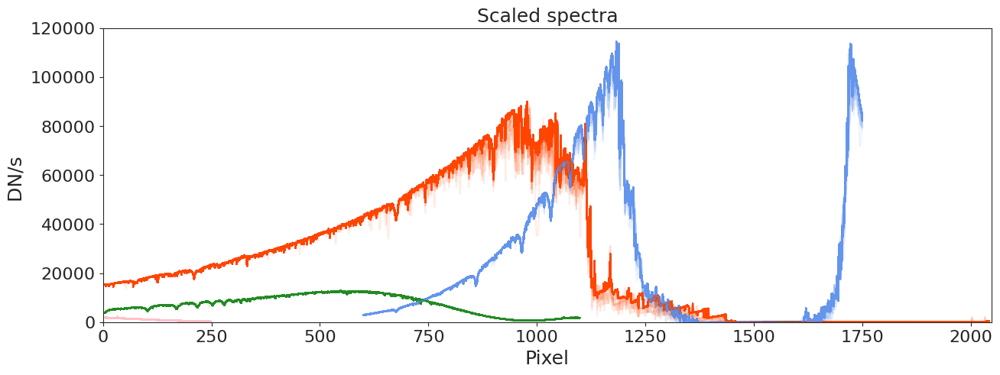

In [196]:
plt.figure(figsize=(15,5))

for i in range(spectra1_15_scaled.shape[0]):
    
    plt.plot(x1, spectra1_15_scaled[i,:], color = 'orangered', alpha = 0.1)
    plt.plot(x2, spectra2_15_scaled[i,:], color = 'cornflowerblue', alpha = 0.1)
    plt.plot(x3, spectra3_15_scaled[i,:], color = 'forestgreen', alpha = 0.1)
    plt.plot(x4, spectra4_15_scaled[i,:], color = 'pink', alpha = 0.1)

plt.title('Scaled spectra', fontsize = 18)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlabel('Pixel', fontsize = 18)
plt.ylabel('DN/s ', fontsize = 18)
plt.ylim(0,120000)
plt.xlim(0, 2048)

Correct for outliers. To this end, first get master spectra:

In [192]:
master_spectra_scaled1 = np.zeros(spectra1_15_scaled.shape)
master_spectra_scaled2 = np.zeros(spectra2_15_scaled.shape)
master_spectra_scaled3 = np.zeros(spectra3_15_scaled.shape)
master_spectra_scaled4 = np.zeros(spectra4_15_scaled.shape)

for i in range(spectra1_15_scaled.shape[0]):
    
    master_spectra_scaled1[i, :] = spectra1_15_scaled[i,:] / np.nanmedian(median_filter(spectra1_15_scaled[i,:], 15))
    master_spectra_scaled2[i, :] = spectra2_15_scaled[i,:] / np.nanmedian(median_filter(spectra2_15_scaled[i,:], 15))
    master_spectra_scaled3[i, :] = spectra3_15_scaled[i,:] / np.nanmedian(median_filter(spectra3_15_scaled[i,:], 15))
    master_spectra_scaled4[i, :] = spectra4_15_scaled[i,:] / np.nanmedian(median_filter(spectra4_15_scaled[i,:], 15))

In [193]:
master_spectrum_scaled1 = np.zeros(spectra1_15_scaled.shape[1])
sigma_master_spectrum_scaled1 = np.zeros(spectra1_15_scaled.shape[1])
master_spectrum_scaled2 = np.zeros(spectra2_15_scaled.shape[1])
sigma_master_spectrum_scaled2 = np.zeros(spectra2_15_scaled.shape[1])
master_spectrum_scaled3 = np.zeros(spectra3_15_scaled.shape[1])
sigma_master_spectrum_scaled3 = np.zeros(spectra3_15_scaled.shape[1])
master_spectrum_scaled4 = np.zeros(spectra4_15_scaled.shape[1])
sigma_master_spectrum_scaled4 = np.zeros(spectra4_15_scaled.shape[1])

for i in range(spectra1_15_scaled.shape[1]):
    
    median1 = np.nanmedian(master_spectra_scaled1[:, i])
    master_spectrum_scaled1[i], sigma_master_spectrum_scaled1[i] = median1, \
                                                     1.2533*ts.get_mad_sigma(median1, master_spectra_scaled1[:, i])

for i in range(spectra2_15_scaled.shape[1]):
    median2 = np.nanmedian(master_spectra_scaled2[:, i])
    master_spectrum_scaled2[i], sigma_master_spectrum_scaled2[i] = median2, \
                                                     1.2533*ts.get_mad_sigma(median2, master_spectra_scaled2[:, i])

for i in range(spectra3_15_scaled.shape[1]):
    median3 = np.nanmedian(master_spectra_scaled3[:, i])
    master_spectrum_scaled3[i], sigma_master_spectrum_scaled3[i] = median3, \
                                                     1.2533*ts.get_mad_sigma(median3, master_spectra_scaled3[:, i])

for i in range(spectra4_15_scaled.shape[1]):
    median4 = np.nanmedian(master_spectra_scaled4[:, i])
    master_spectrum_scaled4[i], sigma_master_spectrum_scaled4[i] = median4, \
                                                     1.2533*ts.get_mad_sigma(median4, master_spectra_scaled4[:, i])

And correct:

In [194]:
corrected_spectra_scaled1 = np.copy(spectra1_15_scaled)
corrected_spectra_scaled2 = np.copy(spectra2_15_scaled)
corrected_spectra_scaled3 = np.copy(spectra3_15_scaled)
corrected_spectra_scaled4 = np.copy(spectra4_15_scaled)

corrected_spectra_scaled1_err = np.copy(spectra1_15_scaled_err)
corrected_spectra_scaled2_err = np.copy(spectra2_15_scaled_err)
corrected_spectra_scaled3_err = np.copy(spectra3_15_scaled_err)
corrected_spectra_scaled4_err = np.copy(spectra4_15_scaled_err)


for i in range(spectra1_15_scaled.shape[0]):
    
    # First Order 1. Get median to scale:
    median = np.nanmedian(median_filter(spectra1_15_scaled[i, :], 15))

    # Scale master spectrum and sigma:
    model = master_spectrum_scaled1 * median
    sigma = sigma_master_spectrum_scaled1 * median
    
    # Identify bad pixels/columns:
    residuals = np.abs(spectra1_15_scaled[i, :] - model)
    idx_bad = np.where(residuals > 5 * sigma)[0]
    
    # Replace:
    if len(idx_bad) != 0:
        
        corrected_spectra_scaled1[i, idx_bad] = model[idx_bad]
        corrected_spectra_scaled1_err[i, idx_bad] = sigma[idx_bad]
        
    # Repeat for Order 2:
    median = np.nanmedian(median_filter(spectra2_15_scaled[i, :], 15))

    # Scale master spectrum and sigma:
    model = master_spectrum_scaled2 * median
    sigma = sigma_master_spectrum_scaled2 * median
    
    # Identify bad pixels/columns:
    residuals = np.abs(spectra2_15_scaled[i, :] - model)
    idx_bad = np.where(residuals > 5 * sigma)[0]
    
    # Replace:
    if len(idx_bad) != 0:
        
        corrected_spectra_scaled2[i, idx_bad] = model[idx_bad]
        corrected_spectra_scaled2_err[i, idx_bad] = sigma[idx_bad]

    # And Order 3:
    median = np.nanmedian(median_filter(spectra3_15_scaled[i, :], 15))

    # Scale master spectrum and sigma:
    model = master_spectrum_scaled3 * median
    sigma = sigma_master_spectrum_scaled3 * median
    
    # Identify bad pixels/columns:
    residuals = np.abs(spectra3_15_scaled[i, :] - model)
    idx_bad = np.where(residuals > 5 * sigma)[0]
    
    # Replace:
    if len(idx_bad) != 0:
        
        corrected_spectra_scaled3[i, idx_bad] = model[idx_bad]
        corrected_spectra_scaled3_err[i, idx_bad] = sigma[idx_bad]

    # And order 4:
    median = np.nanmedian(median_filter(spectra4_15_scaled[i, :], 15))

    # Scale master spectrum and sigma:
    model = master_spectrum_scaled4 * median
    sigma = sigma_master_spectrum_scaled4 * median
    
    # Identify bad pixels/columns:
    residuals = np.abs(spectra4_15_scaled[i, :] - model)
    idx_bad = np.where(residuals > 5 * sigma)[0]
    
    # Replace:
    if len(idx_bad) != 0:
        
        corrected_spectra_scaled4[i, idx_bad] = model[idx_bad]
        corrected_spectra_scaled4_err[i, idx_bad] = sigma[idx_bad]

Let's check how it looks:

(0.0, 2048.0)

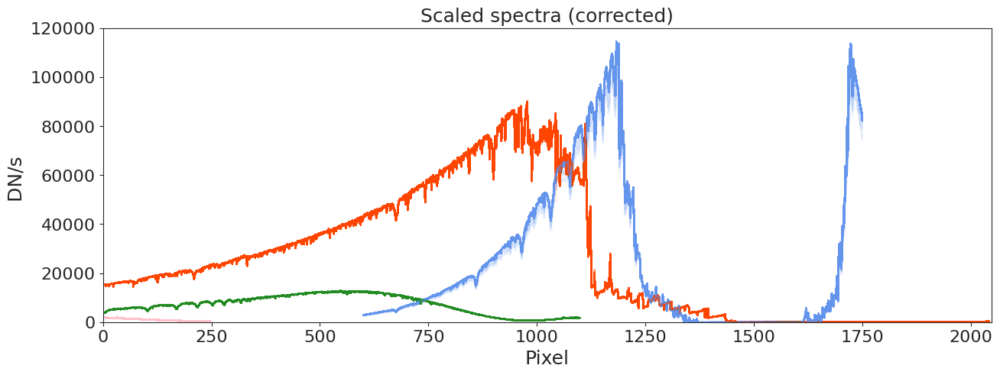

In [197]:
plt.figure(figsize=(15,5))

for i in range(spectra1_15_scaled.shape[0]):
    
    plt.plot(x1, corrected_spectra_scaled1[i,:], color = 'orangered', alpha = 0.1)
    plt.plot(x2, corrected_spectra_scaled2[i,:], color = 'cornflowerblue', alpha = 0.1)
    plt.plot(x3, corrected_spectra_scaled3[i,:], color = 'forestgreen', alpha = 0.1)
    plt.plot(x4, corrected_spectra_scaled4[i,:], color = 'pink', alpha = 0.1)

plt.title('Scaled spectra (corrected)', fontsize = 18)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlabel('Pixel', fontsize = 18)
plt.ylabel('DN/s ', fontsize = 18)
plt.ylim(0,120000)
plt.xlim(0, 2048)

Let's pack this up:

In [199]:
spectra_scaled = {}
spectra_scaled['order1'] = {}
spectra_scaled['order2'] = {}
spectra_scaled['order3'] = {}
spectra_scaled['order4'] = {}
spectra_scaled['order1']['wavelength'] = wave1
spectra_scaled['order2']['wavelength'] = wave2
spectra_scaled['order3']['wavelength'] = np.arange(corrected_spectra_scaled3.shape[1])+1
spectra_scaled['order4']['wavelength'] = np.arange(corrected_spectra_scaled4.shape[1])+1

spectra_scaled['order1']['spectra'] = []
spectra_scaled['order2']['spectra'] = []
spectra_scaled['order3']['spectra'] = []
spectra_scaled['order4']['spectra'] = []
spectra_scaled['order1']['errors'] = []
spectra_scaled['order2']['errors'] = []
spectra_scaled['order3']['errors'] = []
spectra_scaled['order4']['errors'] = []

for i in range(tso.shape[0]):

    spectra_scaled['order1']['spectra'].append(corrected_spectra_scaled1[i, :])
    spectra_scaled['order2']['spectra'].append(corrected_spectra_scaled2[i, :])
    spectra_scaled['order3']['spectra'].append(corrected_spectra_scaled3[i, :])
    spectra_scaled['order4']['spectra'].append(corrected_spectra_scaled4[i, :])
    spectra_scaled['order1']['errors'].append(corrected_spectra_scaled1_err[i, :])
    spectra_scaled['order2']['errors'].append(corrected_spectra_scaled2_err[i, :])
    spectra_scaled['order3']['errors'].append(corrected_spectra_scaled3_err[i, :])
    spectra_scaled['order4']['errors'].append(corrected_spectra_scaled4_err[i, :])

In [200]:
if not os.path.exists('stellar_spectra_scaled.pkl'):
    
    filehandler = open("stellar_spectra_scaled.pkl","wb")
    pickle.dump(spectra_scaled ,filehandler)
    filehandler.close()

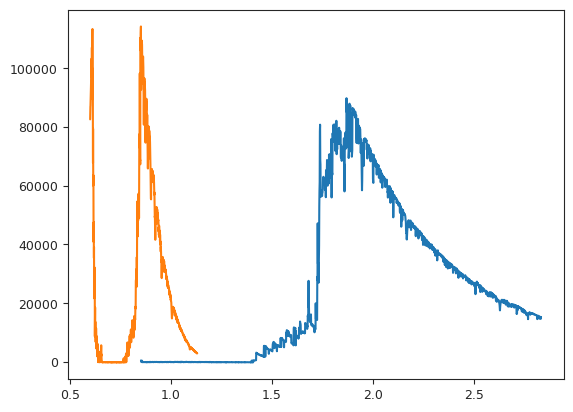

In [201]:
plt.plot(spectra_scaled['order1']['wavelength'], spectra_scaled['order1']['spectra'][0])

plt.plot(spectra_scaled['order2']['wavelength'], spectra_scaled['order2']['spectra'][0])

## Packaging and fitting lightcurves

In [235]:
# Generate lightcurves:
lcs_scaled={}

In [236]:
regenerate_order1 = True
regenerate_order2 = True
regenerate_order3 = True
regenerate_order4 = True

if regenerate_order1:

    order = 'order1'
    get_white_light = True
    lcs_scaled[order] = {}

    # This if true below is just because im lazy and dont want to take tabs back
    if True:

            idx_good = np.where(spectra_scaled[order]['wavelength'] > 2.0)
        
            if get_white_light:

                # Get white-light lightcurve first:
                lcs_scaled[order+' white light'] = {}
                lc = np.array([])
                lcerr = np.array([])

                for i in range(len(spectra_scaled[order]['spectra'])):
                    lc = np.append(lc, np.nansum(spectra_scaled[order]['spectra'][i][idx_good]))
                    lcerr = np.append(lcerr, np.sqrt(np.nansum(spectra_scaled[order]['errors'][i][idx_good]**2)))

                lcs_scaled[order+' white light']['flux'] = np.copy(lc)
                lcs_scaled[order+' white light']['errors'] = np.copy(lcerr)

            # Start saving from the smallest wavelength and up:
            idx_non_zero = np.where( (spectra_scaled[order]['wavelength'] != 0.0) & ~(np.isnan(spectra_scaled[order]['wavelength']))  )[0]
            current_wavelength = np.min(spectra_scaled[order]['wavelength'][idx_non_zero])

            while True:

                idx = np.where(spectra_scaled[order]['wavelength'] == current_wavelength)[0]
                lc = np.array([])
                lcerr = np.array([])

                for i in range(len(spectra_scaled[order]['spectra'])):

                    lc = np.append(lc, spectra_scaled[order]['spectra'][i][idx])
                    lcerr = np.append(lcerr, spectra_scaled[order]['errors'][i][idx])

                lcs_scaled[order][current_wavelength] = {}
                lcs_scaled[order][current_wavelength]['flux'] = np.copy(lc)
                lcs_scaled[order][current_wavelength]['errors'] = np.copy(lcerr)

                # Go to the next wavelengths:
                idx_next = np.where((spectra_scaled[order]['wavelength'] != current_wavelength) & (spectra_scaled[order]['wavelength'] > current_wavelength))[0]

                if len(idx_next) == 0:
                    break
                else:
                    current_wavelength = np.min(spectra_scaled[order]['wavelength'][idx_next])

if regenerate_order2:

    order = 'order2'
    get_white_light = True
    lcs_scaled[order] = {}

    # This if true below is just because im lazy and dont want to take tabs back
    if True:

            idx_good = np.where(spectra_scaled[order]['wavelength'] > 0.9)
        
            if get_white_light:

                # Get white-light lightcurve first:
                lcs_scaled[order+' white light'] = {}
                lc = np.array([])
                lcerr = np.array([])

                for i in range(len(spectra_scaled[order]['spectra'])):
                    lc = np.append(lc, np.nansum(spectra_scaled[order]['spectra'][i][idx_good]))
                    lcerr = np.append(lcerr, np.sqrt(np.nansum(spectra_scaled[order]['errors'][i][idx_good]**2)))

                lcs_scaled[order+' white light']['flux'] = np.copy(lc)
                lcs_scaled[order+' white light']['errors'] = np.copy(lcerr)

            # Start saving from the smallest wavelength and up:
            idx_non_zero = np.where( (spectra_scaled[order]['wavelength'] != 0.0) & ~(np.isnan(spectra_scaled[order]['wavelength']))  )[0]
            current_wavelength = np.min(spectra_scaled[order]['wavelength'][idx_non_zero])

            while True:

                idx = np.where(spectra_scaled[order]['wavelength'] == current_wavelength)[0]
                lc = np.array([])
                lcerr = np.array([])

                for i in range(len(spectra_scaled[order]['spectra'])):

                    lc = np.append(lc, spectra_scaled[order]['spectra'][i][idx])
                    lcerr = np.append(lcerr, spectra_scaled[order]['errors'][i][idx])

                lcs_scaled[order][current_wavelength] = {}
                lcs_scaled[order][current_wavelength]['flux'] = np.copy(lc)
                lcs_scaled[order][current_wavelength]['errors'] = np.copy(lcerr)

                # Go to the next wavelengths:
                idx_next = np.where((spectra_scaled[order]['wavelength'] != current_wavelength) & (spectra_scaled[order]['wavelength'] > current_wavelength))[0]

                if len(idx_next) == 0:
                    break
                else:
                    current_wavelength = np.min(spectra_scaled[order]['wavelength'][idx_next])

if regenerate_order3:

    order = 'order3'
    get_white_light = True
    lcs_scaled[order] = {}

    # This if true below is just because im lazy and dont want to take tabs back
    if True:

            if get_white_light:

                # Get white-light lightcurve first:
                lcs_scaled[order+' white light'] = {}
                lc = np.array([])
                lcerr = np.array([])

                for i in range(len(spectra_scaled[order]['spectra'])):
                    lc = np.append(lc, np.nansum(spectra_scaled[order]['spectra'][i]))
                    lcerr = np.append(lcerr, np.sqrt(np.nansum(spectra_scaled[order]['errors'][i]**2)))

                lcs_scaled[order+' white light']['flux'] = np.copy(lc)
                lcs_scaled[order+' white light']['errors'] = np.copy(lcerr)

            # Start saving from the smallest wavelength and up:
            idx_non_zero = np.where( (spectra_scaled[order]['wavelength'] != 0.0) & ~(np.isnan(spectra_scaled[order]['wavelength']))  )[0]
            current_wavelength = np.min(spectra_scaled[order]['wavelength'][idx_non_zero])

            while True:

                idx = np.where(spectra_scaled[order]['wavelength'] == current_wavelength)[0]
                lc = np.array([])
                lcerr = np.array([])

                for i in range(len(spectra_scaled[order]['spectra'])):

                    lc = np.append(lc, spectra_scaled[order]['spectra'][i][idx])
                    lcerr = np.append(lcerr, spectra_scaled[order]['errors'][i][idx])

                lcs_scaled[order][current_wavelength] = {}
                lcs_scaled[order][current_wavelength]['flux'] = np.copy(lc)
                lcs_scaled[order][current_wavelength]['errors'] = np.copy(lcerr)

                # Go to the next wavelengths:
                idx_next = np.where((spectra_scaled[order]['wavelength'] != current_wavelength) & (spectra_scaled[order]['wavelength'] > current_wavelength))[0]

                if len(idx_next) == 0:
                    break
                else:
                    current_wavelength = np.min(spectra_scaled[order]['wavelength'][idx_next])

if regenerate_order4:

    order = 'order4'
    get_white_light = True
    lcs_scaled[order] = {}

    # This if true below is just because im lazy and dont want to take tabs back
    if True:

            if get_white_light:

                # Get white-light lightcurve first:
                lcs_scaled[order+' white light'] = {}
                lc = np.array([])
                lcerr = np.array([])

                for i in range(len(spectra_scaled[order]['spectra'])):
                    lc = np.append(lc, np.nansum(spectra_scaled[order]['spectra'][i]))
                    lcerr = np.append(lcerr, np.sqrt(np.nansum(spectra_scaled[order]['errors'][i]**2)))

                lcs_scaled[order+' white light']['flux'] = np.copy(lc)
                lcs_scaled[order+' white light']['errors'] = np.copy(lcerr)

            # Start saving from the smallest wavelength and up:
            idx_non_zero = np.where( (spectra_scaled[order]['wavelength'] != 0.0) & ~(np.isnan(spectra_scaled[order]['wavelength']))  )[0]
            current_wavelength = np.min(spectra_scaled[order]['wavelength'][idx_non_zero])

            while True:

                idx = np.where(spectra_scaled[order]['wavelength'] == current_wavelength)[0]
                lc = np.array([])
                lcerr = np.array([])

                for i in range(len(spectra_scaled[order]['spectra'])):

                    lc = np.append(lc, spectra_scaled[order]['spectra'][i][idx])
                    lcerr = np.append(lcerr, spectra_scaled[order]['errors'][i][idx])

                lcs_scaled[order][current_wavelength] = {}
                lcs_scaled[order][current_wavelength]['flux'] = np.copy(lc)
                lcs_scaled[order][current_wavelength]['errors'] = np.copy(lcerr)

                # Go to the next wavelengths:
                idx_next = np.where((spectra_scaled[order]['wavelength'] != current_wavelength) & (spectra_scaled[order]['wavelength'] > current_wavelength))[0]

                if len(idx_next) == 0:
                    break
                else:
                    current_wavelength = np.min(spectra_scaled[order]['wavelength'][idx_next])

In [237]:
lcs_scaled['times'] = times + 2400000.5
t = lcs_scaled['times']

In [242]:
if not os.path.exists('lcs_scaled.pkl'):
    
    filehandler = open("lcs_scaled.pkl","wb")
    pickle.dump(lcs_scaled ,filehandler)
    filehandler.close()

In [207]:
read_again = False

if read_again:
    
    fh = open("lcs_scaled.pkl","rb")
    lcs_scaled = pickle.load(fh)
    fh.close()
    
    fh = open("lcs_empirical.pkl","rb")
    lcs_empirical = pickle.load(fh)
    fh.close()
    
    t = lcs_scaled['times']

## Check lightcurves

In [208]:
# Let's iterate then to get all the lightcurves:
matrices_scaled = {}
ntimes = len(t)

for order in ['order1', 'order2', 'order3', 'order4']:

    # Create the matrix for each order. First, extract wavelengths, and number of wavelengths:
    matrices_scaled[order+' wavelengths'] = list(lcs_scaled[order].keys())
    nwavs = len(lcs_scaled[order].keys())
    print(order, nwavs)

    # Create matrix that will store fluxes:
    matrices_scaled[order] = np.zeros([nwavs, ntimes])

    for i in range(nwavs):
        wavelength = matrices_scaled[order+' wavelengths'][i]
        norm_lc = lcs_scaled[order][wavelength]['flux'] / np.nanmedian(lcs_scaled[order][wavelength]['flux'][:100])
        matrices_scaled[order][i,:] = (norm_lc - 1.)*1e6

order1 2040
order2 1151
order3 1095
order4 245


In [209]:
# Define period of the exoplanet:
period = 2.7240330
# Time-of-transit center:
transit_center = 2458926.5416960
# Update transit center to this day:
n = np.ceil((t[0] - transit_center) / period)
transit_center = transit_center + n * period
# Planet-to-star radius ratio:
rprs = 0.07045
# Transit duration in days:
transit_duration = 4.3336/24.

In [210]:
phases = juliet.utils.get_phases(t, period, transit_center)
times_hours = phases * period * 24.

from mpl_toolkits.axes_grid1 import make_axes_locatable

Text(0, 0.5, 'ppm')

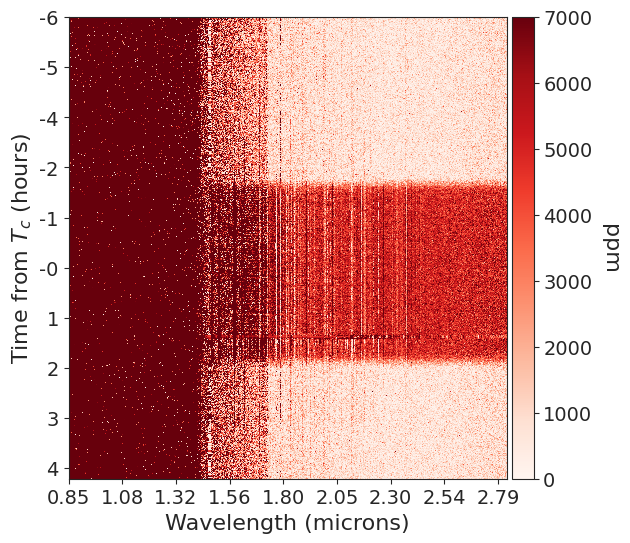

In [211]:
fig, ax1 = plt.subplots(figsize=(6, 6))

# First, order 1:
#plt.title('Order 1 lightcurves', fontsize = 50)
plt.xlabel('Wavelength (microns)', fontsize = 16)
plt.ylabel('Time from $T_c$ (hours)', fontsize = 16)
im1 = ax1.imshow(np.abs(matrices_scaled['order1'].T), interpolation='none', cmap='Reds', aspect = 'auto')
im1.set_clim(0,7000)

# X axis:
ticks = np.arange(0, len(matrices_scaled['order1 wavelengths']), 250)
ticklabels = ["{:0.2f}".format(matrices_scaled['order1 wavelengths'][i]) for i in ticks]
ax1.set_xticks(ticks)
ax1.set_xticklabels(ticklabels, fontsize=14)

# Y axis:
ticks = np.arange(0, len(t),93)
ticklabels = ["{:0.0f}".format(times_hours[i]) for i in ticks]
ax1.set_yticks(ticks)
ax1.set_yticklabels(ticklabels, fontsize=14)

# Colorbar:
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.05)

cbar = fig.colorbar(im1, shrink = 0.08, cax=cax)
cbar.ax.tick_params(labelsize=14)
cbar.ax.get_yaxis().labelpad = 20
cbar.ax.set_ylabel('ppm', rotation=270, fontsize = 16)

#plt.figure(figsize=(12,4))

Text(0, 0.5, 'ppm')

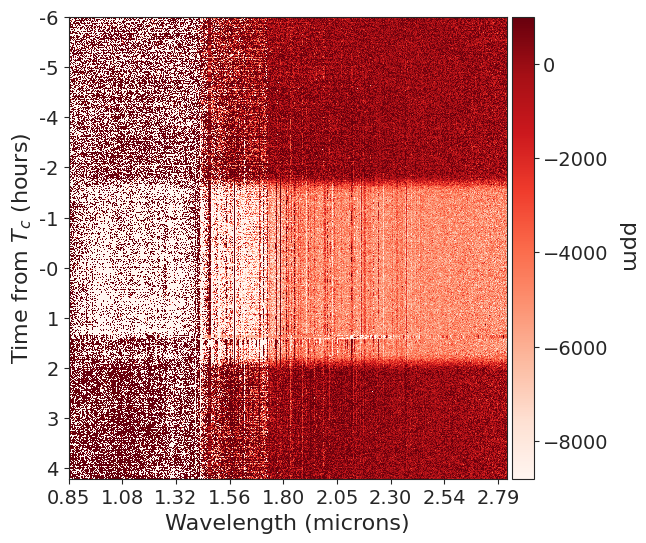

In [212]:
fig, ax1 = plt.subplots(figsize=(6, 6))

# First, order 1:
#plt.title('Order 1 lightcurves', fontsize = 50)
plt.xlabel('Wavelength (microns)', fontsize = 16)
plt.ylabel('Time from $T_c$ (hours)', fontsize = 16)
im1 = ax1.imshow(matrices_scaled['order1'].T, interpolation='none', cmap='Reds', aspect = 'auto')
im1.set_clim(1000, -8000)

# X axis:
ticks = np.arange(0, len(matrices_scaled['order1 wavelengths']), 250)
ticklabels = ["{:0.2f}".format(matrices_scaled['order1 wavelengths'][i]) for i in ticks]
ax1.set_xticks(ticks)
ax1.set_xticklabels(ticklabels, fontsize=14)

# Y axis:
ticks = np.arange(0, len(t),93)
ticklabels = ["{:0.0f}".format(times_hours[i]) for i in ticks]
ax1.set_yticks(ticks)
ax1.set_yticklabels(ticklabels, fontsize=14)

# Colorbar:
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.05)

cbar = fig.colorbar(im1, shrink = 0.08, cax=cax)
cbar.ax.tick_params(labelsize=14)
cbar.ax.get_yaxis().labelpad = 20
cbar.ax.set_ylabel('ppm', rotation=270, fontsize = 16)

#plt.figure(figsize=(12,4))

<Figure size 1800x350 with 0 Axes>

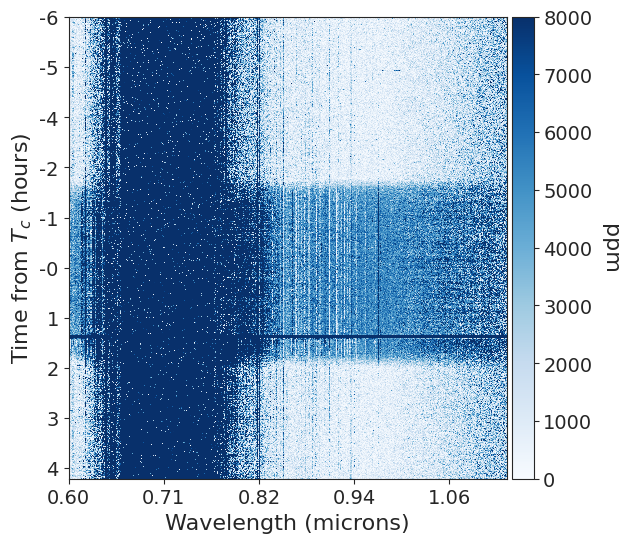

<Figure size 1800x350 with 0 Axes>

In [213]:
fig, ax1 = plt.subplots(figsize=(6, 6))

# First, order 1:
#plt.title('Order 1 lightcurves', fontsize = 50)
plt.xlabel('Wavelength (microns)', fontsize = 16)
plt.ylabel('Time from $T_c$ (hours)', fontsize = 16)
im1 = ax1.imshow(np.abs(matrices_scaled['order2'].T), interpolation='none', cmap='Blues', aspect = 'auto')
im1.set_clim(0,8000)

# X axis:
ticks = np.arange(0, len(matrices_scaled['order2 wavelengths']), 250)
ticklabels = ["{:0.2f}".format(matrices_scaled['order2 wavelengths'][i]) for i in ticks]
ax1.set_xticks(ticks)
ax1.set_xticklabels(ticklabels, fontsize=14)

# Y axis:
ticks = np.arange(0, len(t),93)
ticklabels = ["{:0.0f}".format(times_hours[i]) for i in ticks]
ax1.set_yticks(ticks)
ax1.set_yticklabels(ticklabels, fontsize=14)

# Colorbar:
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.05)

cbar = fig.colorbar(im1, shrink = 0.08, cax=cax)
cbar.ax.tick_params(labelsize=14)
cbar.ax.get_yaxis().labelpad = 20
cbar.ax.set_ylabel('ppm', rotation=270, fontsize = 16)

plt.figure(figsize=(18,3.5))

<Figure size 1800x350 with 0 Axes>

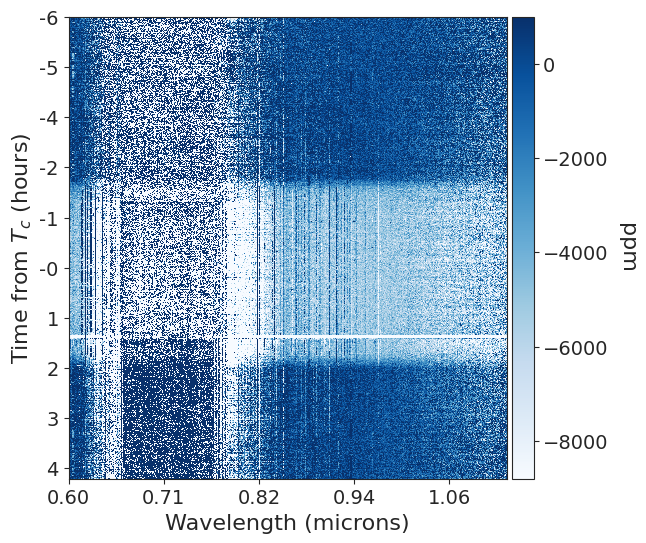

<Figure size 1800x350 with 0 Axes>

In [214]:
fig, ax1 = plt.subplots(figsize=(6, 6))

# First, order 1:
#plt.title('Order 1 lightcurves', fontsize = 50)
plt.xlabel('Wavelength (microns)', fontsize = 16)
plt.ylabel('Time from $T_c$ (hours)', fontsize = 16)
im1 = ax1.imshow(matrices_scaled['order2'].T, interpolation='none', cmap='Blues', aspect = 'auto')
im1.set_clim(1000, -8000)

# X axis:
ticks = np.arange(0, len(matrices_scaled['order2 wavelengths']), 250)
ticklabels = ["{:0.2f}".format(matrices_scaled['order2 wavelengths'][i]) for i in ticks]
ax1.set_xticks(ticks)
ax1.set_xticklabels(ticklabels, fontsize=14)

# Y axis:
ticks = np.arange(0, len(t),93)
ticklabels = ["{:0.0f}".format(times_hours[i]) for i in ticks]
ax1.set_yticks(ticks)
ax1.set_yticklabels(ticklabels, fontsize=14)

# Colorbar:
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.05)

cbar = fig.colorbar(im1, shrink = 0.08, cax=cax)
cbar.ax.tick_params(labelsize=14)
cbar.ax.get_yaxis().labelpad = 20
cbar.ax.set_ylabel('ppm', rotation=270, fontsize = 16)

plt.figure(figsize=(18,3.5))

In [215]:
wlwl = matrices_scaled['order3'].T[:, 600]

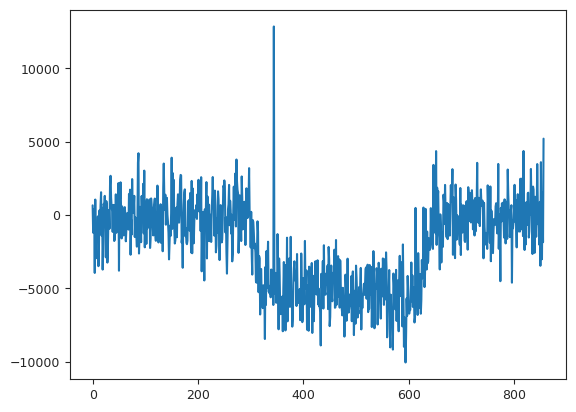

In [216]:
plt.plot(wlwl)

<Figure size 1800x350 with 0 Axes>

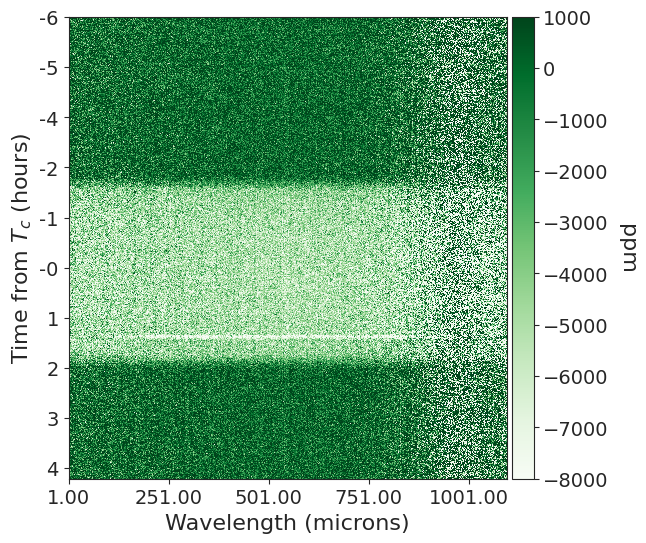

<Figure size 1800x350 with 0 Axes>

In [219]:
fig, ax1 = plt.subplots(figsize=(6, 6))

# First, order 1:
#plt.title('Order 1 lightcurves', fontsize = 50)
plt.xlabel('Wavelength (microns)', fontsize = 16)
plt.ylabel('Time from $T_c$ (hours)', fontsize = 16)
im1 = ax1.imshow(matrices_scaled['order3'].T, interpolation='none', cmap='Greens', aspect = 'auto')
im1.set_clim(-8000,1000)

# X axis:
ticks = np.arange(0, len(matrices_scaled['order3 wavelengths']), 250)
ticklabels = ["{:0.2f}".format(matrices_scaled['order3 wavelengths'][i]) for i in ticks]
ax1.set_xticks(ticks)
ax1.set_xticklabels(ticklabels, fontsize=14)

# Y axis:
ticks = np.arange(0, len(t),93)
ticklabels = ["{:0.0f}".format(times_hours[i]) for i in ticks]
ax1.set_yticks(ticks)
ax1.set_yticklabels(ticklabels, fontsize=14)

# Colorbar:
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.05)

cbar = fig.colorbar(im1, shrink = 0.08, cax=cax)
cbar.ax.tick_params(labelsize=14)
cbar.ax.get_yaxis().labelpad = 20
cbar.ax.set_ylabel('ppm', rotation=270, fontsize = 16)

plt.figure(figsize=(18,3.5))

<Figure size 1800x350 with 0 Axes>

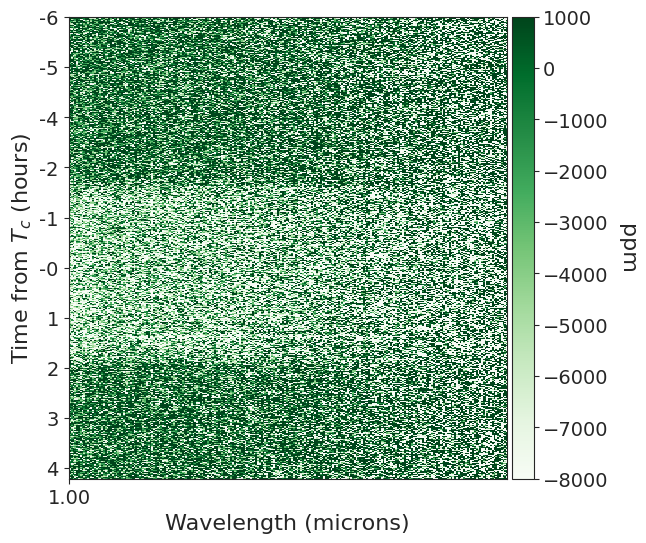

<Figure size 1800x350 with 0 Axes>

In [220]:
fig, ax1 = plt.subplots(figsize=(6, 6))

# First, order 1:
#plt.title('Order 1 lightcurves', fontsize = 50)
plt.xlabel('Wavelength (microns)', fontsize = 16)
plt.ylabel('Time from $T_c$ (hours)', fontsize = 16)
im1 = ax1.imshow(matrices_scaled['order4'].T, interpolation='none', cmap='Greens', aspect = 'auto')
im1.set_clim(-8000,1000)

# X axis:
ticks = np.arange(0, len(matrices_scaled['order4 wavelengths']), 250)
ticklabels = ["{:0.2f}".format(matrices_scaled['order4 wavelengths'][i]) for i in ticks]
ax1.set_xticks(ticks)
ax1.set_xticklabels(ticklabels, fontsize=14)

# Y axis:
ticks = np.arange(0, len(t),93)
ticklabels = ["{:0.0f}".format(times_hours[i]) for i in ticks]
ax1.set_yticks(ticks)
ax1.set_yticklabels(ticklabels, fontsize=14)

# Colorbar:
divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.05)

cbar = fig.colorbar(im1, shrink = 0.08, cax=cax)
cbar.ax.tick_params(labelsize=14)
cbar.ax.get_yaxis().labelpad = 20
cbar.ax.set_ylabel('ppm', rotation=270, fontsize = 16)

plt.figure(figsize=(18,3.5))

Plot white-light lightcurves:

In [223]:
t_integrations = np.arange(len(t))
idx_oot = np.where((t_integrations<250)|(t_integrations>650))

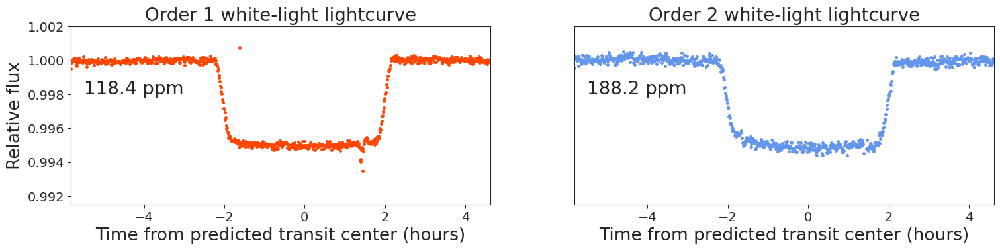

In [241]:
plt.figure(figsize=(18,3.5))

wl_scaled = {}
counter = 1
for order,color in [('order1','orangered'),('order2','cornflowerblue')]:

    plt.subplot(int('12'+str(counter)))

    flux, flux_err = lcs_scaled[order+' white light']['flux'], lcs_scaled[order+' white light']['errors']
    # idx = np.where((~np.isnan(flux)) & (flux>0))[0]

    flux, flux_err = flux / np.nanmedian( flux[idx_oot] ), flux_err / np.nanmedian( flux[idx_oot] )

    plt.errorbar(times_hours, flux, flux_err, fmt = '.', color = color, ms = 5, elinewidth = 1, label = order)
    
    wl_scaled[order] = {}
    wl_scaled[order]['times'], wl_scaled[order]['f'], wl_scaled[order]['ferr'] = t, flux, flux_err
    

    # Plotting details
    plt.xlim(np.min(times_hours), np.max(times_hours))

    plt.ylim(0.9915,1.002)

    plt.xticks(fontsize=14)

    if counter == 2:
        plt.yticks([], fontsize=14)
    else:
        plt.yticks(fontsize=14)


    rms = ts.get_mad_sigma(np.nanmedian(flux[idx_oot] - 1.), flux[idx_oot] - 1.)  * 1e6
    rms_predicted = np.nanmedian( flux_err[idx_oot] ) * 1e6
    plt.text(-5.5, 0.998, '{0:.1f} ppm'.format(rms), fontsize = 20)
    plt.title('O'+order[1:-1]+' '+order[-1]+' white-light lightcurve', fontsize = 20)
    plt.xlabel('Time from predicted transit center (hours)', fontsize = 19)
    if counter == 1:
        plt.ylabel('Relative flux', fontsize = 19)

    counter += 1

(580.0, 610.0)

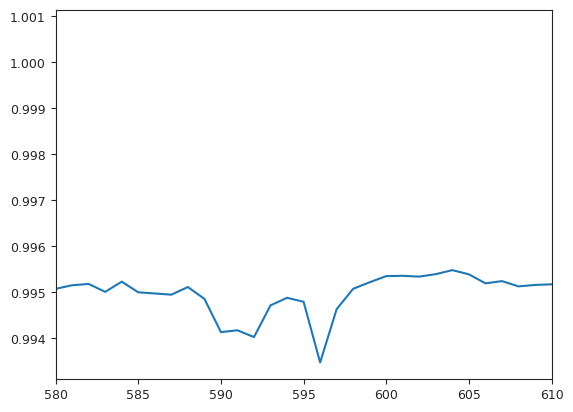

In [251]:
plt.plot(wl_scaled['order1']['f'])
plt.xlim(580,610)

Close-up out-of-transit:

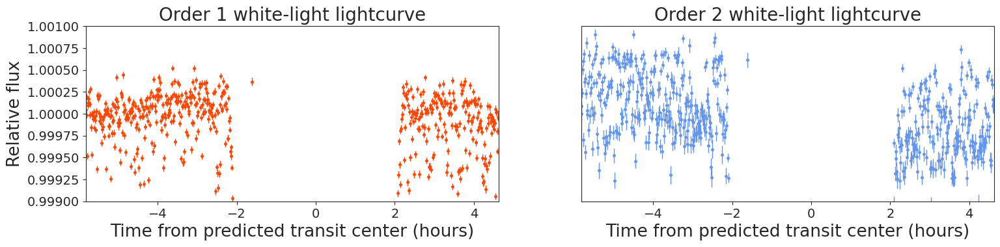

In [225]:
plt.figure(figsize=(18,3.5))

counter = 1
for order,color in [('order1','orangered'),('order2','cornflowerblue')]:

    plt.subplot(int('12'+str(counter)))

    flux, flux_err = lcs_scaled[order+' white light']['flux'], lcs_scaled[order+' white light']['errors']
    # idx = np.where((~np.isnan(flux)) & (flux>0))[0]

    flux, flux_err = flux / np.nanmedian( flux[idx_oot] ), flux_err / np.nanmedian( flux[idx_oot] )

    plt.errorbar(times_hours, flux, flux_err, fmt = '.', color = color, ms = 5, elinewidth = 1, label = order)    

    # Plotting details
    plt.xlim(np.min(times_hours), np.max(times_hours))

    plt.ylim(1-0.001,1+0.001)

    plt.xticks(fontsize=14)

    if counter == 2:
        plt.yticks([], fontsize=14)
    else:
        plt.yticks(fontsize=14)


    rms = ts.get_mad_sigma(np.nanmedian(flux[idx_oot] - 1.), flux[idx_oot] - 1.)  * 1e6
    rms_predicted = np.nanmedian( flux_err[idx_oot] ) * 1e6
    plt.title('O'+order[1:-1]+' '+order[-1]+' white-light lightcurve', fontsize = 20)
    plt.xlabel('Time from predicted transit center (hours)', fontsize = 19)
    if counter == 1:
        plt.ylabel('Relative flux', fontsize = 19)

    counter += 1

What about Order 3?

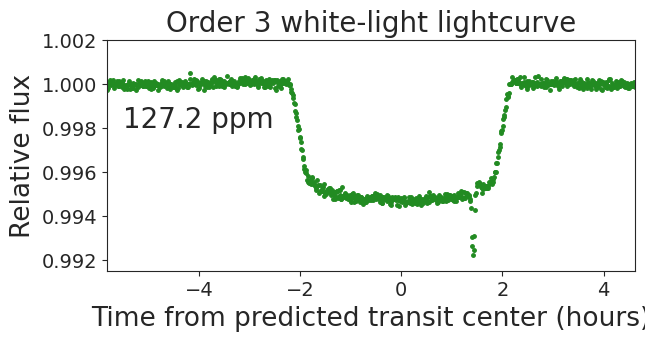

In [290]:
plt.figure(figsize=(15,3))

counter = 1
for order,color in [('order3','forestgreen')]:

    plt.subplot(int('12'+str(counter)))

    flux, flux_err = lcs_scaled[order+' white light']['flux'], lcs_scaled[order+' white light']['errors']
    # idx = np.where((~np.isnan(flux)) & (flux>0))[0]

    flux, flux_err = flux / np.nanmedian( flux[idx_oot] ), flux_err / np.nanmedian( flux[idx_oot] )

    plt.errorbar(times_hours, flux, flux_err, fmt = '.', color = color, ms = 5, elinewidth = 1, label = order)
    
    wl_scaled[order] = {}
    wl_scaled[order]['times'], wl_scaled[order]['f'], wl_scaled[order]['ferr'] = t, flux, flux_err
    

    # Plotting details
    plt.xlim(np.min(times_hours), np.max(times_hours))

    plt.ylim(0.9915,1.002)

    plt.xticks(fontsize=14)

    if counter == 2:
        plt.yticks([], fontsize=14)
    else:
        plt.yticks(fontsize=14)


    rms = ts.get_mad_sigma(np.nanmedian(flux[idx_oot] - 1.), flux[idx_oot] - 1.)  * 1e6
    rms_predicted = np.nanmedian( flux_err[idx_oot] ) * 1e6
    plt.text(-5.5, 0.998, '{0:.1f} ppm'.format(rms), fontsize = 20)
    plt.title('O'+order[1:-1]+' '+order[-1]+' white-light lightcurve', fontsize = 20)
    plt.xlabel('Time from predicted transit center (hours)', fontsize = 19)
    if counter == 1:
        plt.ylabel('Relative flux', fontsize = 19)

    counter += 1

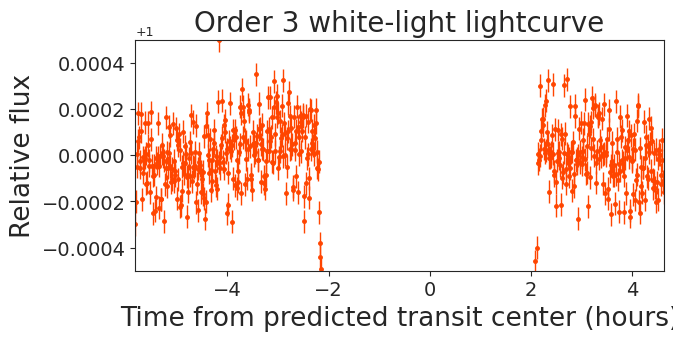

In [233]:
plt.figure(figsize=(15,3))

counter = 1
for order,color in [('order3','orangered')]:

    plt.subplot(int('12'+str(counter)))

    flux, flux_err = lcs_scaled[order+' white light']['flux'], lcs_scaled[order+' white light']['errors']
    # idx = np.where((~np.isnan(flux)) & (flux>0))[0]

    flux, flux_err = flux / np.nanmedian( flux[idx_oot] ), flux_err / np.nanmedian( flux[idx_oot] )

    plt.errorbar(times_hours, flux, flux_err, fmt = '.', color = color, ms = 5, elinewidth = 1, label = order)
    
    wl_scaled[order] = {}
    wl_scaled[order]['times'], wl_scaled[order]['f'], wl_scaled[order]['ferr'] = t, flux, flux_err
    

    # Plotting details
    plt.xlim(np.min(times_hours), np.max(times_hours))

    plt.ylim(1-0.0005,1.+0.0005)

    plt.xticks(fontsize=14)

    if counter == 2:
        plt.yticks([], fontsize=14)
    else:
        plt.yticks(fontsize=14)


    rms = ts.get_mad_sigma(np.nanmedian(flux[idx_oot] - 1.), flux[idx_oot] - 1.)  * 1e6
    rms_predicted = np.nanmedian( flux_err[idx_oot] ) * 1e6
    plt.title('O'+order[1:-1]+' '+order[-1]+' white-light lightcurve', fontsize = 20)
    plt.xlabel('Time from predicted transit center (hours)', fontsize = 19)
    if counter == 1:
        plt.ylabel('Relative flux', fontsize = 19)

    counter += 1

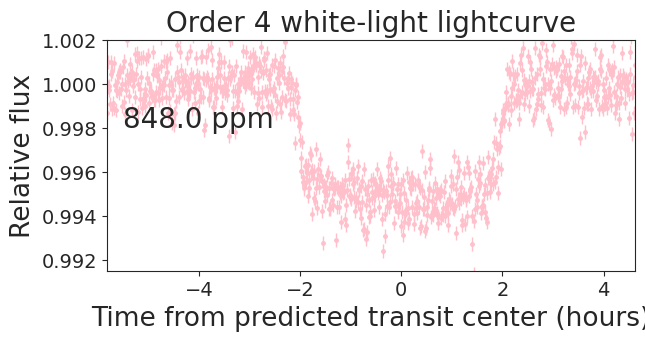

In [234]:
plt.figure(figsize=(15,3))

counter = 1
for order,color in [('order4','pink')]:

    plt.subplot(int('12'+str(counter)))

    flux, flux_err = lcs_scaled[order+' white light']['flux'], lcs_scaled[order+' white light']['errors']
    # idx = np.where((~np.isnan(flux)) & (flux>0))[0]

    flux, flux_err = flux / np.nanmedian( flux[idx_oot] ), flux_err / np.nanmedian( flux[idx_oot] )

    plt.errorbar(times_hours, flux, flux_err, fmt = '.', color = color, ms = 5, elinewidth = 1, label = order)
    
    wl_scaled[order] = {}
    wl_scaled[order]['times'], wl_scaled[order]['f'], wl_scaled[order]['ferr'] = t, flux, flux_err
    

    # Plotting details
    plt.xlim(np.min(times_hours), np.max(times_hours))

    plt.ylim(0.9915,1.002)

    plt.xticks(fontsize=14)

    if counter == 2:
        plt.yticks([], fontsize=14)
    else:
        plt.yticks(fontsize=14)


    rms = ts.get_mad_sigma(np.nanmedian(flux[idx_oot] - 1.), flux[idx_oot] - 1.)  * 1e6
    rms_predicted = np.nanmedian( flux_err[idx_oot] ) * 1e6
    plt.text(-5.5, 0.998, '{0:.1f} ppm'.format(rms), fontsize = 20)
    plt.title('O'+order[1:-1]+' '+order[-1]+' white-light lightcurve', fontsize = 20)
    plt.xlabel('Time from predicted transit center (hours)', fontsize = 19)
    if counter == 1:
        plt.ylabel('Relative flux', fontsize = 19)

    counter += 1

## Regressor search

In [255]:
get_regressors = True

if not os.path.exists('all_fwhms.pkl'):

    # The trace_fwhm function returns two arrays; one (fwhms1) that gives the 
    fwhms1, super_fwhm1 = ts.trace_fwhm(tso, x1, y1)
    fwhms2, super_fwhm2 = ts.trace_fwhm(tso, x2, y2)
    fwhms3, super_fwhm3 = ts.trace_fwhm(tso, x3, y3)
    fwhms4, super_fwhm4 = ts.trace_fwhm(tso, x4, y4)

    all_fwhms = {}
    all_fwhms['order1'] = {}
    all_fwhms['order2'] = {}
    all_fwhms['order3'] = {}
    all_fwhms['order4'] = {}

    all_fwhms['order1']['fwhms'] = fwhms1
    all_fwhms['order1']['super_fwhm'] = super_fwhm1

    all_fwhms['order2']['fwhms'] = fwhms2
    all_fwhms['order2']['super_fwhm'] = super_fwhm2

    all_fwhms['order3']['fwhms'] = fwhms3
    all_fwhms['order3']['super_fwhm'] = super_fwhm3
    
    all_fwhms['order4']['fwhms'] = fwhms4
    all_fwhms['order4']['super_fwhm'] = super_fwhm4
    
    filehandler = open("all_fwhms.pkl","wb")
    pickle.dump(all_fwhms ,filehandler)
    filehandler.close()

else:

    filehandler = open("all_fwhms.pkl","rb")
    all_fwhms = pickle.load(filehandler)
    filehandler.close()


wl_fwhms = {}
wl_fwhms['order1'] = all_fwhms['order1']['super_fwhm']
wl_fwhms['order2'] = all_fwhms['order2']['super_fwhm']
wl_fwhms['order3'] = all_fwhms['order3']['super_fwhm']
wl_fwhms['order4'] = all_fwhms['order4']['super_fwhm']

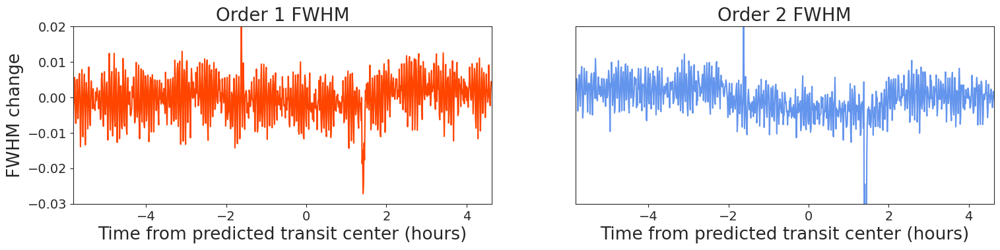

In [256]:
plt.figure(figsize=(18,3.5))

counter = 1
for order,color in [('order1','orangered'),('order2','cornflowerblue')]:

    plt.subplot(int('12'+str(counter)))

    plt.plot(times_hours, wl_fwhms[order], color = color, label = order)

    # Plotting details
    plt.xlim(np.min(times_hours), np.max(times_hours))

    plt.xticks(fontsize=14)

    if counter == 2:
        plt.yticks([], fontsize=14)
    else:
        plt.yticks(fontsize=14)
        
    plt.ylim(-0.03,0.02)

    plt.title('O'+order[1:-1]+' '+order[-1]+' FWHM', fontsize = 20)
    plt.xlabel('Time from predicted transit center (hours)', fontsize = 19)
    if counter == 1:
        plt.ylabel('FWHM change', fontsize = 19)

    counter += 1

What about the guidestar data?

In [257]:
spk = spelunker.load(pid=3279, obs_num='1', visit='1', save=True, token=token)

2024-03-22 02:42:47,732 - stpipe - INFO - MAST API token accepted, welcome Nestor Espinoza


Current working directory for spelunker: /ifs/jwst/wit/witserv/data18/nespinoza/niriss/order3-calibration/spelunker_outputs

INFO: MAST API token accepted, welcome Nestor Espinoza [astroquery.mast.auth]
Connecting with astroquery...


Optimize photometry:

In [258]:
spk.optimize_photometry()

In [259]:
spk.photometry_mask

array([[0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 1., 1., 1., 1., 0., 0.],
       [0., 0., 1., 1., 1., 1., 0., 0.],
       [0., 0., 1., 1., 1., 1., 0., 0.],
       [0., 0., 0., 1., 1., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0.]])

Give the photometry a quick check:

(-0.33303556591272354, 10.371958326548338)

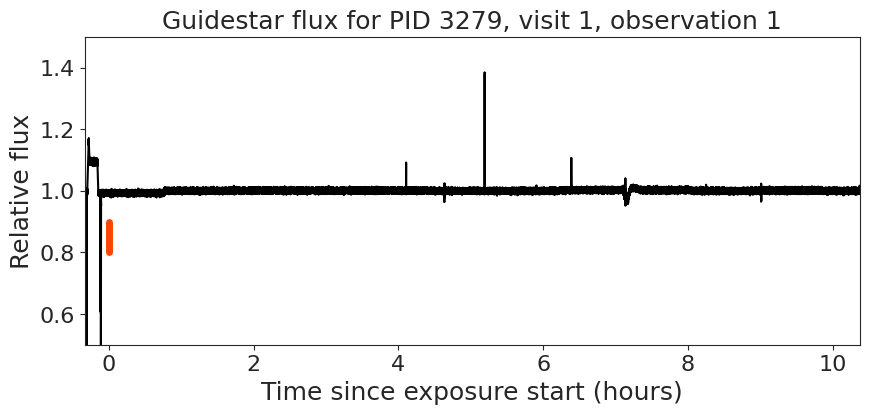

In [260]:
tstart = np.min(t)
exposure_time = ( np.max(t) - tstart ) * 24.

plt.figure(figsize=(10,4))

fg_time_since_start = (spk.fg_time + 2400000.5 - tstart) * 24

plt.plot(fg_time_since_start, spk.fg_flux / np.nanmedian( spk.fg_flux ) , color = 'black')

plt.title('Guidestar flux for PID 3279, visit 1, observation 1', fontsize = 18)
plt.xlabel('Time since exposure start (hours)', fontsize = 18)
plt.ylabel('Relative flux', fontsize = 18)

plt.ylim(0.5,1.5)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)

plt.plot([0.,0.],[0.8,0.9], color = 'orangered', lw = 5)
plt.plot([exposure_time,exposure_time],[0.8,0.9], color = 'orangered', lw = 5)

plt.xlim(np.min(fg_time_since_start), np.max(fg_time_since_start))

(0.0, 10.450892060995102)

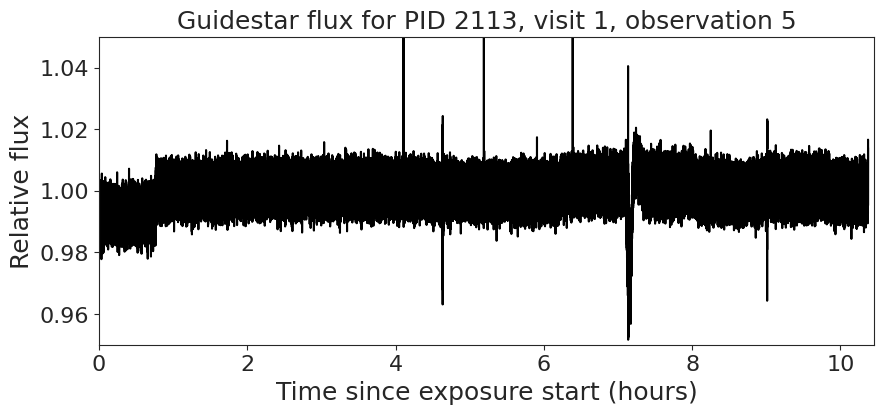

In [261]:
tstart = np.min(t)
exposure_time = ( np.max(t) - tstart ) * 24.

plt.figure(figsize=(10,4))

fg_time_since_start = (spk.fg_time + 2400000.5 - tstart) * 24

plt.plot(fg_time_since_start, spk.fg_flux / np.nanmedian( spk.fg_flux ) , color = 'black')

plt.title('Guidestar flux for PID 3279, visit 1, observation 1', fontsize = 18)
plt.xlabel('Time since exposure start (hours)', fontsize = 18)
plt.ylabel('Relative flux', fontsize = 18)

plt.ylim(0.95,1.05)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)

plt.xlim(0., exposure_time)

Bin photometry to science time-stamps:

In [262]:
def bin_fgs_to_science(tscience, tfgs, ffgs):
    """
    This function bins an FGS time-series defined by the times `tfgs` and fluxes `ffgs`, to times `tscience`. 
    The function assumes that (1) `tscience` are times obtained at pseudo-regular intervals (i.e., that times 
    on `tscience` next to each other are similar), and that (2) `tscience` is ordered in chronological order.
    """

    nscience = len(tscience)
    binned_fgs = np.zeros( nscience )
    binned_fgs_err = np.zeros( nscience )
    for i in range( nscience ):

        if i == 0:

            dt = tscience[1] - tscience[0] 

        elif i == nscience - 1:

            dt = tscience[-1] - tscience[-2]

        else:

            dt1 = tscience[i] - tscience[i-1]
            dt2 = tscience[i+1] - tscience[i]
            dt = ( dt1 + dt2 ) * 0.5
            
        idx = np.where( np.abs(tscience[i] - tfgs) < 0.5*dt )[0]
        binned_fgs[i] = np.mean( ffgs[idx] )
        binned_fgs_err[i] = np.sqrt( np.var( ffgs[idx] ) ) / np.sqrt( len(idx) )

    return binned_fgs, binned_fgs_err

In [263]:
binned_fgsphot, binned_fgsphot_err = bin_fgs_to_science(t, spk.fg_time + 2400000.5, spk.fg_flux / np.nanmedian( spk.fg_flux ))

(0.0, 10.450892060995102)

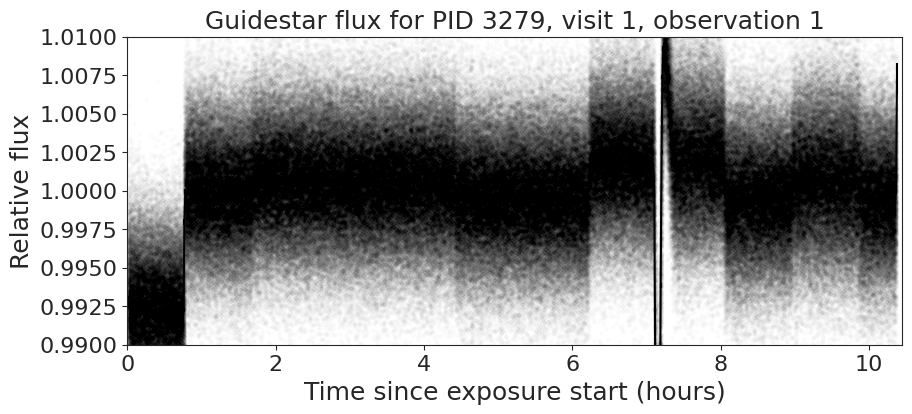

In [264]:
tstart = np.min(t)
exposure_time = ( np.max(t) - tstart ) * 24.

plt.figure(figsize=(10,4))

fg_time_since_start = (spk.fg_time + 2400000.5 - tstart) * 24

plt.plot(fg_time_since_start, spk.fg_flux / np.nanmedian( spk.fg_flux ), '.', color = 'black', alpha = 0.01)
plt.errorbar( (t - tstart) * 24., binned_fgsphot, binned_fgsphot_err, color = 'black')

plt.title('Guidestar flux for PID 3279, visit 1, observation 1', fontsize = 18)
plt.xlabel('Time since exposure start (hours)', fontsize = 18)
plt.ylabel('Relative flux', fontsize = 18)

plt.ylim(0.99,1.01)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)

plt.xlim(0., exposure_time)

Let's plot this photometry on top of the Order 1 time-series, for instance:

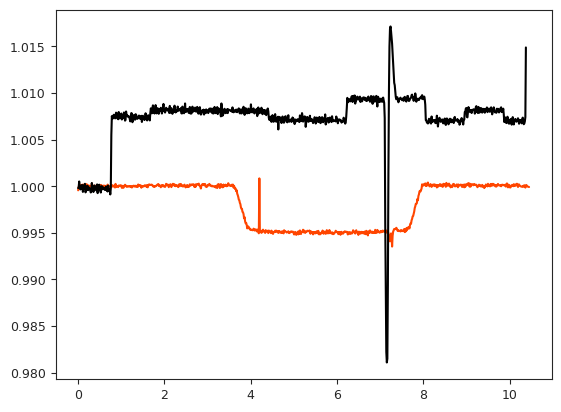

In [265]:
order = 'order1'
theflux = lcs_scaled[order+' white light']['flux']

plt.plot((t - tstart) * 24., theflux / np.nanmedian(theflux[:100]), color = 'orangered')
plt.plot((t - tstart) * 24., binned_fgsphot / np.nanmedian(binned_fgsphot[:100]), color = 'black')

(0.0, 4.0)

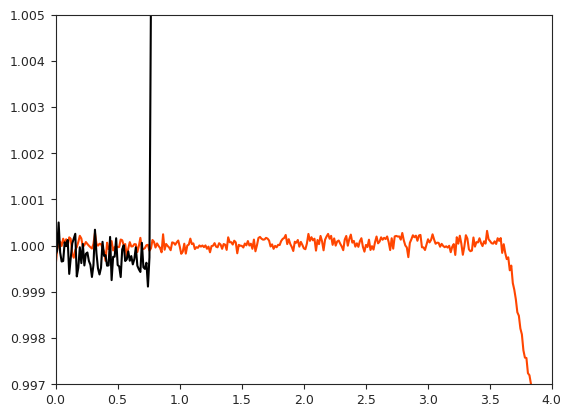

In [266]:
order = 'order1'
theflux = lcs_scaled[order+' white light']['flux']

plt.plot((t - tstart) * 24., theflux / np.nanmedian(theflux[:100]), color = 'orangered')
plt.plot((t - tstart) * 24., binned_fgsphot / np.nanmedian(binned_fgsphot[:100]), color = 'black')

plt.ylim(0.997,1.005)
plt.xlim(0,4)

(9.0, 10.450892060995102)

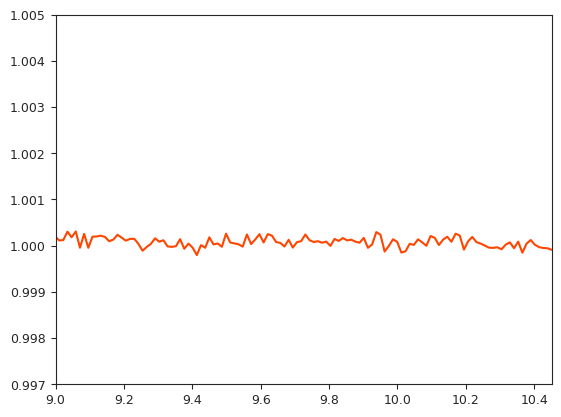

In [267]:
order = 'order1'
theflux = lcs_scaled[order+' white light']['flux']

plt.plot((t - tstart) * 24., theflux / np.nanmedian(theflux[:100]), color = 'orangered')
plt.plot((t - tstart) * 24., (binned_fgsphot / np.nanmedian(binned_fgsphot[:100])), color = 'black')

plt.ylim(0.997,1.005)
plt.xlim(9, np.max( (t - tstart) * 24. ))

Let's get gaussians out of the data:

In [268]:
spk.gauss2d_fit(ncpus=4)

2024-03-22 02:44:38,076	INFO worker.py:1673 -- Started a local Ray instance.


amplitude,x_mean,y_mean,x_stddev,y_stddev,theta,offset
float64,float64,float64,float64,float64,float64,float64
90.94510670957028,2.8353814292886845,3.066093774383266,0.6434023723016659,0.6958615716160041,-0.34676510951933937,1.0284901914928883
91.47596491564927,2.845310725350669,3.0650517429435817,0.6425084392443327,0.6931689850468586,-0.31027624147623617,1.0408235364550533
91.09795585515592,2.850970833246533,3.0633271748214193,0.6433695061780764,0.6952232856659557,-0.23495513762356388,1.0746172515831718
92.02800881051769,2.864948266189571,3.056582925571051,0.639187233506456,0.6899643463612076,-0.31048360408135833,1.0714178493946183
91.4151473778481,2.8686702186990973,3.0625468047642563,0.6403457959531058,0.6937858641980321,-0.301181479094187,1.0676858066769406
93.28563826011671,2.875906517135181,3.0587165164217804,0.6381364047305691,0.6868741215825294,-0.30329726683574737,1.0730314495038922
92.91486392135694,2.8871877103634667,3.0632874688202385,0.6339338961238804,0.6899462846022499,-0.3159392518770083,1.10174944294201
93.85370854957276,2.8992764537878357,3.0679602963422177,0.630779770104768,0.688698668227525,-0.31332406621601955,1.0617614952040257
93.5181418271852,2.9130533754822006,3.0649918465032644,0.6341302192826423,0.686417578501986,-0.28778580574443846,1.082471213328392


In [269]:
fgs_results = {}

for key in list(spk.gaussfit_results.keys()):

    fgs_results[key], _ = bin_fgs_to_science(t, spk.fg_time + 2400000.5, 
                                             spk.gaussfit_results[key].value)

In [270]:
print(fgs_results.keys())

dict_keys(['amplitude', 'x_mean', 'y_mean', 'x_stddev', 'y_stddev', 'theta', 'offset'])


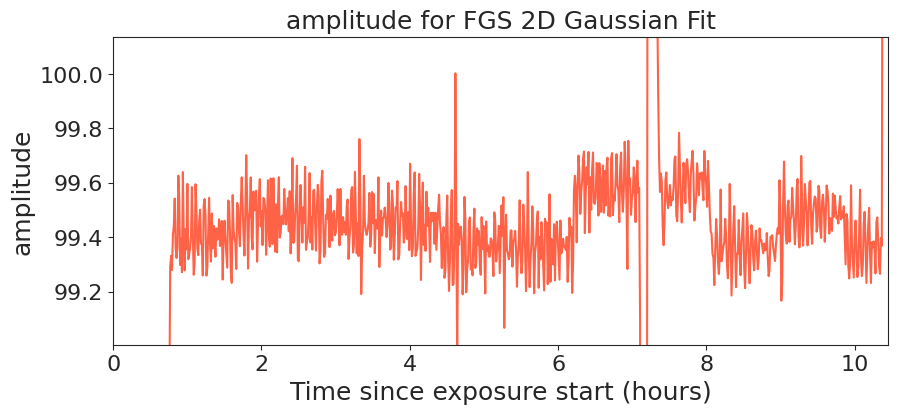

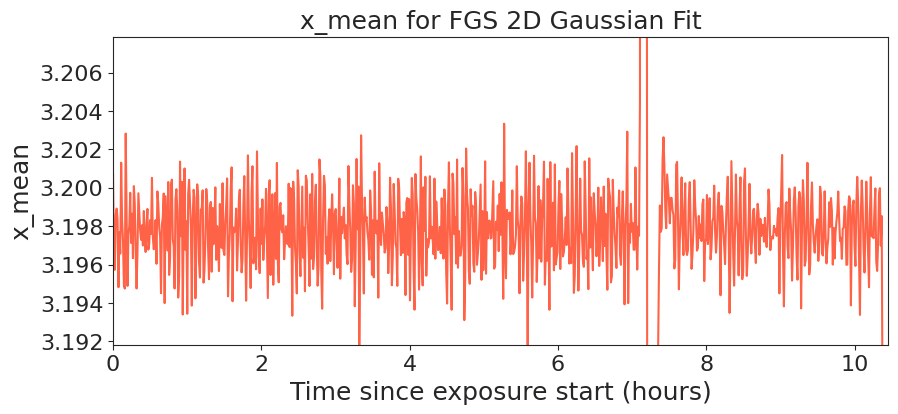

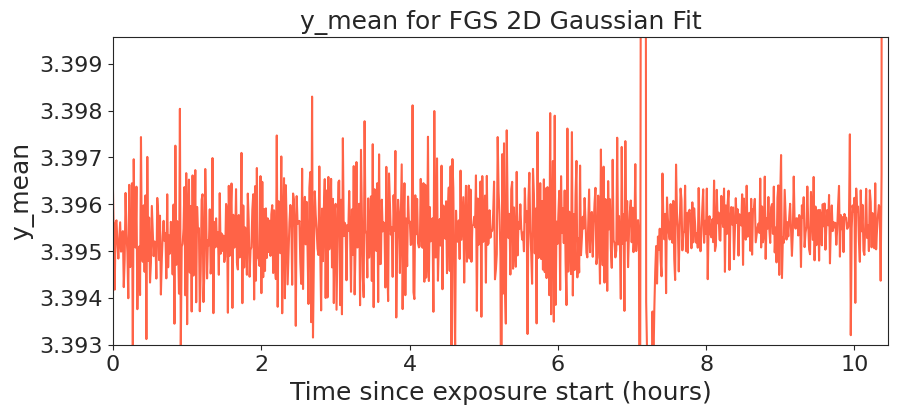

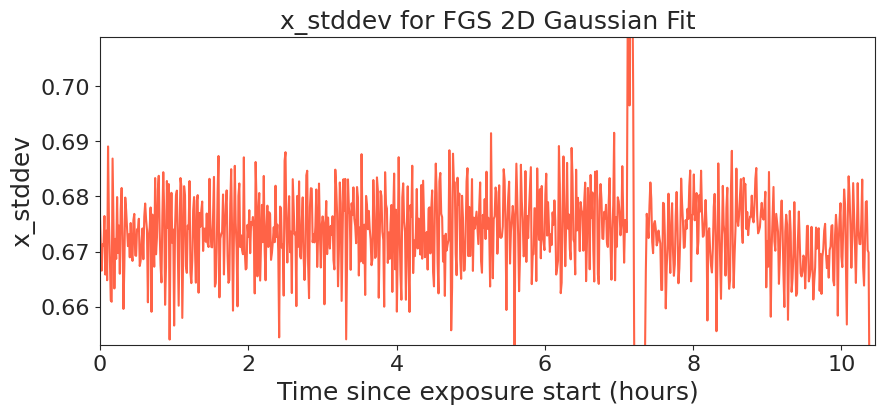

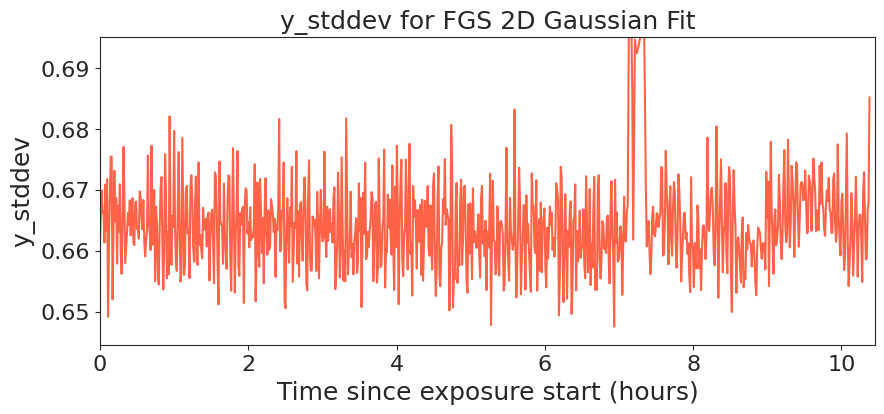

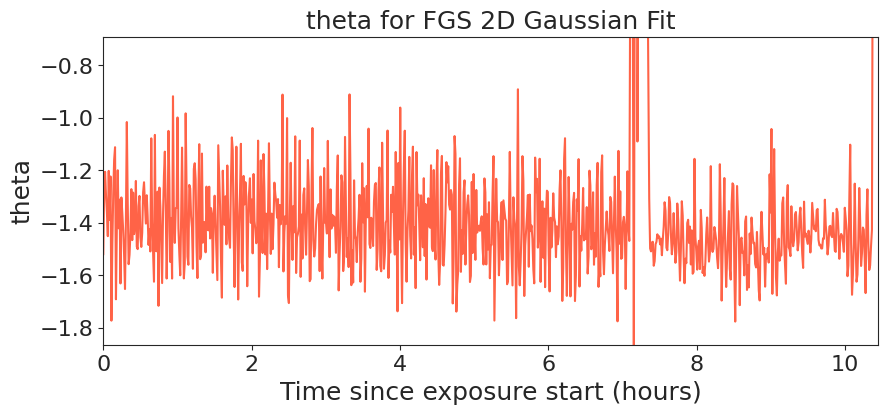

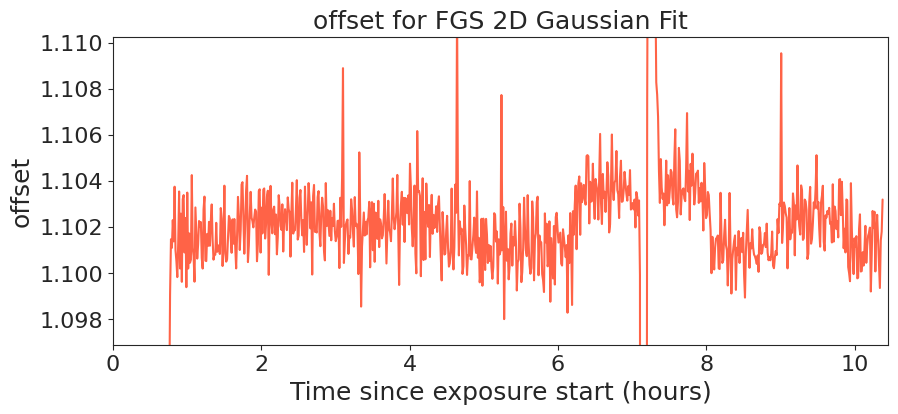

In [271]:
for key in list(fgs_results.keys()):

    plt.figure(figsize=(10,4))

    median = np.nanmedian(fgs_results[key])
    std = np.nanmedian(np.abs(fgs_results[key] - median)) * 1.4826
    plt.plot((t - tstart) * 24., fgs_results[key], color = 'tomato')
    
    plt.title(key+' for FGS 2D Gaussian Fit', fontsize = 18)
    plt.xlabel('Time since exposure start (hours)', fontsize = 18)
    plt.ylabel(key, fontsize = 18)
    
    plt.xticks(fontsize=16)
    plt.yticks(fontsize=16)
    
    plt.xlim(np.min((t - tstart) * 24.), np.max((t - tstart) * 24.))
    plt.ylim(median-3*std,median+5*std)

Any correlations directly from the data from, say, the first 3 hours of data?

In [272]:
idx = np.where( ((t - tstart) * 24. < 3.0)|((t - tstart) * 24. > 9.5) )[0]

In [273]:
def standarize(x):

    median = np.nanmedian(x)
    std = np.nanmedian(np.abs(x - median)) * 1.4826    

    return ( x - median ) / std

(-5.0, 5.0)

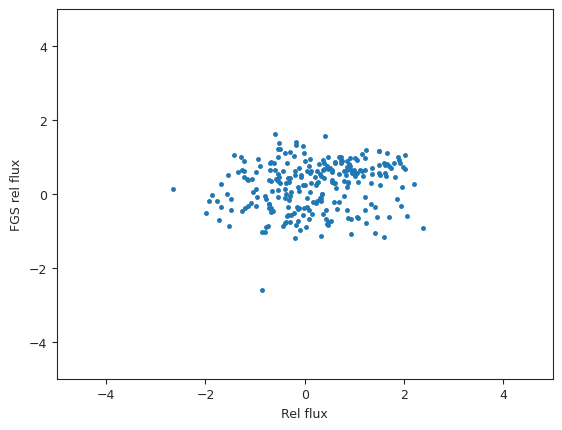

In [274]:
xx = theflux[idx]
yy = binned_fgsphot[idx]

plt.plot(standarize(xx), standarize(yy), '.')
plt.xlabel('Rel flux')
plt.ylabel('FGS rel flux')
plt.ylim(-5,5)
plt.xlim(-5,5)

(-5.0, 5.0)

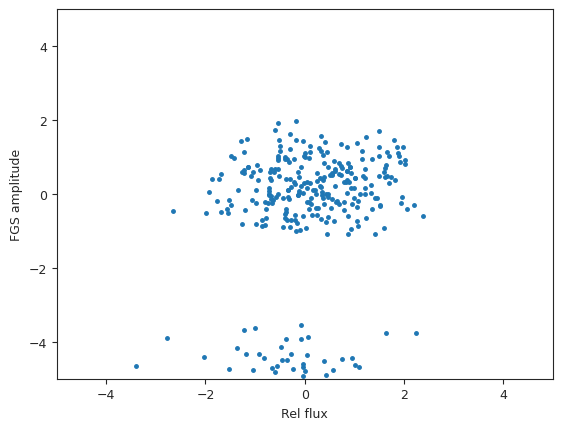

In [275]:
xx = theflux[idx]
yy = fgs_results['amplitude'][idx]

plt.plot(standarize(xx), standarize(yy), '.')
plt.xlabel('Rel flux')
plt.ylabel('FGS amplitude')
plt.ylim(-5,5)
plt.xlim(-5,5)

(-5.0, 5.0)

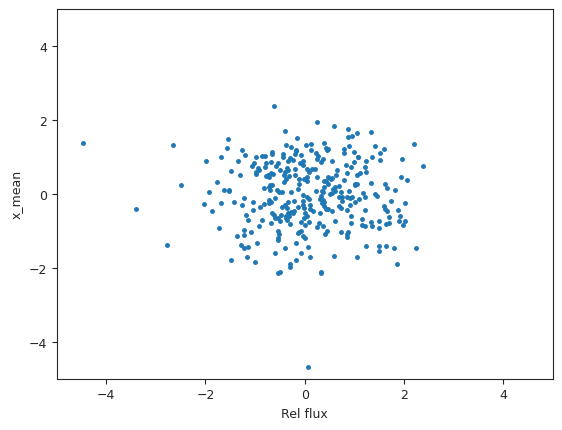

In [276]:
xx = theflux[idx]
yy = fgs_results['x_mean'][idx]

plt.plot(standarize(xx), standarize(yy), '.')
plt.xlabel('Rel flux')
plt.ylabel('x_mean')
plt.ylim(-5,5)
plt.xlim(-5,5)

(-5.0, 5.0)

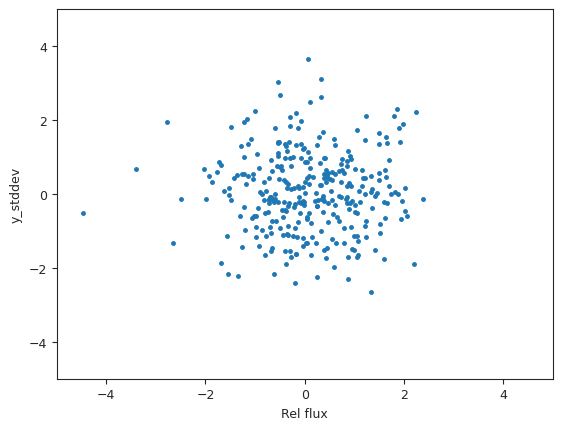

In [277]:
xx = theflux[idx]
yy = fgs_results['y_stddev'][idx]

plt.plot(standarize(xx), standarize(yy), '.')
plt.xlabel('Rel flux')
plt.ylabel('y_stddev')
plt.ylim(-5,5)
plt.xlim(-5,5)

(-5.0, 5.0)

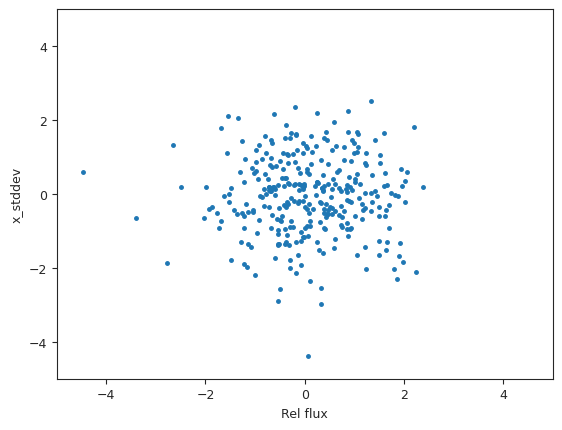

In [278]:
xx = theflux[idx]
yy = fgs_results['x_stddev'][idx]

plt.plot(standarize(xx), standarize(yy), '.')
plt.xlabel('Rel flux')
plt.ylabel('x_stddev')
plt.ylim(-5,5)
plt.xlim(-5,5)

(-5.0, 5.0)

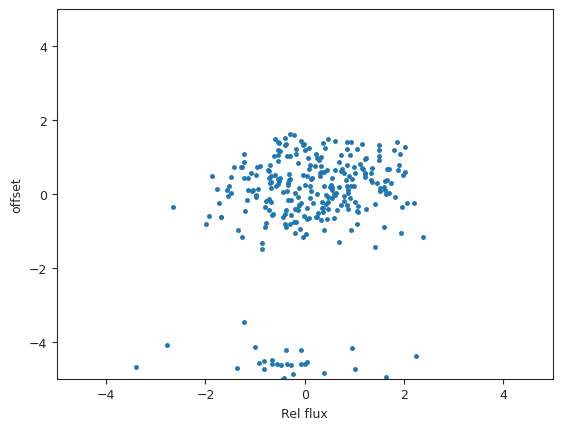

In [279]:
xx = theflux[idx]
yy = fgs_results['offset'][idx]

plt.plot(standarize(xx), standarize(yy), '.')
plt.xlabel('Rel flux')
plt.ylabel('offset')
plt.ylim(-5,5)
plt.xlim(-5,5)

(-5.0, 5.0)

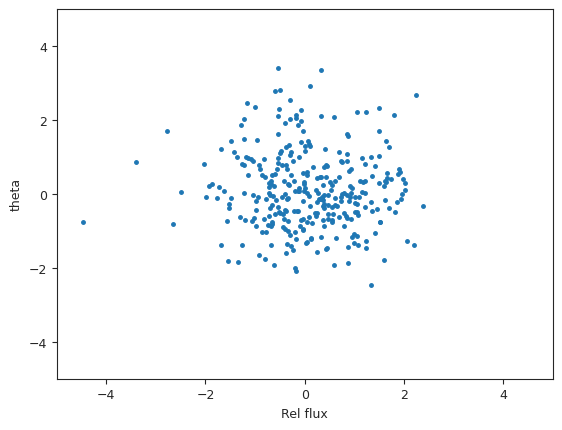

In [280]:
xx = theflux[idx]
yy = fgs_results['theta'][idx]

plt.plot(standarize(xx), standarize(yy), '.')
plt.xlabel('Rel flux')
plt.ylabel('theta')
plt.ylim(-5,5)
plt.xlim(-5,5)

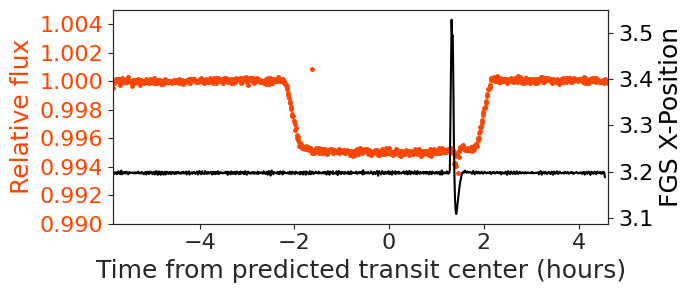

In [310]:
plt.figure(figsize=(7,3))


order = 'order1'
theflux = lcs_scaled[order+' white light']['flux']

plt.plot(times_hours, theflux / np.nanmedian(theflux[:100]), '.', color = 'orangered')

plt.ylabel('Relative flux', fontsize = 18, color = 'orangered')
plt.xlabel('Time from predicted transit center (hours)', fontsize = 18)
plt.xticks(fontsize=16)

plt.yticks(fontsize=16, color = 'orangered')
plt.ylim(0.99,1.005)

plt.twinx()

plt.plot(times_hours, fgs_results['x_mean'], color = 'black')

plt.ylabel('FGS X-Position', fontsize = 18, color = 'black')

plt.xticks(fontsize=16)
plt.yticks(fontsize=16, color = 'black')
plt.xlim(np.min(times_hours), np.max(times_hours))

plt.tight_layout()
#plt.xlim(6,8)

In [313]:
t

array([2460375.48459588, 2460375.48510459, 2460375.4856133 ,
       2460375.486122  , 2460375.48663071, 2460375.48713942,
       2460375.48764813, 2460375.48815684, 2460375.48866554,
       2460375.48917425, 2460375.48968296, 2460375.49019167,
       2460375.49070037, 2460375.49120908, 2460375.49171779,
       2460375.4922265 , 2460375.49273521, 2460375.49324391,
       2460375.49375262, 2460375.49426133, 2460375.49477004,
       2460375.49527874, 2460375.49578745, 2460375.49629616,
       2460375.49680487, 2460375.49731358, 2460375.49782228,
       2460375.49833099, 2460375.4988397 , 2460375.49934841,
       2460375.49985712, 2460375.50036582, 2460375.50087453,
       2460375.50138324, 2460375.50189195, 2460375.50240065,
       2460375.50290936, 2460375.50341807, 2460375.50392678,
       2460375.50443549, 2460375.50494419, 2460375.5054529 ,
       2460375.50596161, 2460375.50647032, 2460375.50697903,
       2460375.50748773, 2460375.50799644, 2460375.50850515,
       2460375.50901386,

In [314]:
fgs_results[key]

array([1.09252975, 1.09260919, 1.09452073, 1.09297368, 1.09227633,
       1.09312839, 1.0927904 , 1.09461412, 1.0945553 , 1.09115324,
       1.09368327, 1.09313438, 1.09475837, 1.09579837, 1.09010189,
       1.09169506, 1.09330714, 1.09307553, 1.09389398, 1.09300011,
       1.09348874, 1.09224076, 1.09389618, 1.0923431 , 1.0914336 ,
       1.09391884, 1.09424756, 1.09402056, 1.09137623, 1.09231551,
       1.09257988, 1.09405894, 1.0924994 , 1.09379505, 1.09238818,
       1.09281597, 1.09385887, 1.09141686, 1.09292316, 1.09410627,
       1.09318341, 1.09389443, 1.09265263, 1.09184289, 1.09196957,
       1.0938464 , 1.09274217, 1.09295047, 1.0939687 , 1.09138709,
       1.0927282 , 1.09317137, 1.0924743 , 1.09391254, 1.09306809,
       1.09328347, 1.0914754 , 1.09468282, 1.09199936, 1.09370529,
       1.09347073, 1.09151733, 1.09372703, 1.09906232, 1.10146089,
       1.1010874 , 1.10229142, 1.10136936, 1.10374254, 1.10099021,
       1.10051008, 1.09981728, 1.10129589, 1.10353441, 1.10019

In [319]:
fout = open('fgs_data.txt','w')

string_out = '# Time (BJD_TDB) \t'
for key in list(fgs_results.keys()):

    string_out += '{0:} \t'.format(key)

fout.write(string_out+'\n')

for i in range(len(t)):

    string_out = '{0:.10f} \t'.format(t[i])
    for key in list(fgs_results.keys()):

        string_out += '{0:.10f} \t '.format(fgs_results[key][i])

    fout.write(string_out+'\n')
fout.close()

In [318]:
rm fgs_data.txt

In [311]:
pwd

'/ifs/jwst/wit/witserv/data18/nespinoza/niriss/order3-calibration'

## Fit white-light lightcurves with multi-D Matern 3/2

In [62]:
# Name of the parameters to be fit:
params = ['P_p1', 't0_p1', 'a_p1', 'b_p1', 'q1_SOSS', 'q2_SOSS', 'ecc_p1', 'omega_p1',
          'p_p1', 'mdilution_SOSS', 'mflux_SOSS', 'sigma_w_SOSS', 'GP_sigma_SOSS', \
          'GP_malpha0_SOSS', 'GP_malpha1_SOSS']

# Distributions:
dists = ['fixed', 'normal', 'uniform', 'uniform', 'uniform', 'uniform', 'fixed', 'fixed',
         'uniform', 'fixed', 'normal', 'loguniform', 'loguniform', \
         'exponential', 'exponential']

# Hyperparameters:
hyperps = [period, [transit_center,0.2], [1., 10.], [0.,0.5], [0., 1.], [0.,1.], 0., 90.0,
           [0., 0.2], 1.0, [0., 0.1], [10., 1000.], [10., 1000.], \
           [1.], [1.]]

priors = juliet.generate_priors(params, dists, hyperps)

Set GP regressors:

In [63]:
def standarize_regressors(x):
    
    new_x = (x - np.mean(x)) / np.sqrt(np.var(x))
    
    return new_x

In [64]:
gp_regressors = {}
gp_regressors['SOSS'] = np.zeros([len(t), 2])
gp_regressors['SOSS'][:, 0] = standarize_regressors(t)

In [ ]:
wl_results_scaled = {}
for order in ['order1', 'order2']:
    
    print('Fitting ',order)
    times, fluxes, fluxes_error = {}, {}, {}
    
    times['SOSS'], fluxes['SOSS'], fluxes_error['SOSS'] = wl_scaled[order]['times'], \
                                                          wl_scaled[order]['f'], \
                                                          wl_scaled[order]['ferr']
    
    # GP regressor:
    gp_regressors['SOSS'][:, 1] = standarize_regressors(wl_fwhms[order])
    
    # Perform juliet fits:
    wl_results_scaled[order] = {}
    wl_results_scaled[order]['dataset'] = juliet.load(priors=priors, t_lc=times, y_lc=fluxes, \
                                                      yerr_lc=fluxes_error, GP_regressors_lc = gp_regressors,\
                                                      out_folder=order+'_'+'GP-fwhm-SCALED-white-light-quadratic', \
                                                      ld_laws = 'quadratic', george_hodlr = False)
        
    wl_results_scaled[order]['result'] = wl_results_scaled[order]['dataset'].fit(sampler = 'dynamic_dynesty', dynesty_nthreads = 10)

Fitting  order1


iter: 2999 | batch: 0 | bound: 16 | nc: 31 | ncall: 53969 | eff(%):  5.506 | loglstar:   -inf < 7705.491 <    inf | logz: 7693.729 +/-  0.148 | dlogz: 1558.127 >  0.010                              IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)

iter: 27215 | batch: 0 | bound: 341 | nc: 1 | ncall: 789665 | eff(%):  3.446 | loglstar:   -inf < 9976.876 <    inf | logz: 9928.105 +/-  0.296 | dlogz:  0.000 >  0.010                              

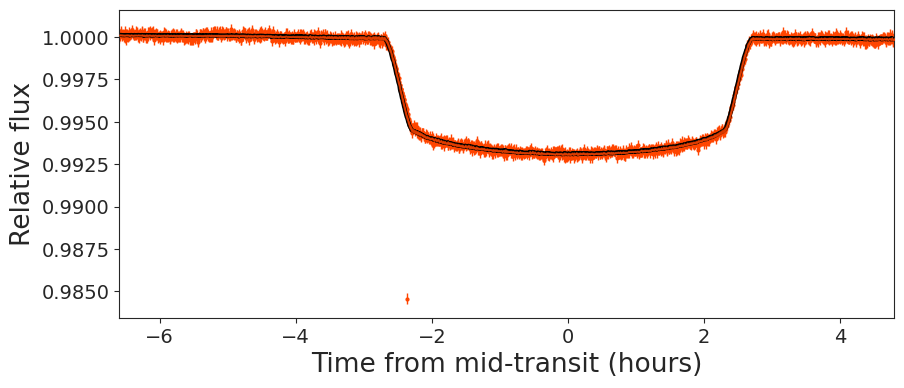

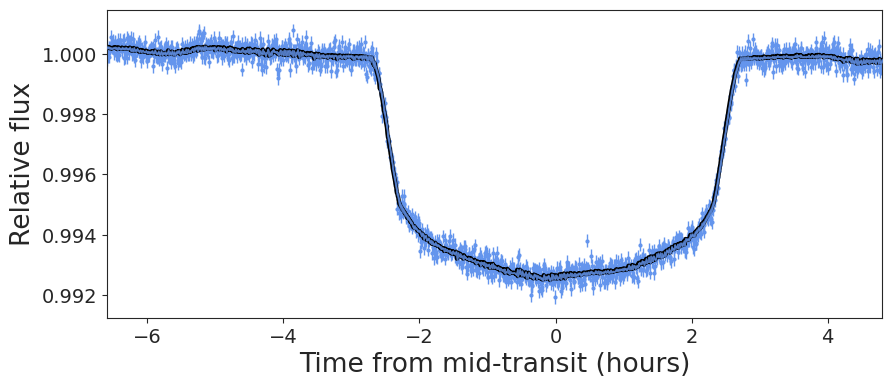

In [68]:
order = 'order1'
transit_center = np.median(wl_results_scaled[order]['result'].posteriors['posterior_samples']['t0_p1'])

for order,color in [('order1','orangered'),('order2','cornflowerblue')]:
    
    plt.figure(figsize=(10,4))
    
    
    normalized_time = (wl_scaled[order]['times'] - transit_center) * 24
    
    sigma_SOSS = np.median(wl_results_scaled[order]['result'].posteriors['posterior_samples']['sigma_w_SOSS']*1e-6)
    
    total_errors = np.sqrt(sigma_SOSS**2 + wl_results_scaled[order]['dataset'].errors_lc['SOSS']**2)
    
    plt.errorbar(normalized_time, \
                 wl_results_scaled[order]['dataset'].data_lc['SOSS'], \
                 yerr = total_errors, \
                 fmt = '.', color = color, ms = 4, elinewidth = 1, zorder = 1)
    
    # Evaluate model:
    transit_model, transit_up68, transit_low68  = \
                   wl_results_scaled[order]['result'].lc.evaluate('SOSS', return_err=True)
    
    transit_model, transit_up99, transit_low99  = \
                   wl_results_scaled[order]['result'].lc.evaluate('SOSS', return_err=True, alpha = 0.99)
        
    plt.plot(normalized_time, transit_model, color = 'black', lw=3, zorder=2)
        
    plt.fill_between(normalized_time, transit_up68, transit_low68, \
                     color=color,alpha=0.5, zorder=3)
    
    plt.fill_between(normalized_time, transit_up99, transit_low99, \
                     color=color,alpha=0.5, zorder=3)
    
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.xlim(np.min(normalized_time), np.max(normalized_time))
    plt.xlabel('Time from mid-transit (hours)', fontsize = 19)
    plt.ylabel('Relative flux', fontsize = 19)

In [66]:
wl_results_scaled.keys()

dict_keys(['order1', 'order2', 'order3'])

In [ ]:
wl_results_empirical = {}
for order in ['order1', 'order2']:
    
    print('Fitting ',order)
    times, fluxes, fluxes_error = {}, {}, {}
    
    times['SOSS'], fluxes['SOSS'], fluxes_error['SOSS'] = wl_empirical[order]['times'], \
                                                          wl_empirical[order]['f'], \
                                                          wl_empirical[order]['ferr']
    
    # GP regressor:
    gp_regressors['SOSS'][:, 1] = standarize_regressors(wl_fwhms[order])
    
    # Perform juliet fits:
    wl_results_empirical[order] = {}
    wl_results_empirical[order]['dataset'] = juliet.load(priors=priors, t_lc=times, y_lc=fluxes, \
                                                      yerr_lc=fluxes_error, GP_regressors_lc = gp_regressors,\
                                                      out_folder=order+'_'+'GP-fwhm-EMPIRICAL-white-light-quadratic', \
                                                      ld_laws = 'quadratic', george_hodlr = False)
  
    wl_results_empirical[order]['result'] = wl_results_empirical[order]['dataset'].fit(sampler = 'dynamic_dynesty', dynesty_nthreads = 10)

In [ ]:
transit_center = np.median(wl_results_empirical[order]['result'].posteriors['posterior_samples']['t0_p1'])

for order,color in [('order1','orangered'),('order2','cornflowerblue'),('order3','forestgreen')]:
    
    plt.figure(figsize=(10,4))
    
    
    normalized_time = (wl_empirical[order]['times'] - transit_center) * 24
    
    sigma_SOSS = np.median(wl_results_empirical[order]['result'].posteriors['posterior_samples']['sigma_w_SOSS']*1e-6)
    
    total_errors = np.sqrt(sigma_SOSS**2 + wl_results_empirical[order]['dataset'].errors_lc['SOSS']**2)
    
    plt.errorbar(normalized_time, \
                 wl_results_empirical[order]['dataset'].data_lc['SOSS'], \
                 yerr = total_errors, \
                 fmt = '.', color = color, ms = 4, elinewidth = 1, zorder = 1)
    
    # Evaluate model:
    transit_model, transit_up68, transit_low68  = \
                   wl_results_empirical[order]['result'].lc.evaluate('SOSS', return_err=True)
    
    transit_model, transit_up99, transit_low99  = \
                   wl_results_empirical[order]['result'].lc.evaluate('SOSS', return_err=True, alpha = 0.99)
        
    plt.plot(normalized_time, transit_model, color = 'black', lw=3, zorder=2)
        
    plt.fill_between(normalized_time, transit_up68, transit_low68, \
                     color=color,alpha=0.5, zorder=3)
    
    plt.fill_between(normalized_time, transit_up99, transit_low99, \
                     color=color,alpha=0.5, zorder=3)
    
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.xlim(np.min(normalized_time), np.max(normalized_time))
    plt.xlabel('Time from mid-transit (hours)', fontsize = 19)
    plt.ylabel('Relative flux', fontsize = 19)

## Run transmission spectra for both scaled and empirical

First, scaled transmission spectrum. We use `ray` to paralellize processes:

In [110]:
ncores = 30
ray.init(num_cpus = ncores)

2024-02-21 00:51:08,681	INFO worker.py:1724 -- Started a local Ray instance.


Python version:,3.10.13
Ray version:,2.9.2


Find best-fit parameters for the transit:

In [72]:
posteriors_order1_wl = pickle.load(open('order1_GP-fwhm-SCALED-white-light-quadratic/_dynesty_DNS_posteriors.pkl','rb'))
posteriors_order2_wl = pickle.load(open('order2_GP-fwhm-SCALED-white-light-quadratic/_dynesty_DNS_posteriors.pkl','rb'))

In [73]:
for param in ['t0_p1', 'a_p1', 'b_p1']:

    p1 = posteriors_order1_wl['posterior_samples'][param]
    p2 = posteriors_order1_wl['posterior_samples'][param]

    nmax = np.min([len(p1), len(p2)])

    average = (p1[-nmax:] + p2[-nmax:]) * 0.5

    print(param,':',np.mean(average), np.sqrt(np.var(average)))

t0_p1 : 2460216.5512428246 0.0001033591923538796
a_p1 : 6.693999408729068 0.025458756661839103
b_p1 : 0.06015775324846204 0.04396210665078321


In [75]:
t0 = 2460216.5512428246
aR = 6.693999408729068
b = 0.06015775324846204

Set priors for the transmission spectral fits; same for order 1 and 2:

In [109]:
output_f = '/astro/planet/nespinoza/wasp-63b/scaled/'
instrument_name = 'order1'

# Name of the parameters to be fit:
params = ['P_p1', 't0_p1', 'a_p1', 'b_p1', 'q1_'+instrument_name, 'q2_'+instrument_name, 'ecc_p1', 'omega_p1',
          'p_p1', 'mdilution_'+instrument_name, 'mflux_'+instrument_name, 'sigma_w_'+instrument_name, 'GP_sigma_'+instrument_name, \
          'GP_rho_'+instrument_name]

# Distributions:
dists = ['fixed', 'fixed', 'fixed', 'fixed', 'uniform', 'uniform', 'fixed', 'fixed',
         'uniform', 'fixed', 'normal', 'loguniform', 'loguniform', \
         'loguniform']

# Hyperparameters:
hyperps = [period, t0, aR, b, [0., 1.], [0.,1.], 0., 90.0,
           [0., 0.2], 1.0, [0., 0.1], [10., 30000.], [10., 1000.], \
           [1e-2, 1e3]]

priors = juliet.generate_priors(params, dists, hyperps)

In [77]:
def remove_outliers(t, f, ferr, window = 15, nsigma = 5):

    # Get median filter:
    mf = median_filter(f, window)
    res = (f - mf)

    # Identify outliers:
    sigma = get_mad_sigma(res)
    idx = np.where(np.abs(res) < nsigma * sigma)[0]

    # Return corrected data:
    return t[idx], f[idx], ferr[idx]

def get_mad_sigma(x):

    return 1.4826 * np.median(np.abs(x - np.nanmedian(x)))

In [104]:
@ray.remote
def fit_data(time_dict, flux_dict, error_dict, prior_dict, output_folder, gp_regressor):

    dataset = juliet.load(priors = prior_dict, 
                          t_lc = time_dict, y_lc = flux_dict, yerr_lc = error_dict, 
                          out_folder = output_folder, 
                          GP_regressors_lc = gp_regressor)

    try:
        
        dataset.fit(sampler = 'dynamic_dynesty')

    except:

        print('FIT FAILED FOR '+output_folder)

In [111]:
all_fits = []
all_w_bins = list(lcs_scaled[instrument_name].keys())
all_w_results = {}

for i in range(len(all_w_bins)):

    # First, correct lightcurve for outliers:
    t, f, ferr = remove_outliers(wl_scaled[instrument_name]['times'], 
                                 lcs_scaled[instrument_name][all_w_bins[i]]['flux'], 
                                 lcs_scaled[instrument_name][all_w_bins[i]]['errors'],
                                 window = 15, nsigma = 5)

    # Normalize it:
    normalization = np.median(f[:100])
    f = f / normalization
    ferr = ferr / normalization

    if not np.isnan(np.sum(f)):

        # Generate a set of dictionaries to store data into:
        td, fd, ferrd, gpreg = {}, {}, {}, {}
        td[instrument_name] = t
        fd[instrument_name] = f
        ferrd[instrument_name] = ferr
        gpreg[instrument_name] = ( t - np.mean(t) ) / np.sqrt( np.var(t) )
    
        # Extract wavelength, set output folder name:
        wavelength = all_w_bins[i]
        wbin = 'w_{0:.5f}'.format(wavelength)
        output_folder = output_f + instrument_name + '/' + wbin
    
        # Attach the fit to ray-remotes:
        all_fits.append( fit_data.remote(td, fd, ferrd, priors, output_folder, gpreg) )

    else:

        all_w_bins.pop(i)

(pid=201896) Warning: no zeus installation found. Will not be able to sample using sampler = 'zeus'.


iter: 148 | batch: 0 | bound: 0 | nc: 1 | ncall: 148 | eff(%): 29.600 | loglstar:   -inf <  0.000 <    inf | logz: -1.223 +/-  0.042 | dlogz:  1.222 >  0.010                                         
iter: 149 | batch: 0 | bound: 0 | nc: 1 | ncall: 149 | eff(%): 29.800 | loglstar:   -inf <  0.000 <    inf | logz: -1.216 +/-  0.042 | dlogz:  1.215 >  0.010                                         
iter: 172 | batch: 0 | bound: 0 | nc: 1 | ncall: 172 | eff(%): 34.400 | loglstar:   -inf <  0.000 <    inf | logz: -1.072 +/-  0.036 | dlogz:  1.071 >  0.010                                         
iter: 191 | batch: 0 | bound: 0 | nc: 1 | ncall: 191 | eff(%): 38.200 | loglstar:   -inf <  0.000 <    inf | logz: -0.967 +/-  0.031 | dlogz:  0.966 >  0.010                                         
iter: 204 | batch: 0 | bound: 0 | nc: 1 | ncall: 204 | eff(%): 40.800 | loglstar:   -inf <  0.000 <    inf | logz: -0.901 +/-  0.028 | dlogz:  0.900 >  0.010                                         
iter:

In [112]:
# Actually run the thing:
ray_results = ray.get(all_fits)

iter: 4709 | batch: 0 | bound: 39 | nc: 27 | ncall: 95651 | eff(%):  4.898 | loglstar:   -inf < 6896.503 <    inf | logz: 6885.847 +/-  0.138 | dlogz: 13.285 >  0.010                                 [repeated 2436x across cluster]
iter: 5855 | batch: 0 | bound: 55 | nc: 27 | ncall: 127144 | eff(%):  4.587 | loglstar:   -inf < 6915.460 <    inf | logz: 6903.468 +/-  0.146 | dlogz:  6.870 >  0.010                                [repeated 26x across cluster]
iter: 4745 | batch: 0 | bound: 41 | nc: 27 | ncall: 98239 | eff(%):  4.806 | loglstar:   -inf < 6953.642 <    inf | logz: 6943.080 +/-  0.138 | dlogz: 11.317 >  0.010                                 [repeated 170x across cluster]
iter: 4760 | batch: 0 | bound: 40 | nc: 27 | ncall: 97367 | eff(%):  4.864 | loglstar:   -inf < 6805.666 <    inf | logz: 6794.964 +/-  0.138 | dlogz: 12.113 >  0.010                                 [repeated 157x across cluster]
iter: 5765 | batch: 0 | bound: 55 | nc: 27 | ncall: 126433 | eff(%):  4.542 | lo

In [ ]:
# Change prior:
output_f = '/astro/planet/nespinoza/wasp-63b/scaled/'
instrument_name = 'order2'

# Name of the parameters to be fit:
params = ['P_p1', 't0_p1', 'a_p1', 'b_p1', 'q1_'+instrument_name, 'q2_'+instrument_name, 'ecc_p1', 'omega_p1',
          'p_p1', 'mdilution_'+instrument_name, 'mflux_'+instrument_name, 'sigma_w_'+instrument_name, 'GP_sigma_'+instrument_name, \
          'GP_rho_'+instrument_name]

# Distributions:
dists = ['fixed', 'fixed', 'fixed', 'fixed', 'uniform', 'uniform', 'fixed', 'fixed',
         'uniform', 'fixed', 'normal', 'loguniform', 'loguniform', \
         'loguniform']

# Hyperparameters:
hyperps = [period, t0, aR, b, [0., 1.], [0.,1.], 0., 90.0,
           [0., 0.2], 1.0, [0., 0.1], [10., 30000.], [10., 1000.], \
           [1e-2, 1e3]]

priors = juliet.generate_priors(params, dists, hyperps)

In [ ]:
all_fits = []
all_w_bins = list(lcs_scaled[instrument_name].keys())
all_w_results = {}

for i in range(len(all_w_bins)):

    # First, correct lightcurve for outliers:
    t, f, ferr = remove_outliers(wl_scaled[instrument_name]['times'], 
                                 lcs_scaled[instrument_name][all_w_bins[i]]['flux'], 
                                 lcs_scaled[instrument_name][all_w_bins[i]]['errors'],
                                 window = 15, nsigma = 5)

    # Normalize it:
    normalization = np.median(f[:100])
    f = f / normalization
    ferr = ferr / normalization

    if not np.isnan(np.sum(f)):

        # Generate a set of dictionaries to store data into:
        td, fd, ferrd, gpreg = {}, {}, {}, {}
        td[instrument_name] = t
        fd[instrument_name] = f
        ferrd[instrument_name] = ferr
        gpreg[instrument_name] = ( t - np.mean(t) ) / np.sqrt( np.var(t) )
    
        # Extract wavelength, set output folder name:
        wavelength = all_w_bins[i]
        wbin = 'w_{0:.5f}'.format(wavelength)
        output_folder = output_f + instrument_name + '/' + wbin
    
        # Attach the fit to ray-remotes:
        all_fits.append( fit_data.remote(td, fd, ferrd, priors, output_folder, gpreg) )

    else:

        all_w_bins.pop(i)

In [113]:
# Actually run the thing:
ray_results = ray.get(all_fits)

In [114]:
print('Done')

Done


In [115]:
ray.is_initialized()

True

Finally, do empirical bkg transpec:

In [116]:
output_f = '/astro/planet/nespinoza/wasp-63b/empirical/'

In [ ]:
all_fits = []
all_w_bins = list(lcs_empirical[instrument_name].keys())
all_w_results = {}

for i in range(len(all_w_bins)):

    # First, correct lightcurve for outliers:
    t, f, ferr = remove_outliers(wl_empirical[instrument_name]['times'], 
                                 lcs_empirical[instrument_name][all_w_bins[i]]['flux'], 
                                 lcs_empirical[instrument_name][all_w_bins[i]]['errors'],
                                 window = 15, nsigma = 5)

    # Normalize it:
    normalization = np.median(f[:100])
    f = f / normalization
    ferr = ferr / normalization

    if not np.isnan(np.sum(f)):

        # Generate a set of dictionaries to store data into:
        td, fd, ferrd, gpreg = {}, {}, {}, {}
        td[instrument_name] = t
        fd[instrument_name] = f
        ferrd[instrument_name] = ferr
        gpreg[instrument_name] = ( t - np.mean(t) ) / np.sqrt( np.var(t) )
    
        # Extract wavelength, set output folder name:
        wavelength = all_w_bins[i]
        wbin = 'w_{0:.5f}'.format(wavelength)
        output_folder = output_f + instrument_name + '/' + wbin
    
        # Attach the fit to ray-remotes:
        all_fits.append( fit_data.remote(td, fd, ferrd, priors, output_folder, gpreg) )

    else:

        all_w_bins.pop(i)

In [ ]:
# Actually run the thing:
ray_results = ray.get(all_fits)

In [ ]:
Try simple linear trend:

In [121]:
output_f = '/astro/planet/nespinoza/wasp-63b/empirical/'
instrument_name = 'order1'

# Name of the parameters to be fit:
params = ['P_p1', 't0_p1', 'a_p1', 'b_p1', 'q1_'+instrument_name, 'q2_'+instrument_name, 'ecc_p1', 'omega_p1',
          'p_p1', 'mdilution_'+instrument_name, 'mflux_'+instrument_name, 'sigma_w_'+instrument_name, 
          'theta0_'+instrument_name]

# Distributions:
dists = ['fixed', 'fixed', 'fixed', 'fixed', 'uniform', 'uniform', 'fixed', 'fixed',
         'uniform', 'fixed', 'normal', 'loguniform', 
         'uniform']

# Hyperparameters:
hyperps = [period, t0, aR, b, [0., 1.], [0.,1.], 0., 90.0,
           [0., 0.2], 1.0, [0., 0.1], [10., 30000.], 
           [-10.,10.]]

priors = juliet.generate_priors(params, dists, hyperps)

In [122]:
@ray.remote
def fit_data2(time_dict, flux_dict, error_dict, prior_dict, output_folder, l_regressor):

    dataset = juliet.load(priors = prior_dict, 
                          t_lc = time_dict, y_lc = flux_dict, yerr_lc = error_dict, 
                          out_folder = output_folder, 
                          linear_regressors_lc = l_regressor)

    try:
        
        dataset.fit(sampler = 'dynamic_dynesty')

    except:

        print('FIT FAILED FOR '+output_folder)

In [123]:
all_fits = []
all_w_bins = list(lcs_empirical[instrument_name].keys())
all_w_results = {}

for i in range(len(all_w_bins)):

    # First, correct lightcurve for outliers:
    t, f, ferr = remove_outliers(wl_empirical[instrument_name]['times'], 
                                 lcs_empirical[instrument_name][all_w_bins[i]]['flux'], 
                                 lcs_empirical[instrument_name][all_w_bins[i]]['errors'],
                                 window = 15, nsigma = 5)

    # Normalize it:
    normalization = np.median(f[:100])
    f = f / normalization
    ferr = ferr / normalization

    if not np.isnan(np.sum(f)):

        # Generate a set of dictionaries to store data into:
        td, fd, ferrd, gpreg = {}, {}, {}, {}
        td[instrument_name] = t
        fd[instrument_name] = f
        ferrd[instrument_name] = ferr
        gpreg[instrument_name] = np.zeros([len(t), 1])
        gpreg[instrument_name][:, 0] = ( t - np.mean(t) ) / np.sqrt( np.var(t) )
    
        # Extract wavelength, set output folder name:
        wavelength = all_w_bins[i]
        wbin = 'w_{0:.5f}'.format(wavelength)
        output_folder = output_f + instrument_name + '/' + wbin
    
        # Attach the fit to ray-remotes:
        all_fits.append( fit_data2.remote(td, fd, ferrd, priors, output_folder, gpreg) )

    else:

        all_w_bins.pop(i)

iter: 119 | batch: 0 | bound: 0 | nc: 1 | ncall: 119 | eff(%): 23.800 | loglstar:   -inf <  0.000 <    inf | logz: -1.442 +/-  0.048 | dlogz:  1.441 >  0.010                                         
iter: 120 | batch: 0 | bound: 0 | nc: 1 | ncall: 120 | eff(%): 24.000 | loglstar:   -inf <  0.000 <    inf | logz: -1.433 +/-  0.048 | dlogz:  1.432 >  0.010                                         
iter: 149 | batch: 0 | bound: 0 | nc: 1 | ncall: 149 | eff(%): 29.800 | loglstar:   -inf <  0.000 <    inf | logz: -1.216 +/-  0.042 | dlogz:  1.215 >  0.010                                         
iter: 150 | batch: 0 | bound: 0 | nc: 1 | ncall: 150 | eff(%): 30.000 | loglstar:   -inf <  0.000 <    inf | logz: -1.209 +/-  0.041 | dlogz:  1.208 >  0.010                                         
iter: 179 | batch: 0 | bound: 0 | nc: 1 | ncall: 179 | eff(%): 35.800 | loglstar:   -inf <  0.000 <    inf | logz: -1.032 +/-  0.034 | dlogz:  1.031 >  0.010                                         
iter:

In [ ]:
# Actually run the thing:
ray_results = ray.get(all_fits)

iter: 1183 | batch: 0 | bound: 0 | nc: 3 | ncall: 4674 | eff(%): 22.864 | loglstar:   -inf <   -inf <    inf | logz:   -inf +/-  0.136 | dlogz:    inf >  0.010                                       
iter: 8000 | batch: 16 | bound: 0 | nc: 1 | ncall: 8000 | eff(%): 100.000 | loglstar:   -inf <  0.000 <    inf | logz: -0.000 +/-  0.000 | stop:  1.250                                               
iter: 8000 | batch: 16 | bound: 0 | nc: 1 | ncall: 8000 | eff(%): 100.000 | loglstar:   -inf <  0.000 <    inf | logz: -0.000 +/-  0.000 | stop:  1.250                                               
iter: 8000 | batch: 16 | bound: 0 | nc: 1 | ncall: 8000 | eff(%): 100.000 | loglstar:   -inf <  0.000 <    inf | logz: -0.000 +/-  0.000 | stop:  1.250                                               
iter: 8000 | batch: 16 | bound: 0 | nc: 1 | ncall: 8000 | eff(%): 100.000 | loglstar:   -inf <  0.000 <    inf | logz: -0.000 +/-  0.000 | stop:  1.250                                               
iter:

Fit scaled now, same:

In [125]:
output_f = '/astro/planet/nespinoza/wasp-63b/scaled/'
instrument_name = 'order1'

# Name of the parameters to be fit:
params = ['P_p1', 't0_p1', 'a_p1', 'b_p1', 'q1_'+instrument_name, 'q2_'+instrument_name, 'ecc_p1', 'omega_p1',
          'p_p1', 'mdilution_'+instrument_name, 'mflux_'+instrument_name, 'sigma_w_'+instrument_name, 
          'theta0_'+instrument_name]

# Distributions:
dists = ['fixed', 'fixed', 'fixed', 'fixed', 'uniform', 'uniform', 'fixed', 'fixed',
         'uniform', 'fixed', 'normal', 'loguniform', 
         'uniform']

# Hyperparameters:
hyperps = [period, t0, aR, b, [0., 1.], [0.,1.], 0., 90.0,
           [0., 0.2], 1.0, [0., 0.1], [10., 30000.], 
           [-10.,10.]]

priors = juliet.generate_priors(params, dists, hyperps)

In [126]:
all_fits = []
all_w_bins = list(lcs_scaled[instrument_name].keys())
all_w_results = {}

for i in range(len(all_w_bins)):

    # First, correct lightcurve for outliers:
    t, f, ferr = remove_outliers(wl_scaled[instrument_name]['times'], 
                                 lcs_scaled[instrument_name][all_w_bins[i]]['flux'], 
                                 lcs_scaled[instrument_name][all_w_bins[i]]['errors'],
                                 window = 15, nsigma = 5)

    # Normalize it:
    normalization = np.median(f[:100])
    f = f / normalization
    ferr = ferr / normalization

    if not np.isnan(np.sum(f)):

        # Generate a set of dictionaries to store data into:
        td, fd, ferrd, gpreg = {}, {}, {}, {}
        td[instrument_name] = t
        fd[instrument_name] = f
        ferrd[instrument_name] = ferr
        gpreg[instrument_name] = np.zeros([len(t), 1])
        gpreg[instrument_name][:, 0] = ( t - np.mean(t) ) / np.sqrt( np.var(t) )
    
        # Extract wavelength, set output folder name:
        wavelength = all_w_bins[i]
        wbin = 'w_{0:.5f}'.format(wavelength)
        output_folder = output_f + instrument_name + '/' + wbin
    
        # Attach the fit to ray-remotes:
        all_fits.append( fit_data2.remote(td, fd, ferrd, priors, output_folder, gpreg) )

    else:

        all_w_bins.pop(i)

iter: 83 | batch: 0 | bound: 0 | nc: 1 | ncall: 83 | eff(%): 16.600 | loglstar:   -inf <  0.000 <    inf | logz: -1.804 +/-  0.057 | dlogz:  1.803 >  0.010                                           
iter: 84 | batch: 0 | bound: 0 | nc: 1 | ncall: 84 | eff(%): 16.800 | loglstar:   -inf <  0.000 <    inf | logz: -1.792 +/-  0.057 | dlogz:  1.791 >  0.010                                           
iter: 106 | batch: 0 | bound: 0 | nc: 1 | ncall: 106 | eff(%): 21.200 | loglstar:   -inf <  0.000 <    inf | logz: -1.558 +/-  0.051 | dlogz:  1.557 >  0.010                                         
iter: 121 | batch: 0 | bound: 0 | nc: 1 | ncall: 121 | eff(%): 24.200 | loglstar:   -inf <  0.000 <    inf | logz: -1.425 +/-  0.048 | dlogz:  1.424 >  0.010                                         
iter: 139 | batch: 0 | bound: 0 | nc: 1 | ncall: 139 | eff(%): 27.800 | loglstar:   -inf <  0.000 <    inf | logz: -1.286 +/-  0.044 | dlogz:  1.285 >  0.010                                         
iter:

In [127]:
# Actually run the thing:
ray_results = ray.get(all_fits)

iter: 5500 | batch: 11 | bound: 0 | nc: 1 | ncall: 5500 | eff(%): 100.000 | loglstar:   -inf <  0.000 <    inf | logz: -0.000 +/-  0.001 | stop:  1.818                                               
iter: 5500 | batch: 11 | bound: 0 | nc: 1 | ncall: 5500 | eff(%): 100.000 | loglstar:   -inf <  0.000 <    inf | logz: -0.000 +/-  0.001 | stop:  1.818                                               
iter: 5500 | batch: 11 | bound: 0 | nc: 1 | ncall: 5500 | eff(%): 100.000 | loglstar:   -inf <  0.000 <    inf | logz: -0.000 +/-  0.001 | stop:  1.818                                               
iter: 5500 | batch: 11 | bound: 0 | nc: 1 | ncall: 5500 | eff(%): 100.000 | loglstar:   -inf <  0.000 <    inf | logz: -0.000 +/-  0.001 | stop:  1.818                                               
iter: 5500 | batch: 11 | bound: 0 | nc: 1 | ncall: 5500 | eff(%): 100.000 | loglstar:   -inf <  0.000 <    inf | logz: -0.000 +/-  0.001 | stop:  1.818                                               
iter: